# TASmanian Search for Interesting Exoplanets (TASSIE)

Analysis notebook for TASSIE, started by Thomas Plunkett, using data from the Harlingten 50cm telescope.

In [2]:
# First, we import necessary packages
import os
import numpy as np
import pandas as pd
import astropy.units as u
from astropy.coordinates import SkyCoord, CartesianDifferential, Galactocentric
from astropy.io import fits
from astropy.visualization import ZScaleInterval
from astroARIADNE.star import Star
from astroARIADNE.fitter import Fitter
from astroARIADNE.plotter import SEDPlotter
import dustmaps.sfd
import matplotlib.pyplot as plt
import triceratops.triceratops as tr
import lightkurve as lk
from astropy.nddata.utils import Cutout2D
from astropy.wcs import WCS
from scipy.ndimage import rotate
import scipy.interpolate as interpolate
from PyAstronomy import pyasl
import juliet
import seaborn as sns
from uncertainties import ufloat
from uncertainties import unumpy as unp
import matplotlib.gridspec as gridspec

Holoviews not imported. Some visualizations will not be available.
PyMultiNest not imported.  MultiNest fits will not work.
/Users/tp22/anaconda3/envs/transits/lib/python3.10/site-packages/astroARIADNE/fitter.py:43: UserWarning: (py)MultiNest installation (or libmultinest.dylib) not detected.
  warnings.warn(


Configuration file not found:

    /Users/tp22/.dustmapsrc

To create a new configuration file in the default location, run the following python code:

    from dustmaps.config import config
    config.reset()

Note that this will delete your configuration! For example, if you have specified a data directory, then dustmaps will forget about its location.


## ----------------------------------------------------------------------------------
# Target Cutouts & Observing Stats
## ----------------------------------------------------------------------------------

In [2]:
z = ZScaleInterval()

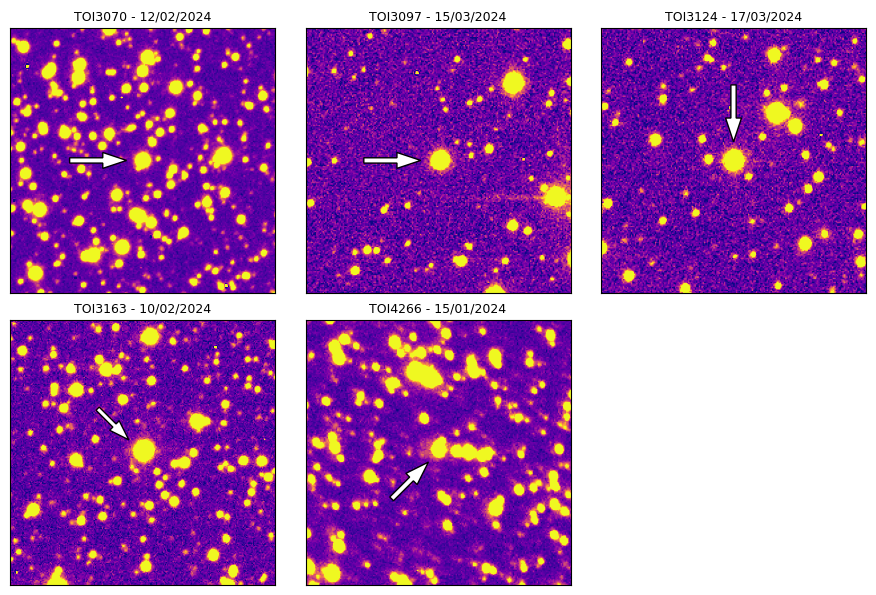

In [48]:
fig, ax = plt.subplots(2,3, figsize = (9,6))
plt.rcParams['axes.titley'] = 1

toi3070_im = fits.getdata('TOI3070/Nightly_Summaries/TOI3070_Stack_12022024.fits')
z1,z2 = z.get_limits(toi3070_im)
ax[0,0].imshow(toi3070_im, vmin=z1+10, vmax=z2, origin = 'lower', cmap = 'plasma')
ax[0,0].set_xlim(1015 - 100, 1015 + 100)
ax[0,0].set_ylim(1148 - 100, 1148 + 100)
ax[0,0].arrow(960, 1148, 25, 0, width = 4, color = 'white', ec = 'black')
ax[0,0].tick_params(left = False, right = False , labelleft = False , labelbottom = False, bottom = False)
ax[0,0].set_title('TOI3070 - 12/02/2024', fontsize = 9)

toi3097_im = fits.getdata('TOI3097/Nightly_Summaries/TOI3097_Stack_15032024.fits')
z1,z2 = z.get_limits(toi3097_im)
ax[0,1].imshow(toi3097_im, vmin=z1+12, vmax=z2, origin = 'lower', cmap = 'plasma')
ax[0,1].set_xlim(1186 - 100, 1186 + 100)
ax[0,1].set_ylim(747 - 100, 747 + 100)
ax[0,1].arrow(1130, 747, 25, 0, width = 4, color = 'white', ec = 'black')
ax[0,1].tick_params(left = False, right = False , labelleft = False , labelbottom = False, bottom = False)
ax[0,1].set_title('TOI3097 - 15/03/2024', fontsize = 9)

toi3124_im = fits.getdata('TOI3124/Nightly_Summaries/TOI3124_Stack_17032024.fits')
z1,z2 = z.get_limits(toi3124_im)
ax[0,2].imshow(toi3124_im, vmin=z1+35, vmax=z2, origin = 'lower', cmap = 'plasma')
ax[0,2].set_xlim(1126 - 100, 1126 + 100)
ax[0,2].set_ylim(788 - 100, 788 + 100)
ax[0,2].arrow(1126, 845, 0, -25, width = 4, color = 'white', ec = 'black')
ax[0,2].tick_params(left = False, right = False , labelleft = False , labelbottom = False, bottom = False)
ax[0,2].set_title('TOI3124 - 17/03/2024', fontsize = 9)

toi3163_im = fits.getdata('TOI3163/Nightly_Summaries/TOI3163_Stack_10022024.fits')
z1,z2 = z.get_limits(toi3163_im)
ax[1,0].imshow(toi3163_im, vmin=z1+10, vmax=z2, origin = 'lower', cmap = 'plasma')
#ax[1,0].set_xlim(995 - 100, 995 + 100)
#ax[1,0].set_ylim(899 - 100, 899 + 100)
ax[1,0].set_xlim(995 - 236/2, 995 + 236/2)
ax[1,0].set_ylim(899 + 236/2, 899 - 236/2)
ax[1,0].arrow(955, 860, 15, 15, width = 4, color = 'white', ec = 'black')
ax[1,0].tick_params(left = False, right = False , labelleft = False , labelbottom = False, bottom = False)
ax[1,0].set_title('TOI3163 - 10/02/2024', fontsize = 9)

toi4266_im = fits.getdata('TOI4266/Nightly_Summaries/TOI4266b_Stack_15012024.fits')
z1,z2 = z.get_limits(toi4266_im)
ax[1,1].imshow(toi4266_im, vmin=z1, vmax=z2, origin = 'lower', cmap = 'plasma')
ax[1,1].set_xlim(1100 - 100, 1100 + 100)
ax[1,1].set_ylim(1150 - 100, 1150 + 100)
ax[1,1].arrow(1065, 1115, 15, 15, width = 4, color = 'white', ec = 'black')
ax[1,1].tick_params(left = False, right = False , labelleft = False , labelbottom = False, bottom = False)
ax[1,1].set_title('TOI4266 - 15/01/2024', fontsize = 9)


fig.delaxes(ax[1, 2])
plt.tight_layout()
#plt.savefig('H50_TOI_Cutouts')

Lets look at some archival images from 2MASS as a means of checking for background eclipsing binaries, along with contaminating stars. We extract sources from our stacked H50 images and then plot them over the 2MASS J band images.

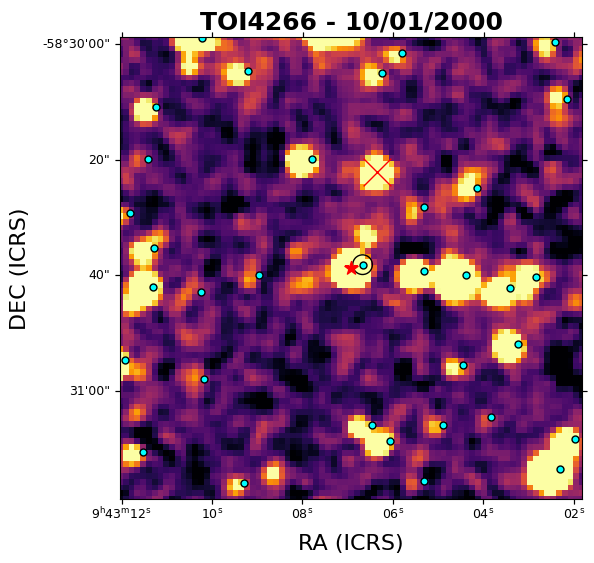

In [9]:
wcs = WCS(fits.getheader('TOI4266/ArchivalIms/aJ_asky_000110s0980209.fits'))
toi4266_df = pd.read_csv('TOI4266/Nightly_Summaries/Phot_Outputs/TOI4266b_Stack_15012024_phot.csv')

sub = np.logical_and(toi4266_df['X_IMAGE'] > 1100 - 5, toi4266_df['X_IMAGE'] < 1100 + 5)
sub2 = np.logical_and(toi4266_df['Y_IMAGE'] > 1150 - 5,toi4266_df['Y_IMAGE'] < 1150 + 5)

toi4266_sub = toi4266_df[sub]
toi4266_sub = toi4266_sub[sub2]

fig = plt.figure(figsize=(9,6))
ax = plt.subplot(projection=wcs) 

z1,z2 = z.get_limits(toi4266_ar[1])

ax.imshow(toi4266_ar[1], vmin=z1 + 1, vmax=z2 - 1, origin = 'lower', cmap = 'inferno')
ax.set_xlim(297 - 40, 297 + 40)
ax.set_ylim(730 - 40, 730 + 40)
ax.set_xlabel('RA (ICRS)', fontsize = 16)
ax.set_ylabel('DEC (ICRS)', fontsize = 16)


ax.scatter(toi4266_sub['RA'], toi4266_sub['DEC'],
           facecolors='none', edgecolors='black', linewidths=1, marker='o', s=200,
           transform=ax.get_transform('icrs'))

ax.scatter(toi4266_df['RA'], toi4266_df['DEC'],
           facecolors='cyan', edgecolors='black', linewidths=1, marker='.', s=100,
           transform=ax.get_transform('icrs'))

coord_2mass = wcs.pixel_to_world(297, 730)
x_2mass, y_2mass = coord_2mass.icrs.ra.value, coord_2mass.icrs.dec.value

persist_coord = wcs.pixel_to_world(301.5, 746.5)
x_per, y_per = persist_coord.icrs.ra.value, persist_coord.icrs.dec.value

ax.scatter(x_2mass, y_2mass, color = 'r', linewidths=1, marker='*', s=100,transform=ax.get_transform('icrs'))
ax.scatter(x_per, y_per, color = 'r', linewidths=1, marker='x', s=400,transform=ax.get_transform('icrs'))

ax.set_title('TOI4266 - 10/01/2000',  fontsize = 18, fontweight = 'bold')

plt.tight_layout()
plt.savefig('TOI4266_2MASSJ_archival.png')

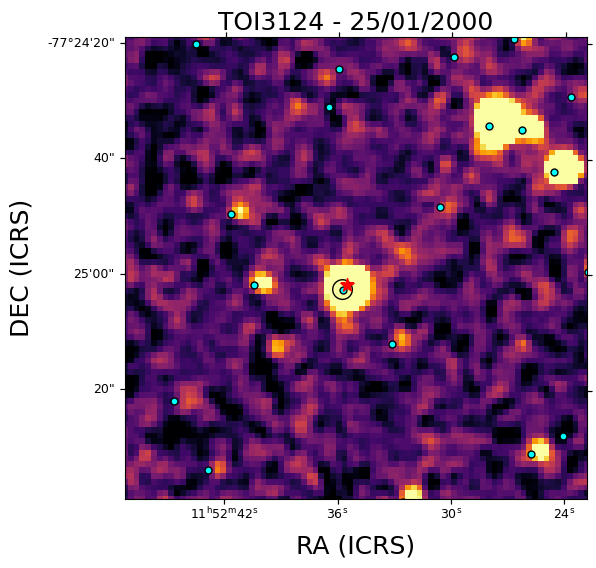

In [17]:
wcs = WCS(fits.getheader('TOI3124/ArchivalIms/aJ_asky_000125s1130245.fits'))
toi3124_df = pd.read_csv('TOI3124/Nightly_Summaries/Phot_Outputs/TOI3124_Stack_17032024_phot.csv')

sub = np.logical_and(toi3124_df['X_IMAGE'] > 1126 - 5, toi3124_df['X_IMAGE'] < 1126 + 5)
sub2 = np.logical_and(toi3124_df['Y_IMAGE'] > 788 - 5,toi3124_df['Y_IMAGE'] < 788 + 5)

toi3124_sub = toi3124_df[sub]
toi3124_sub = toi3124_sub[sub2]

fig = plt.figure(figsize=(6,6))
ax = plt.subplot(projection=wcs) 

z1,z2 = z.get_limits(toi3124_ar[1])

ax.imshow(toi3124_ar[1], vmin=z1 + 1, vmax=z2, origin = 'lower', cmap = 'inferno')
ax.set_xlim(370 - 40, 370 + 40)
ax.set_ylim(380 - 40, 380 + 40)
ax.set_xlabel('RA (ICRS)', fontsize = 18)
ax.set_ylabel('DEC (ICRS)', fontsize = 18)

ax.scatter(toi3124_sub['RA'], toi3124_sub['DEC'],facecolors='none', edgecolors='black', linewidths=1, marker='o', s=200,
transform=ax.get_transform('icrs'))

ax.scatter(toi3124_df['RA'], toi3124_df['DEC'],facecolors='cyan', edgecolors='black', linewidths=1, marker='.', s=100,
transform=ax.get_transform('icrs'))

coord_2mass = wcs.pixel_to_world(368.5, 377)
x_2mass, y_2mass = coord_2mass.icrs.ra.value, coord_2mass.icrs.dec.value


ax.scatter(x_2mass, y_2mass, color = 'r', linewidths=1, marker='*', s=100,transform=ax.get_transform('icrs'))

ax.set_title('TOI3124 - 25/01/2000', fontsize = 18)

plt.tight_layout()
plt.savefig('TOI3124_2MASSJ_archival.png')

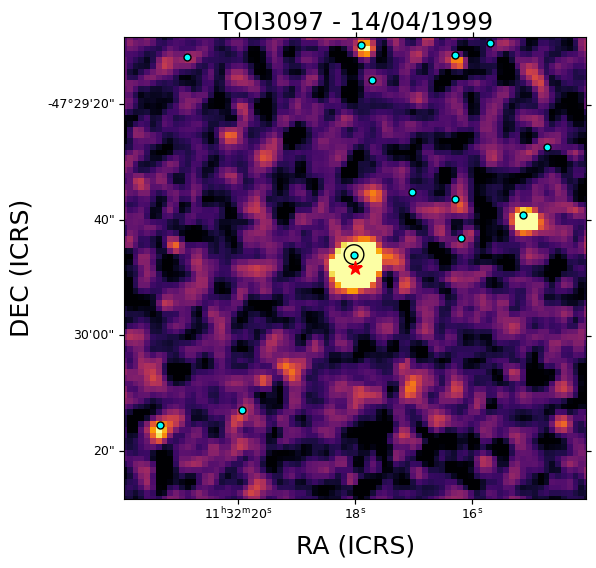

In [18]:
wcs = WCS(fits.getheader('TOI3097/ArchivalIms/aJ_asky_990414s0760245.fits'))
toi3097_df = pd.read_csv('TOI3097/Nightly_Summaries/Phot_Outputs/TOI3097_Stack_15032024_phot.csv')

sub = np.logical_and(toi3097_df['X_IMAGE'] > 1186 - 5, toi3097_df['X_IMAGE'] < 1186 + 5)
sub2 = np.logical_and(toi3097_df['Y_IMAGE'] > 747 - 5,toi3097_df['Y_IMAGE'] < 747 + 5)

toi3097_sub = toi3097_df[sub]
toi3097_sub = toi3097_sub[sub2]

fig = plt.figure(figsize=(6,6))
ax = plt.subplot(projection=wcs) 

z1,z2 = z.get_limits(toi3097_ar[1])

ax.imshow(toi3097_ar[1], vmin=z1 + 2, vmax=z2 , origin = 'lower', cmap = 'inferno')
ax.set_xlim(385 - 40, 385 + 40)
ax.set_ylim(90 - 40, 90 + 40)
ax.set_xlabel('RA (ICRS)', fontsize = 18)
ax.set_ylabel('DEC (ICRS)', fontsize = 18)

ax.scatter(toi3097_sub['RA'], toi3097_sub['DEC'],facecolors='none', edgecolors='black', linewidths=1, marker='o', s=200,
transform=ax.get_transform('icrs'))

ax.scatter(toi3097_df['RA'], toi3097_df['DEC'],facecolors='cyan', edgecolors='black', linewidths=1, marker='.', s=100,
transform=ax.get_transform('icrs'))

coord_2mass = wcs.pixel_to_world(385, 90)
x_2mass, y_2mass = coord_2mass.icrs.ra.value, coord_2mass.icrs.dec.value


ax.scatter(x_2mass, y_2mass, color = 'r', linewidths=1, marker='*', s=100,transform=ax.get_transform('icrs'))

ax.set_title('TOI3097 - 14/04/1999', fontsize = 18)

plt.tight_layout()
plt.savefig('TOI3097_2MASSJ_archival.png')

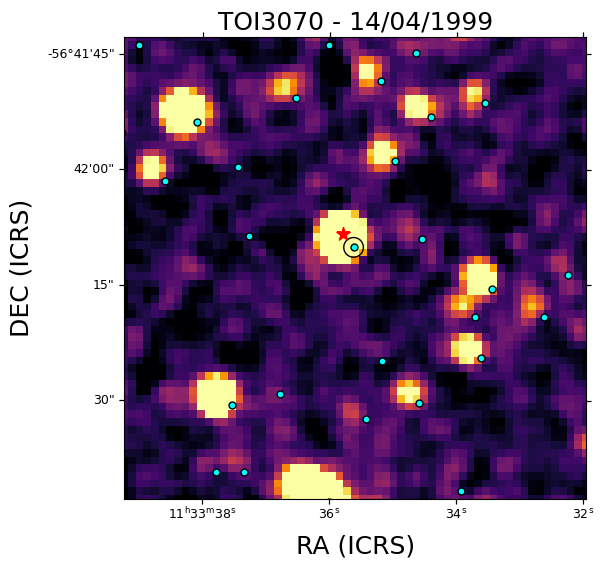

In [19]:
wcs = WCS(fits.getheader('TOI3070/ArchivalIms/aJ_asky_000126s1130127.fits'))
toi3070_df = pd.read_csv('TOI3070/Nightly_Summaries/Phot_Outputs/TOI3070_Stack_12022024_phot.csv')

sub = np.logical_and(toi3070_df['X_IMAGE'] > 1015 - 5, toi3070_df['X_IMAGE'] < 1015 + 5)
sub2 = np.logical_and(toi3070_df['Y_IMAGE'] > 1148 - 5,toi3070_df['Y_IMAGE'] < 1148 + 5)

toi3070_sub = toi3070_df[sub]
toi3070_sub = toi3070_sub[sub2]

fig = plt.figure(figsize=(6,6))
ax = plt.subplot(projection=wcs) 

z1,z2 = z.get_limits(toi3070_ar[1])

ax.imshow(toi3070_ar[1], vmin=z1 + 1, vmax=z2 , origin = 'lower', cmap = 'inferno')
ax.set_xlim(380 - 30, 380 + 30)
ax.set_ylim(440 - 30,440 + 30)
ax.set_xlabel('RA (ICRS)', fontsize = 18)
ax.set_ylabel('DEC (ICRS)', fontsize = 18)

ax.scatter(toi3070_sub['RA'], toi3070_sub['DEC'],facecolors='none', edgecolors='black', linewidths=1, marker='o', s=200,
transform=ax.get_transform('icrs'))

ax.scatter(toi3070_df['RA'], toi3070_df['DEC'],facecolors='cyan', edgecolors='black', linewidths=1, marker='.', s=100,
transform=ax.get_transform('icrs'))

coord_2mass = wcs.pixel_to_world(378.4, 444.4)
x_2mass, y_2mass = coord_2mass.icrs.ra.value, coord_2mass.icrs.dec.value


ax.scatter(x_2mass, y_2mass, color = 'r', linewidths=1, marker='*', s=100,transform=ax.get_transform('icrs'))

ax.set_title('TOI3070 - 14/04/1999', fontsize = 18)

plt.tight_layout()
plt.savefig('TOI3070_2MASSJ_archival.png')

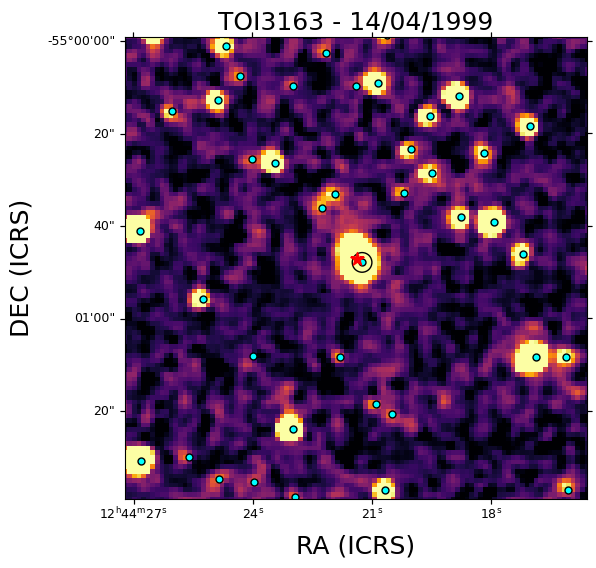

In [20]:
wcs = WCS(fits.getheader('TOI3163/ArchivalIms/aJ_asky_000327s0480056.fits'))
toi3163_df = pd.read_csv('TOI3163/Nightly_Summaries/Phot_Outputs/TOI3163_Stack_10022024_phot.csv')

sub = np.logical_and(toi3163_df['X_IMAGE'] > 995 - 5, toi3163_df['X_IMAGE'] < 995 + 5)
sub2 = np.logical_and(toi3163_df['Y_IMAGE'] > 899 - 5,toi3163_df['Y_IMAGE'] < 899 + 5)
toi3163_sub = toi3163_df[sub]
toi3163_sub = toi3163_sub[sub2]

fig = plt.figure(figsize=(6,6))
ax = plt.subplot(projection=wcs) 

z1,z2 = z.get_limits(toi3163_ar[1])

ax.imshow(toi3163_ar[1], vmin=z1 + 1.5, vmax=z2 , origin = 'lower', cmap = 'inferno')
ax.set_xlim(100 - 50, 100 + 50)
ax.set_ylim(700 - 50, 700 + 50)
ax.set_xlabel('RA (ICRS)', fontsize = 18)
ax.set_ylabel('DEC (ICRS)', fontsize = 18)

ax.scatter(toi3163_sub['RA'], toi3163_sub['DEC'],facecolors='none', edgecolors='black', linewidths=1, marker='o', s=200,
transform=ax.get_transform('icrs'))

ax.scatter(toi3163_df['RA'], toi3163_df['DEC'],facecolors='cyan', edgecolors='black', linewidths=1, marker='.', s=100,
transform=ax.get_transform('icrs'))

coord_2mass = wcs.pixel_to_world(100.2, 702)
x_2mass, y_2mass = coord_2mass.icrs.ra.value, coord_2mass.icrs.dec.value


ax.scatter(x_2mass, y_2mass, color = 'r', linewidths=1, marker='*', s=100,transform=ax.get_transform('icrs'))

ax.set_title('TOI3163 - 14/04/1999', fontsize = 18)

plt.tight_layout()
plt.savefig('TOI3163_2MASSJ_archival.png')

### TOI3070

In [4]:
stats_toi3070_n1 = pd.read_csv('TOI3070/Nightly_Summaries/Summary_H50_TOI3070_16012024.csv', index_col=0)
stats_toi3070_n2 = pd.read_csv('TOI3070/Nightly_Summaries/Summary_H50_TOI3070_12022024.csv', index_col=0)

In [42]:
print('Median Values for TOI 3070 - 16012024 \n')

for col in stats_toi3070_n1.columns:
    if col != 'File':
        print('{:} : {:.3f} ({:.2f} , {:.2f})'.format(col, stats_toi3070_n1[col].median(), stats_toi3070_n1[col].min(), stats_toi3070_n1[col].max()))
        
print('\nMedian Values for TOI 3070 - 12022024 \n')

for col in stats_toi3070_n2.columns:
    if col != 'File':
        print('{:} : {:.3f} ({:.2f} , {:.2f})'.format(col, stats_toi3070_n2[col].median(), stats_toi3070_n2[col].min(), stats_toi3070_n2[col].max()))

Median Values for TOI 3070 - 16012024 

N_stars : 2977.500 (2263.00 , 3659.00)
FWHM [pix] : 6.202 (5.18 , 7.73)
Bkg [adu/s] : 2.240 (2.01 , 2.56)

Median Values for TOI 3070 - 12022024 

N_stars : 3919.000 (3428.00 , 4582.00)
FWHM [pix] : 4.434 (4.01 , 4.94)
Bkg [adu/s] : 2.079 (1.83 , 2.31)


### TOI3097

In [16]:
stats_toi3097_n1 = pd.read_csv('TOI3097/Nightly_Summaries/Summary_H50_TOI3097_15032024.csv', index_col=0)

In [44]:
print('Median Values for TOI 3097 - 15032024 \n')

for col in stats_toi3097_n1.columns:
    if col != 'File':
        print('{:} : {:.3f} ({:.2f} , {:.2f})'.format(col, stats_toi3097_n1[col].median(), stats_toi3097_n1[col].min(), stats_toi3097_n1[col].max()))

Median Values for TOI 3097 - 15032024 

N_stars : 1947.000 (1708.00 , 2041.00)
FWHM [pix] : 3.352 (3.06 , 3.78)
Bkg [adu/s] : 1.856 (1.68 , 2.47)


### TOI3124

In [71]:
stats_toi3124_n1 = pd.read_csv('TOI3124/Nightly_Summaries/Summary_H50_TOI3124_17032024.csv', index_col=0)

In [49]:
print('Median Values for TOI 3124 - 17032024 \n')

for col in stats_toi3124_n1.columns:
    if col != 'File':
        print('{:} : {:.3f} ({:.2f} , {:.2f})'.format(col, stats_toi3124_n1[col].median(), stats_toi3124_n1[col].min(), stats_toi3124_n1[col].max()))

Median Values for TOI 3124 - 17032024 

N_stars : 1842.000 (1386.00 , 2006.00)
FWHM [pix] : 4.013 (3.57 , 5.38)
Bkg [adu/s] : 2.585 (1.65 , 3.49)


### TOI3163

In [25]:
stats_toi3163_n1 = pd.read_csv('TOI3163/Nightly_Summaries/Summary_H50_TOI3163_10022024.csv', index_col=0)

In [51]:
print('Median Values for TOI 3163 - 10022024 \n')

for col in stats_toi3163_n1.columns:
    if col != 'File':
        print('{:} : {:.3f} ({:.2f} , {:.2f})'.format(col, stats_toi3163_n1[col].median(), stats_toi3163_n1[col].min(), stats_toi3163_n1[col].max()))

Median Values for TOI 3163 - 10022024 

N_stars : 2064.000 (1373.00 , 2581.00)
FWHM [pix] : 4.192 (3.62 , 5.30)
Bkg [adu/s] : 2.058 (1.90 , 2.43)


### TOI4266

In [37]:
stats_toi4266_n1 = pd.read_csv('TOI4266/Nightly_Summaries/Summary_H50_TOI4266b_15012024.csv', index_col=0)

In [53]:
print('Median Values for TOI 4266 - 15012024 \n')

for col in stats_toi4266_n1.columns:
    if col != 'File':
        print('{:} : {:.3f} ({:.2f} , {:.2f})'.format(col, stats_toi4266_n1[col].median(), stats_toi4266_n1[col].min(), stats_toi4266_n1[col].max()))

Median Values for TOI 4266 - 15012024 

N_stars : 3173.500 (2400.00 , 3661.00)
FWHM [pix] : 4.560 (4.15 , 5.65)
Bkg [adu/s] : 1.925 (1.84 , 2.29)


## Non-planetary light curves 

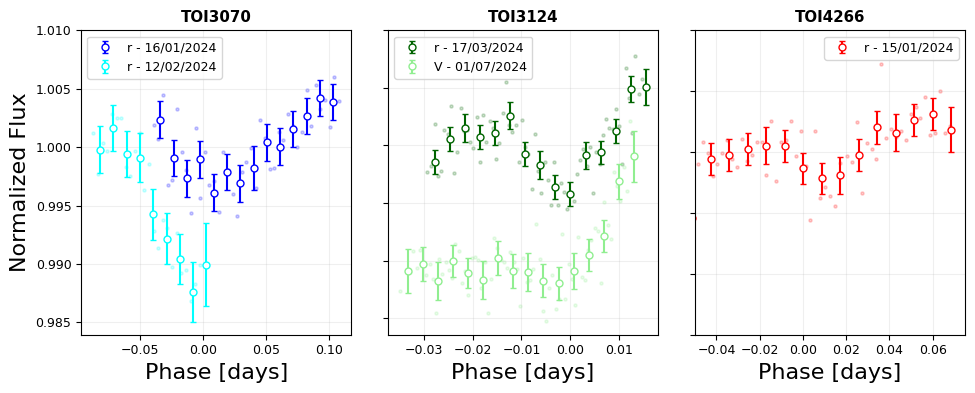

In [24]:
TOI3070_H50_jan = pd.read_csv('TOI3070/Phot_Outputs/Broeg_16012024/diffLC.csv')
TOI3070_H50_binned_jan = lk.LightCurve(time = TOI3070_H50_jan['BJD-TDB'] - 2457000.0, flux = TOI3070_H50_jan['DIFF_FLUX'],\
                                   flux_err = TOI3070_H50_jan['ERROR']).bin(600*u.second)

TOI3070_H50_feb = pd.read_csv('TOI3070/Phot_Outputs/Broeg_12022024/diffLC.csv')
TOI3070_H50_binned_feb = lk.LightCurve(time = TOI3070_H50_feb['BJD-TDB'] - 2457000.0, flux = TOI3070_H50_feb['DIFF_FLUX'],\
                                   flux_err = TOI3070_H50_feb['ERROR']).bin(600*u.second)

phases_3070_jan = juliet.utils.get_phases(TOI3070_H50_jan['BJD-TDB'] - 2457000.0, 0.6587, 3043.47021, phmin = 0.5)
phases_3070_jan_bin = juliet.utils.get_phases(TOI3070_H50_binned_jan.time.value, 0.6587, 3043.47021, phmin = 0.5)
phases_3070_feb = juliet.utils.get_phases(TOI3070_H50_feb['BJD-TDB'] - 2457000.0, 0.6587, 3043.47021, phmin = 0.5)
phases_3070_feb_bin = juliet.utils.get_phases(TOI3070_H50_binned_feb.time.value, 0.6587, 3043.47021, phmin = 0.5)


TOI3124_H50_r = pd.read_csv('TOI3124/Phot_Outputs/TOI3124_diffLC_r_032024.csv')
TOI3124_H50_binned_r = lk.LightCurve(time = TOI3124_H50_r['BJD-TDB'] - 2457000.0, flux = TOI3124_H50_r['DIFF_FLUX'],\
                                   flux_err = TOI3124_H50_r['ERROR']).bin(600*u.second)

TOI3124_H50_V = pd.read_csv('TOI3124/Phot_Outputs/TOI3124_diffLC_V_062024.csv')
TOI3124_H50_binned_V = lk.LightCurve(time = TOI3124_H50_V['BJD-TDB'] - 2457000.0, flux = TOI3124_H50_V['DIFF_FLUX'],\
                                   flux_err = TOI3124_H50_V['ERROR']).bin(600*u.second)

phases_3124_V_bin = juliet.utils.get_phases(TOI3124_H50_binned_V.time.value, 2.254617, 3107.448, phmin = 0.5)
phases_3124_r_bin = juliet.utils.get_phases(TOI3124_H50_binned_r.time.value, 2.254617, 3107.448, phmin = 0.5)
phases_3124_V = juliet.utils.get_phases(TOI3124_H50_V['BJD-TDB'] - 2457000.0, 2.254617, 3107.448, phmin = 0.5)
phases_3124_r = juliet.utils.get_phases(TOI3124_H50_r['BJD-TDB'] - 2457000.0, 2.254617, 3107.448, phmin = 0.5)


TOI4266_H50 = pd.read_csv('TOI4266/Phot_Outputs/Broeg/TOI4266_diffLC_r.csv')
TOI4266_H50_binned = lk.LightCurve(time = TOI4266_H50['BJD-TDB'] - 2457000.0, flux = TOI4266_H50['DIFF_FLUX'],\
                                   flux_err = TOI4266_H50['ERROR']).bin(600*u.second)

phases_4266_r = juliet.utils.get_phases(TOI4266_H50['BJD-TDB'] - 2457000.0, 0.81184, 3041.719, phmin = 0.5)
phases_4266_r_bin = juliet.utils.get_phases(TOI4266_H50_binned.time.value, 0.81184, 3041.719, phmin = 0.5)


fig, ax = plt.subplots(1,3, figsize = (10,4))
ax[0].scatter(x = phases_3070_jan, y = TOI3070_H50_jan['DIFF_FLUX'], color = 'blue', s = 5, alpha = 0.2)
ax[0].errorbar(x= phases_3070_jan_bin, y=TOI3070_H50_binned_jan.flux,\
               yerr=TOI3070_H50_binned_jan.flux_err, fmt = 'o', mfc = 'white', capsize = 2,\
               alpha = 1, label = 'r - 16/01/2024', color = 'blue')

ax[0].scatter(x = phases_3070_feb, y = TOI3070_H50_feb['DIFF_FLUX'] - 0.005, color = 'cyan', s = 5, alpha = 0.2)
ax[0].errorbar(x= phases_3070_feb_bin, y=TOI3070_H50_binned_feb.flux - 0.005,\
               yerr=TOI3070_H50_binned_feb.flux_err, fmt = 'o', mfc = 'white', capsize = 2,\
               alpha = 1, label = 'r - 12/02/2024', color = 'cyan')


ax[1].scatter(x = phases_3124_r, y = TOI3124_H50_r['DIFF_FLUX'], color = 'darkgreen', s = 5, alpha = 0.2)
ax[1].errorbar(x=phases_3124_r_bin, y=TOI3124_H50_binned_r.flux,\
               yerr=TOI3124_H50_binned_r.flux_err, fmt = 'o', mfc = 'white', capsize = 2,\
               alpha = 1, label = 'r - 17/03/2024', color = 'darkgreen')

ax[1].scatter(x = phases_3124_V, y = TOI3124_H50_V['DIFF_FLUX'] - 0.01, color = 'lightgreen', s = 5, alpha = 0.2)
ax[1].errorbar(x= phases_3124_V_bin, y=TOI3124_H50_binned_V.flux - 0.01,\
               yerr=TOI3124_H50_binned_V.flux_err, fmt = 'o', mfc = 'white', capsize = 2,\
               alpha = 1, label = 'V - 01/07/2024', color = 'lightgreen')

ax[2].scatter(x = phases_4266_r, y = TOI4266_H50['DIFF_FLUX'], color = 'r', s = 5, alpha = 0.2)
ax[2].errorbar(x=phases_4266_r_bin, y=TOI4266_H50_binned.flux,\
               yerr=TOI4266_H50_binned.flux_err, fmt = 'o', mfc = 'white', capsize = 2,\
               alpha = 1, label = 'r - 15/01/2024', color = 'r')

# Set the ticks
ax[0].set_yticks(np.arange(0.985, 1.015, 0.005))
ax[0].set_ylabel('Normalized Flux', fontsize = 16)
ax[0].set_xlabel('Phase [days]', fontsize = 16)
ax[1].set_xlabel('Phase [days]', fontsize = 16)
ax[2].set_xlabel('Phase [days]', fontsize = 16)
ax[1].set_yticks(np.arange(0.985, 1.015, 0.005))
ax[1].tick_params(axis='y', labelleft = False)
ax[2].set_yticks(np.arange(0.985, 1.015, 0.005))
ax[2].tick_params(axis='y', labelleft = False)
ax[2].set_xlim(-0.05, 0.075)

# Add grids
ax[0].grid(alpha = 0.2)
ax[1].grid(alpha = 0.2)
ax[2].grid(alpha = 0.2)
ax[0].legend()
ax[1].legend()
ax[2].legend()
ax[0].set_title('TOI3070', fontweight = 'bold')
ax[1].set_title('TOI3124', fontweight = 'bold')
ax[2].set_title('TOI4266', fontweight = 'bold')

#fig.suptitle('Non-Planetary Light Curves', fontsize = 14, fontweight = 'bold')

plt.tight_layout()

plt.savefig('TASSIE_NonPlanets.png')

# -------------------------------------------------------------------

# Emperical Relations

# -------------------------------------------------------------------

In [3]:
def calc_Teff_Mann(bp, bp_er, rp, rp_er, metal_flag, FeH = None, FeH_err=None):
    """
    Mann et al. 2015 relation
    """
    BP = ufloat(bp, bp_er)
    RP = ufloat(rp, rp_er)
    bp_rp = BP - RP 
    BP_RP = ufloat(bp_rp.n, bp_rp.s)
        
    if metal_flag == 'y':
        FeH = ufloat(FeH, FeH_err)
        T_eff = 3500*(2.835-1.893*BP_RP + 0.7860*(BP_RP**2) - 0.1594*(BP_RP**3) + 0.01243*(BP_RP**4) + 0.04417*FeH)   
    else:
        T_eff = 3500*(3.245-2.4309*BP_RP + 1.043*(BP_RP**2) - 0.2127*(BP_RP**3) + 0.01649*(BP_RP**4))
    
    return T_eff.n, T_eff.s

In [4]:
def calc_R_Mann(t_eff, t_eff_er, metal_flag, FeH = None, FeH_err = None):
    """
    Mann et al. 2015 relation
    """
    X = ufloat(t_eff/3500, t_eff_er/3500)

    if metal_flag == 'y':
        FeH = ufloat(FeH, FeH_err)
        R = (16.7700 - 54.3210*X + 57.6627*(X**2) - 19.6994*(X**3))*(1+(0.4565*FeH))
    else:
        R = 10.5440 - 33.7546*X + 35.1909*(X**2) - 11.5928*(X**3)
    
    return R.n, R.s

In [5]:
def calc_R_Torres(T_eff, T_err, logg, logg_er, FeH, FeH_er):
    """
    Torres et al. 2010 relations
    """
    
    b1, b2, b3, b4, b5, b6, b7 = ufloat(2.4427, 0.038), ufloat(0.6679, 0.016),\
                                 ufloat(0.1771, 0.027), ufloat(0.705, 0.13),\
                                 ufloat(-0.21415, 0.0075), ufloat(0.02306, 0.0013),\
                                 ufloat(0.04173, 0.0082)
    
    x = unp.log10(ufloat(T_eff, T_err)) - 4.1
    X = ufloat(x.n, x.s)
                  
    logg = ufloat(logg, logg_er)
    FeH = ufloat(FeH, FeH_er)
                  
    logR = b1 + (b2*X) + (b3*(X**2)) + (b4*(X**3)) + (b5*(logg**2)) + (b6*(logg**3)) + (b7*FeH)
    logR = ufloat(logR.n, logR.s)
                  
    R = 10**logR
                  
    return R.n, R.s/3, (3.2/100)*R.n

In [6]:
def calc_M_Torres(T_eff, T_err, logg, logg_er, FeH, FeH_er):
    """
    Torres et al. 2010 relations
    """
    
    a1, a2, a3, a4, a5, a6, a7 = ufloat(1.5689, 0.058), ufloat(1.3787, 0.029),\
                                 ufloat(0.4243, 0.029), ufloat(1.139, 0.240),\
                                 ufloat(-0.1425, 0.0110), ufloat(0.01969, 0.0019),\
                                 ufloat(0.1010, 0.0140)
    
    x = unp.log10(ufloat(T_eff, T_err)) - 4.1
    X = ufloat(x.n, x.s)
                  
    logg = ufloat(logg, logg_er)
    FeH = ufloat(FeH, FeH_er)
                  
    logM = a1 + (a2*X) + (a3*(X**2)) + (a4*(X**3)) + (a5*(logg**2)) + (a6*(logg**3)) + (a7*FeH)
    logM = ufloat(logM.n, logM.s)
                  
    M = 10**logM
                  
    return M.n, M.s/3, (6.4/100)*M.n,

## Refiting the Kesseli et al. 2019 subdwarf radius-colour relation

In [7]:
dwarfs = pd.read_csv('../../Desktop/Stellar_Models/Mamajek_Dwarfs.csv')
subdwarfs = pd.read_csv('../../Desktop/Stellar_Models/Kesseli_Subdwarfs.csv')
dwarfs = dwarfs.replace('....', np.nan)
dwarfs = dwarfs.replace('...', np.nan)
dwarfs = dwarfs.dropna(subset='Msun')
dwarfs = dwarfs.dropna(subset='R_Rsun')

subdwarfs['BPRP'] = subdwarfs['BP'] - subdwarfs['RP']
subdwarfs = subdwarfs.dropna()
subdwarfs = subdwarfs[subdwarfs['FeH'] < -0.5]

In [9]:
from scipy import optimize

def R_kesseli(x, a, b, c):
    col, FeH = x
    return 0.1+a*np.exp(-((b*col) + (c*FeH)))

x_data = [subdwarfs['BPRP'], subdwarfs['FeH']]
y_data = subdwarfs['Rad']
y_sig = subdwarfs['Rad_e']

params, params_covariance = optimize.curve_fit(R_kesseli, x_data, y_data, sigma=y_sig, p0=[4.0, 1.0, -1.0])

print(params, '+/-', np.sqrt(np.diag(params_covariance)))

[84.91377177  2.71856663 -1.15364651] +/- [36.12527713  0.19402821  0.13410836]


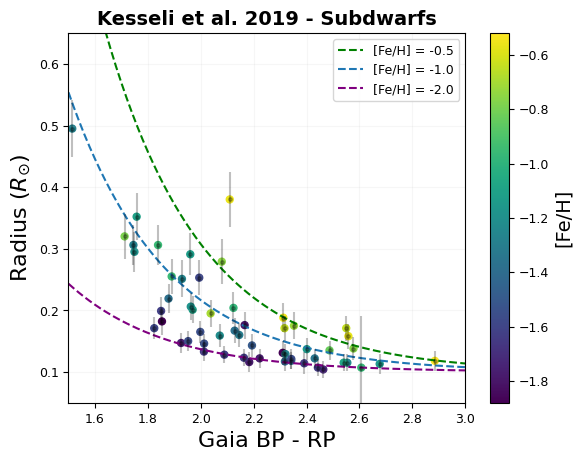

In [12]:
# Plot the Kesseli sample with new relations

col_ar = np.arange(1.5, 3.2, 0.01)
R_test_1 = R_kesseli([col_ar, np.full_like(col_ar, -1.0)], params[0], params[1], params[2])
R_test_2 = R_kesseli([col_ar, np.full_like(col_ar, -2.0)], params[0], params[1], params[2])
R_test_05 = R_kesseli([col_ar, np.full_like(col_ar, -0.5)], params[0], params[1], params[2])
#R_test_0 = R_kesseli([col_ar, np.full_like(col_ar, 0.0)], params[0], params[1], params[2])

plt.plot(col_ar, R_test_05, color = 'green', linestyle = 'dashed', label = '[Fe/H] = -0.5')
plt.plot(col_ar, R_test_1, linestyle = 'dashed', label = '[Fe/H] = -1.0')
plt.plot(col_ar, R_test_2, color = 'purple', linestyle = 'dashed', label = '[Fe/H] = -2.0')
#plt.plot(col_ar, R_test_0, color = 'orange')
plt.scatter(x_data[0], y_data, c = x_data[1].to_numpy())
plt.errorbar(x= x_data[0], y=y_data, yerr = 2*y_sig, fmt = '.', color = 'k', alpha = 0.25)
plt.colorbar().set_label(label = '[Fe/H]', size = 14)
plt.grid(alpha=0.1)
plt.ylim(0.05, 0.65)
plt.xlim(1.5, 3.0)
plt.xlabel('Gaia BP - RP', fontsize = 16)
plt.ylabel('Radius ($R_{\odot}$)', fontsize = 16)
plt.legend()
#plt.tight_layout()
plt.title('Kesseli et al. 2019 - Subdwarfs', fontsize = 14, fontweight = 'bold')
plt.savefig('Kesseli_Refit.png')

In [95]:
def calc_R_Kesseli(bp, bp_er, rp, rp_er, FeH, FeH_err):
    """
    A function to calculate the radius of a subdwarf star, given GAIA colour and metallicity.
    
    Note: this is using my re-fit of the relation, based on the original data
    """
    BP = ufloat(bp, bp_er)
    RP = ufloat(rp, rp_er)
    bp_rp = BP - RP 
    BP_RP = ufloat(bp_rp.n, bp_rp.s)
    FeH = ufloat(FeH, FeH_err)
    
    A = ufloat(84.91377, 0)
    b = ufloat(2.71857, 0)
    c = ufloat(-1.15365, 0)
    
    R = 0.1+A*unp.exp(-((b*BP_RP) + (c*FeH)))
    
    return R

In [96]:
# TOI 3097

bp_3097A, bp_3097A_er = 14.102577, 0.008121
rp_3097A, rp_3097A_er = 12.958195, 0.007681
bp_3097B, bp_3097B_er = 15.084083, 0.114773
rp_3097B, rp_3097B_er = 13.277278, 0.162014

T_eff_3097A, T_err_3097A = 4802, 24
logg_3097A, loger_3097A = 4.36, 0.03
FeH_3097A, FeH_er_3097A = -1.07, 0.03

T_3097B_nometal = calc_Teff_Mann(bp_3097B, bp_3097B_er, rp_3097B, rp_3097B_er, 'n')
T_3097B_metal = calc_Teff_Mann(bp_3097B, bp_3097B_er, rp_3097B, rp_3097B_er, 'y', FeH_3097A, FeH_er_3097A)
R_3097B_nometal = calc_R_Mann(T_3097B_nometal[0], T_3097B_nometal[1], 'n')
R_3097B_metal = calc_R_Mann(T_3097B_metal[0], T_3097B_metal[1], 'y', FeH_3097A, FeH_er_3097A)
R_3097B_kes = calc_R_Kesseli(bp_3097B, bp_3097B_er, rp_3097B, rp_3097B_er, FeH_3097A, FeH_er_3097A)

#print('For A: ', calc_Teff_(bp_3097A, bp_3097A_er, rp_3097A, rp_3097A_er, 'n'))
print('For B without Metal (Mann2015): ', T_3097B_nometal, R_3097B_nometal)
print('For B with Metal (Mann2015): ', T_3097B_metal, R_3097B_metal)
print('For B with Metal (Kesseli2018): ', R_3097B_kes)

print(calc_R_Torres(T_eff_3097A, T_err_3097A, logg_3097A, loger_3097A, FeH_3097A, FeH_er_3097A))
print(calc_M_Torres(T_eff_3097A, T_err_3097A, logg_3097A, loger_3097A, FeH_3097A, FeH_er_3097A))

For B without Metal (Mann2015):  (4126.174051126649, 247.35792002422926) (0.6650812719555752, 0.06242060588354351)
For B with Metal (Mann2015):  (3939.787296590061, 222.79709265977294) (0.30184934576595795, 0.021515537662638407)
For B with Metal (Kesseli2018):  0.28+/-0.10
(0.8672743488982226, 0.12255155600137152, 0.027752779164743124)
(0.6275105923250458, 0.1297992318124028, 0.040160677908802934)


In [97]:
# Calculate the surface gravity using the mass
M_3097B = ufloat(0.27, 0.03)

logg_3097B = unp.log10(M_3097B) - 2*unp.log10(ufloat(0.30, 0.02)) + 4.437

print(logg_3097B)

4.91+/-0.08


In [86]:
#TOI3163

T_eff_3163, T_err_3163 = 6501, 42
logg_3163, loger_3163 = 4.16, 0.03
FeH_3163, FeH_er_3163 = -0.22, 0.03

print('Radius of 3163: ', calc_R_Torres(T_eff_3163, T_err_3163, logg_3163, loger_3163, FeH_3163, FeH_er_3163))
print('Mass of 3163: ', calc_M_Torres(T_eff_3163, T_err_3163, logg_3163, loger_3163, FeH_3163, FeH_er_3163))

Radius of 3163:  (1.5626577771522179, 0.19853678471022332, 0.05000504886887097)
Mass of 3163:  (1.2895819277469118, 0.23935122446597565, 0.08253324337580235)


In [82]:
# Using Pecaut and Mamajek 2013 dwarf sequence, let's figure out the mass roughly for TOI3097B.

M = interpolate.interp1d(dwarfs['Teff'].astype(float), dwarfs['Msun'].astype(float))
R = interpolate.interp1d(dwarfs['Teff'].astype(float), dwarfs['R_Rsun'].astype(float))

M_R = interpolate.interp1d(dwarfs['R_Rsun'].astype(float), dwarfs['Msun'].astype(float))

In [84]:
print('Mass: ', M_R([0.30, 0.30 - 0.02, 0.30 + 0.02]))

Mass:  [0.27       0.23923077 0.30278689]


In [81]:
R_3097B = calc_R_Kesseli(bp_3097B, bp_3097B_er, rp_3097B, rp_3097B_er, FeH_3097A, FeH_er_3097A)

## ----------------------------------------------------------------------------------
# Spectral Energy Distribution Fitting
## ----------------------------------------------------------------------------------

### TOI3070

In [2]:
ra_str = '11:33:35.7960585274'
dec_str = '-56:42:08.649773522'

SkyCoord(ra=ra_str, dec=dec_str, unit = (u.hour, u.deg))

<SkyCoord (ICRS): (ra, dec) in deg
    (173.39915024, -56.70240271)>

In [3]:
ra = 173.39915024
dec = -56.70240271
starname = 'TOI3070'
gaia_id = '5342871047750973312'

#TOI3070 = Star(starname, ra, dec, g_id=gaia_id, plx = 0.4649, plx_e = 0.0422)
TOI3070 = Star(starname, ra, dec, g_id=gaia_id, dist=1216.71, dist_e=122)


		#####################################
		##             ARIADNE             ##
		#####################################
   spectrAl eneRgy dIstribution bAyesian moDel averagiNg fittEr

			Author : Jose Vines
			Contact : jose . vines at ug . uchile . cl
			Star : TOI3070
		*** LOOKING UP ARCHIVAL INFORMATION ***
INFO: Query finished. [astroquery.utils.tap.core]
INFO: Query finished. [astroquery.utils.tap.core]
Star not found in catalog TYCHO2.
INFO: Query finished. [astroquery.utils.tap.core]
Star not found in catalog Pan-STARRS.
INFO: Query finished. [astroquery.utils.tap.core]
Star not found in catalog SDSS.
INFO: Query finished. [astroquery.utils.tap.core]
INFO: Query finished. [astroquery.utils.tap.core]
INFO: Query finished. [astroquery.utils.tap.core]
Looking online for archival magnitudes for star TOI3070
Checking catalog APASS
Warning!: CatalogWarning
Warning message: Vmag magnitude error is 0, assigning error.
Warning!: CatalogWarning
Warning message: Bmag magnitude error is 

In [4]:
TOI3070.remove_mag('GROUND_JOHNSON_B')
TOI3070.remove_mag('GROUND_JOHNSON_V')
TOI3070.remove_mag('SDSS_g')
TOI3070.remove_mag('SDSS_r')  
TOI3070.print_mags()

			Removed GROUND_JOHNSON_B!!
			Removed GROUND_JOHNSON_V!!
			Removed SDSS_g!!
			Removed SDSS_r!!
		       Filter       	Magnitude	Uncertainty
		--------------------	---------	-----------
		    GaiaDR2v2_BP    	 14.1023 	  0.0029   
		    GaiaDR2v2_G     	 13.7830 	  0.0028   
		       SDSS_i       	 14.1620 	  0.0420   
		    GaiaDR2v2_RP    	 13.2985 	  0.0039   
		        TESS        	 13.3727 	  0.0069   
		      2MASS_J       	 12.7450 	  0.0330   
		      2MASS_H       	 12.4930 	  0.0260   
		      2MASS_Ks      	 12.3920 	  0.0260   
		    WISE_RSR_W1     	 12.3460 	  0.0230   
		    WISE_RSR_W2     	 12.3710 	  0.0230   



In [5]:
out_folder = 'TOI3070/SEDFitting_Close'

engine = 'dynesty'
nlive = 1000
dlogz = 0.05
bound = 'multi'
sample = 'rwalk'
threads = 4
dynamic = False

setup = [engine, nlive, dlogz, bound, sample, threads, dynamic]

# Feel free to uncomment any unneeded/unwanted models
models = ['phoenix','btsettl','btnextgen','btcond','kurucz','ck04']
#models = ['kurucz','ck04']

f = Fitter()
f.star = TOI3070
f.setup = setup
f.av_law = 'fitzpatrick'
f.out_folder = out_folder
f.bma = True
f.models = models
f.n_samples = 100000

f.prior_setup = {
'teff': ('default'),
'logg': ('default'),
'z': ('default'),
'dist': ('default'),
'rad': ('default'),
'Av': ('default')
}

In [6]:
f.initialize()
f.fit_bma()

Creation of the directory TOI3070/SEDFitting_Close failed. It might already exist

		*** EXECUTING MAIN FITTING ROUTINE ***
			Selected engine : Bayesian Model Averaging
			Live points : 1000
			log Evidence tolerance : 0.05
			Free parameters : 16
			Bounding : multi
			Sampling : rwalk
			N threads : 4

			FITTING MODEL : phoenix


23360it [02:56, 132.72it/s, +1000 | bound: 132 | nc: 1 | ncall: 530338 | eff(%):  4.602 | loglstar:   -inf < 271.939 <    inf | logz: 251.573 +/-  0.122 | dlogz:  0.000 >  0.050] 


			FITTING MODEL : btsettl


23888it [03:02, 130.74it/s, +1000 | bound: 138 | nc: 1 | ncall: 548466 | eff(%):  4.546 | loglstar:   -inf < 272.078 <    inf | logz: 251.143 +/-    nan | dlogz:  0.000 >  0.050] 


			FITTING MODEL : kurucz


23374it [02:57, 131.59it/s, +1000 | bound: 134 | nc: 1 | ncall: 534819 | eff(%):  4.566 | loglstar:   -inf < 271.122 <    inf | logz: 250.623 +/-    nan | dlogz:  0.000 >  0.050] 


			FITTING MODEL : ck04


23239it [02:57, 130.85it/s, +1000 | bound: 133 | nc: 1 | ncall: 531646 | eff(%):  4.568 | loglstar:   -inf < 271.487 <    inf | logz: 251.150 +/-    nan | dlogz:  0.000 >  0.050] 


		*** AVERAGING POSTERIOR SAMPLES ***


100%|███████████████████████████████████████████| 20/20 [00:00<00:00, 31.13it/s]


		*** ESTIMATING AGE AND MASS USING MIST ISOCHRONES ***


15485it [00:45, 341.72it/s, +500 | bound: 194 | nc: 1 | ncall: 488982 | eff(%):  3.272 | loglstar:   -inf < -1.702 <    inf | logz: -28.199 +/-  9.236 | dlogz:  0.000 >  0.010]



			Fitting finished.
			Best fit parameters are:
			teff : 5993.5396 + 184.8061 - 135.7170 [5733.6560, 6597.0470]
			logg : 4.2131 + 0.5420 - 0.3555 [3.5370, 5.2737]
			[Fe/H] : -0.2340 + 0.1821 - 0.1821 [-0.7062, 0.2136]
			dist : 1355.0089 + 91.4053 - 76.5828 [1226.5475, 1594.6389]
			rad : 2.0060 + 0.1503 - 0.1092 [1.7650, 2.3787]
			Av : 0.1658 + 0.1251 - 0.0938 [0.0094, 0.5289]
			Angular Diameter : 0.0138 + 0.0013 - 0.0012 [0.0110, 0.0172]
			Grav mass : 1.9090 + 4.0413 - 1.1278 [0.4993, 28.5067]
			Luminosity : 4.7751 + 0.9103 - 0.7014 [3.3723, 7.8342]
			Iso mass : 1.2465 + 0.2200 - 0.0651 [0.8312, 1.7578]
			Age (Gyr) : 0.0049 + 3.5545 - 0.0000 [0.0049, 11.3433]
			EEP : 189.7116 + 210.5259 - 12.2044 [166.3198, 470.4128]
			Excess BP noise : 0.0200 + 0.0155 - 0.0102 [0.0017, 0.0729]
			Excess G noise : 0.0147 + 0.0137 - 0.0086 [0.0005, 0.0618]
			Excess SDSS_i noise : 0.4907 + 0.1879 - 0.1402 [0.2313, 1.1231]
			Excess RP noise : 0.0190 + 0.0201 - 0.0110 [0.0009, 0.0855]
			E

In [2]:
out_folder = 'TOI3070/SEDFitting_Close'
in_file = os.path.join(out_folder, 'BMA.pkl')
plots_out_folder = os.path.join(out_folder, 'SEDPlots')
artist = SEDPlotter(in_file, plots_out_folder)


Initializing plotter.

Creation of the directory TOI3070/SEDFitting_Close/SEDPlots failed. It might already exist
Creation of the directory TOI3070/SEDFitting_Close/SEDPlots/histograms failed. It might already exist
Grid phoenix loaded.

Plotter initialized.



Plotting SED


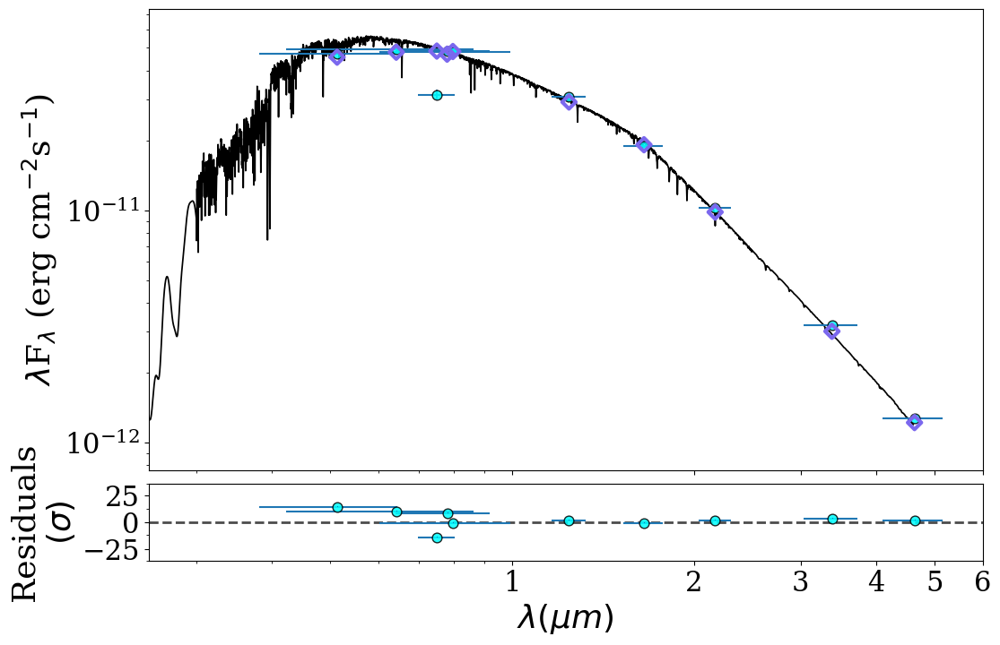

In [5]:
artist.plot_SED()
#plt.rcParams['axes.titley'] = 7.25
#plt.title('TOI3070', fontsize = 20, fontweight = 'bold')
#plt.tight_layout()
#plt.savefig(out_folder+'/SEDPlots/SED.png')

In [10]:
artist.plot_bma_hist()

Plotting BMA histograms.


Plotting HR diagram


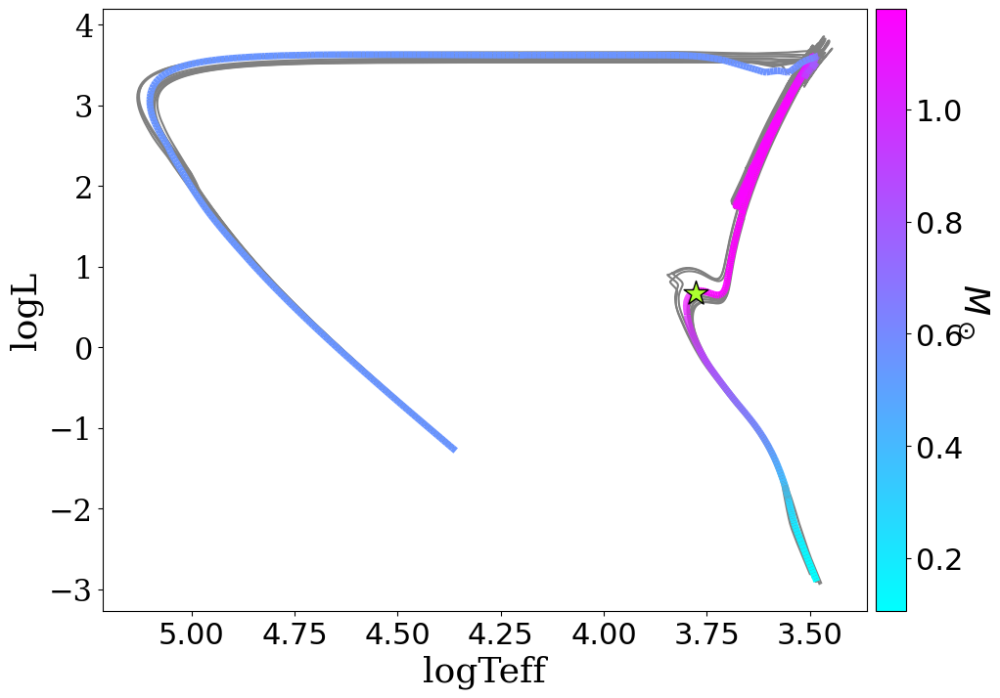

In [11]:
artist.plot_bma_HR(10)

Plotting corner.


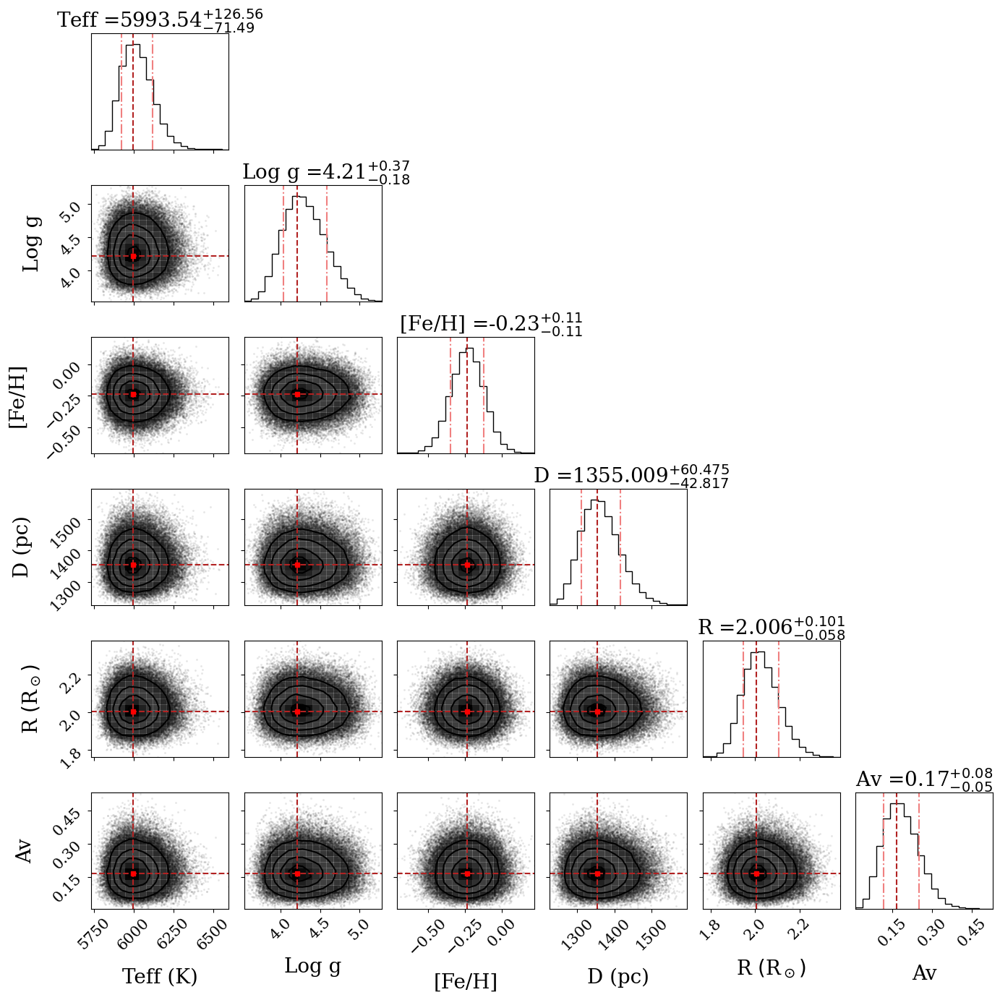

In [9]:
artist.plot_corner()
plt.rcParams['axes.titley'] = 0.5
plt.tight_layout()
plt.savefig(out_folder+'/SEDPlots/Corner_3070.png')

In [8]:
#artist.plot_SED()

# TOI3124

In [4]:
ra_str = '11:52:35.4545660035'
dec_str = '-77:25:02.134928908'

SkyCoord(ra=ra_str, dec=dec_str, unit = (u.hour, u.deg))

<SkyCoord (ICRS): (ra, dec) in deg
    (178.14772736, -77.4172597)>

In [5]:
ra = 178.14772736
dec = -77.4172597
starname = 'TOI3124'
gaia_id = '5224239068846508544'

TOI3124 = Star(starname, ra, dec, g_id=gaia_id, plx = 2.0360, plx_e = 0.0118)


		#####################################
		##             ARIADNE             ##
		#####################################
   spectrAl eneRgy dIstribution bAyesian moDel averagiNg fittEr

			Author : Jose Vines
			Contact : jose . vines at ug . uchile . cl
			Star : TOI3124
Star Warning ! ! !
Parallax input detected. Overriding coordinate search.
		*** LOOKING UP ARCHIVAL INFORMATION ***
INFO: Query finished. [astroquery.utils.tap.core]
INFO: Query finished. [astroquery.utils.tap.core]
Star not found in catalog TYCHO2.
INFO: Query finished. [astroquery.utils.tap.core]
Star not found in catalog Pan-STARRS.
INFO: Query finished. [astroquery.utils.tap.core]
Star not found in catalog SDSS.
INFO: Query finished. [astroquery.utils.tap.core]
INFO: Query finished. [astroquery.utils.tap.core]
INFO: Query finished. [astroquery.utils.tap.core]
Looking online for archival magnitudes for star TOI3124
Checking catalog APASS
Warning!: CatalogWarning
Warning message: Star is not available in catalog APA

In [15]:
TOI3124.remove_mag('STROMGREN_u')
TOI3124.remove_mag('STROMGREN_v')
TOI3124.remove_mag('STROMGREN_b')
TOI3124.remove_mag('STROMGREN_y')

			Removed STROMGREN_u!!
			Removed STROMGREN_v!!
			Removed STROMGREN_b!!
			Removed STROMGREN_y!!


In [16]:
TOI3124.print_mags()

		       Filter       	Magnitude	Uncertainty
		--------------------	---------	-----------
		    GaiaDR2v2_BP    	 13.6015 	  0.0049   
		    GaiaDR2v2_G     	 13.1609 	  0.0030   
		    GaiaDR2v2_RP    	 12.5429 	  0.0050   
		        TESS        	 12.6177 	  0.0061   
		      2MASS_J       	 11.7880 	  0.0270   
		      2MASS_H       	 11.4090 	  0.0260   
		      2MASS_Ks      	 11.3000 	  0.0230   
		    WISE_RSR_W1     	 11.2240 	  0.0230   
		    WISE_RSR_W2     	 11.2320 	  0.0210   



In [17]:
out_folder = 'TOI3124/SEDFitting'

engine = 'dynesty'
nlive = 1000
dlogz = 0.05
bound = 'multi'
sample = 'rwalk'
threads = 4
dynamic = False

setup = [engine, nlive, dlogz, bound, sample, threads, dynamic]

# Feel free to uncomment any unneeded/unwanted models
models = ['phoenix','btsettl','btnextgen','btcond','kurucz','ck04']
#models = ['kurucz','ck04']

f = Fitter()
f.star = TOI3124
f.setup = setup
f.av_law = 'fitzpatrick'
f.out_folder = out_folder
f.bma = True
f.models = models
f.n_samples = 100000

f.prior_setup = {
'teff': ('default'),
'logg': ('default'),
'z': ('default'),
'dist': ('default'),
'rad': ('default'),
'Av': ('default')
}

In [19]:
f.initialize()
f.fit_bma()

Created the directory TOI3124/SEDFitting

		*** EXECUTING MAIN FITTING ROUTINE ***
			Selected engine : Bayesian Model Averaging
			Live points : 1000
			log Evidence tolerance : 0.05
			Free parameters : 15
			Bounding : multi
			Sampling : rwalk
			N threads : 4

			FITTING MODEL : phoenix


24326it [02:41, 150.49it/s, +1000 | bound: 139 | nc: 1 | ncall: 556027 | eff(%):  4.563 | loglstar:   -inf < 242.513 <    inf | logz: 221.177 +/-  0.119 | dlogz:  0.000 >  0.050] 


			FITTING MODEL : btsettl


22646it [02:27, 153.39it/s, +1000 | bound: 129 | nc: 1 | ncall: 515238 | eff(%):  4.598 | loglstar:   -inf < 240.485 <    inf | logz: 220.784 +/-    nan | dlogz:  0.000 >  0.050] 


			FITTING MODEL : kurucz


22836it [02:29, 152.77it/s, +1000 | bound: 132 | nc: 1 | ncall: 522644 | eff(%):  4.569 | loglstar:   -inf < 240.715 <    inf | logz: 220.757 +/-    nan | dlogz:  0.000 >  0.050] 


			FITTING MODEL : ck04


22805it [02:32, 149.83it/s, +1000 | bound: 130 | nc: 1 | ncall: 520671 | eff(%):  4.581 | loglstar:   -inf < 240.772 <    inf | logz: 220.859 +/-    nan | dlogz:  0.000 >  0.050] 


			FITTING MODEL : phoenix


22780it [02:27, 154.63it/s, +1000 | bound: 128 | nc: 1 | ncall: 516151 | eff(%):  4.616 | loglstar:   -inf < 241.391 <    inf | logz: 221.604 +/-  0.119 | dlogz:  0.000 >  0.050] 


			FITTING MODEL : btsettl


22717it [02:27, 153.93it/s, +1000 | bound: 129 | nc: 1 | ncall: 517577 | eff(%):  4.591 | loglstar:   -inf < 240.676 <    inf | logz: 220.908 +/-    nan | dlogz:  0.000 >  0.050] 


			FITTING MODEL : kurucz


24007it [02:37, 152.14it/s, +1000 | bound: 139 | nc: 1 | ncall: 550946 | eff(%):  4.547 | loglstar:   -inf < 241.441 <    inf | logz: 220.318 +/-    nan | dlogz:  0.000 >  0.050] 


			FITTING MODEL : ck04


23315it [02:34, 151.35it/s, +1000 | bound: 134 | nc: 1 | ncall: 532513 | eff(%):  4.575 | loglstar:   -inf < 241.521 <    inf | logz: 221.072 +/-    nan | dlogz:  0.000 >  0.050] 


		*** AVERAGING POSTERIOR SAMPLES ***


100%|███████████████████████████████████████████| 19/19 [00:00<00:00, 25.55it/s]


		*** ESTIMATING AGE AND MASS USING MIST ISOCHRONES ***


20932it [00:48, 434.57it/s, +500 | bound: 260 | nc: 1 | ncall: 672508 | eff(%):  3.189 | loglstar:   -inf < 10.845 <    inf | logz: -26.541 +/- 10.448 | dlogz:  0.000 >  0.010] 



			Fitting finished.
			Best fit parameters are:
			teff : 5233.7910 + 143.3694 - 107.5271 [5016.6286, 5647.0323]
			logg : 4.3290 + 0.3958 - 0.3731 [3.6223, 5.3127]
			[Fe/H] : -0.2139 + 0.1440 - 0.1301 [-0.5600, 0.1323]
			dist : 494.2909 + 1.6712 - 1.4016 [491.7033, 499.7627]
			rad : 1.3371 + 0.0252 - 0.0272 [1.2521, 1.4025]
			Av : 0.1914 + 0.1258 - 0.0948 [0.0260, 0.5412]
			Angular Diameter : 0.0252 + 0.0005 - 0.0005 [0.0235, 0.0264]
			Grav mass : 0.9908 + 1.6575 - 0.5376 [0.2741, 10.4878]
			Luminosity : 1.2092 + 0.1400 - 0.1115 [0.9648, 1.6743]
			Iso mass : 0.9438 + 0.1118 - 0.0764 [0.8126, 1.1525]
			Age (Gyr) : 12.1084 + 1.3811 - 5.0747 [3.9182, 13.4895]
			EEP : 436.8890 + 6.3613 - 20.9688 [379.4016, 449.6116]
			Excess BP noise : 0.0378 + 0.0188 - 0.0154 [0.0064, 0.1002]
			Excess G noise : 0.0175 + 0.0109 - 0.0079 [0.0027, 0.0561]
			Excess RP noise : 0.0231 + 0.0170 - 0.0110 [0.0029, 0.0811]
			Excess TESS noise : 0.0459 + 0.0228 - 0.0151 [0.0144, 0.1192]
			Excess J 

In [5]:
out_folder = 'TOI3124/SEDFitting'
in_file = os.path.join(out_folder, 'BMA.pkl')
plots_out_folder = os.path.join(out_folder, 'SEDPlots')

In [6]:
artist = SEDPlotter(in_file, plots_out_folder)
#artist.plot_bma_HR(10)
#artist.plot_bma_hist()


Initializing plotter.

Creation of the directory TOI3124/SEDFitting/SEDPlots failed. It might already exist
Creation of the directory TOI3124/SEDFitting/SEDPlots/histograms failed. It might already exist
Grid phoenix loaded.

Plotter initialized.



Plotting SED


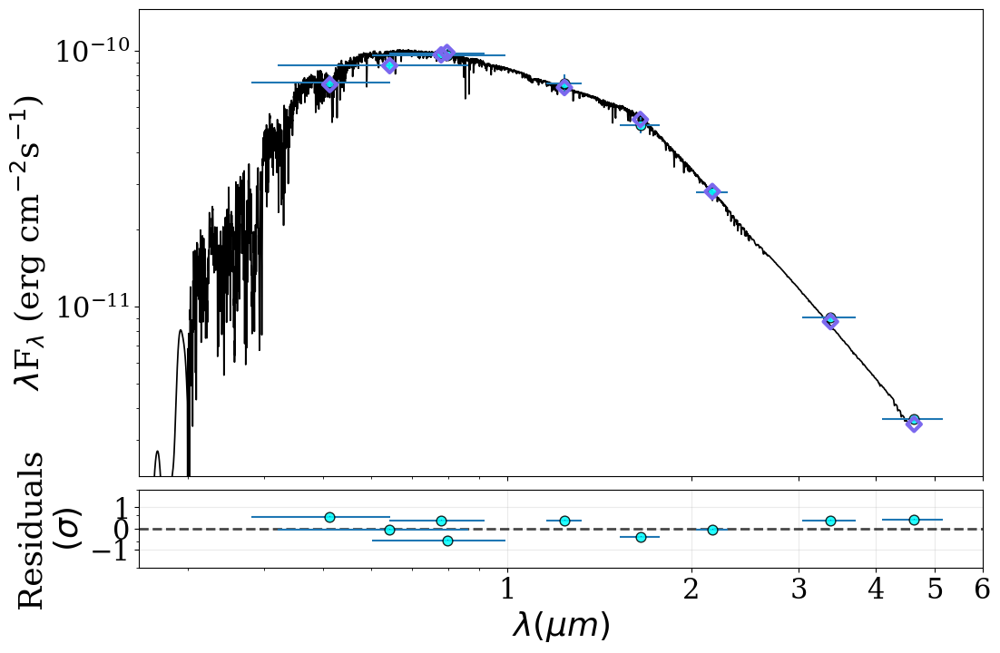

In [7]:
artist.plot_SED()
plt.grid(alpha = 0.25)

Plotting corner.


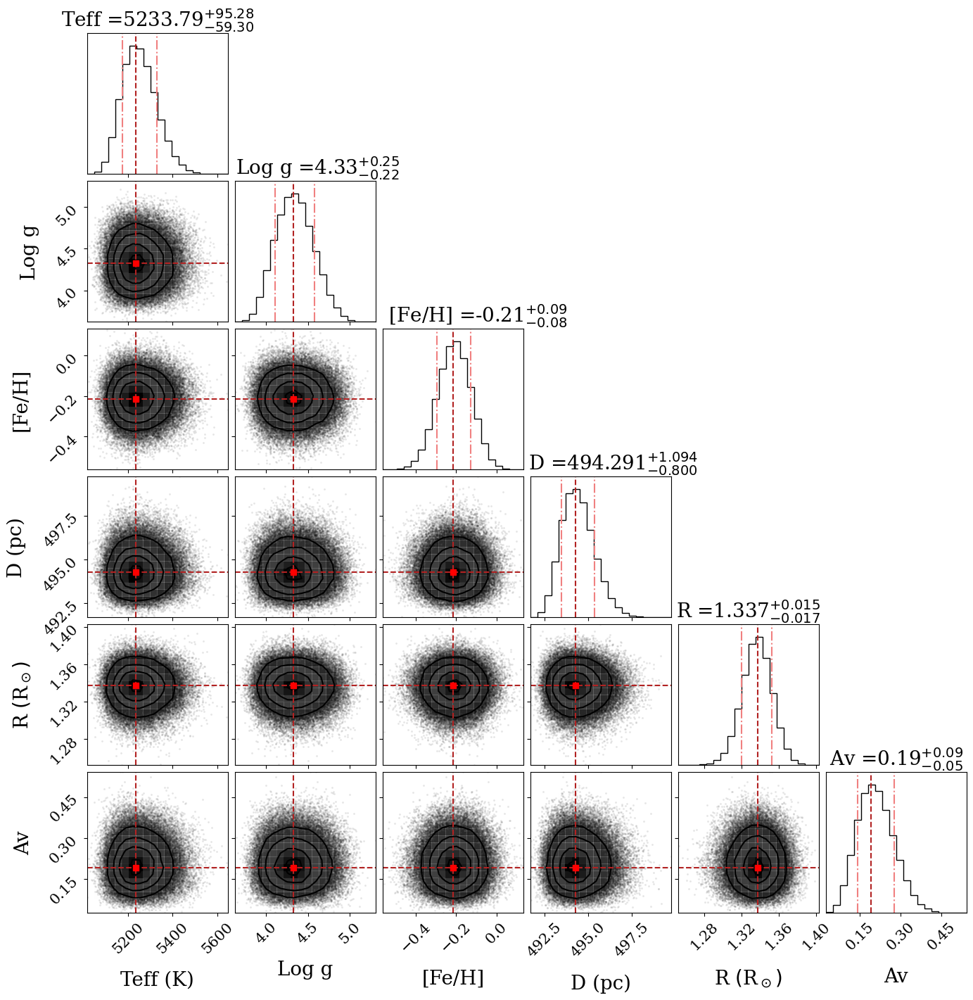

In [15]:
artist.plot_corner()

# TOI4266

In [3]:
ra_str = '09:43:06.880'
dec_str = '-58:30:38.80'

SkyCoord(ra=ra_str, dec=dec_str, unit = (u.hour, u.deg))

<SkyCoord (ICRS): (ra, dec) in deg
    (145.77866667, -58.51077778)>

In [5]:
ra = 145.77866667
dec = -58.51077778
starname = 'TOI4266'
gaia_id = '5305817570291360128'

#TOI4266 = Star(starname, ra, dec, g_id=gaia_id, plx = 1.1253, plx_e = 0.0517, temp = 6001.6, temp_e = 600, rad = 1.0463, rad_e = 0.1, lum = 2.430, lum_e = 0.2)
TOI4266 = Star(starname, ra, dec, g_id=gaia_id, dist=618.3, dist_e=60, temp = 6001.6, temp_e = 600, rad = 1.0463, rad_e = 0.1, lum = 2.430, lum_e = 0.2) 


		#####################################
		##             ARIADNE             ##
		#####################################
   spectrAl eneRgy dIstribution bAyesian moDel averagiNg fittEr

			Author : Jose Vines
			Contact : jose . vines at ug . uchile . cl
			Star : TOI4266
Star Warning ! ! !
Radius input detected. Overriding coordinate search.
Star Warning ! ! !
Temperature input detected. Overriding coordinate search.
Star Warning ! ! !
Luminosity input detected. Overriding coordinate search.
		*** LOOKING UP ARCHIVAL INFORMATION ***
INFO: Query finished. [astroquery.utils.tap.core]
Warning!: CatalogWarning
Warning message: Parameter teff not found! Be advised.
Warning!: CatalogWarning
Warning message: Parameter radius not found! Be advised.
Warning!: CatalogWarning
Warning message: Parameter lum not found! Be advised.
INFO: Query finished. [astroquery.utils.tap.core]
Star not found in catalog TYCHO2.
INFO: Query finished. [astroquery.utils.tap.core]
Star not found in catalog Pan-STARR

In [6]:
TOI4266.remove_mag('SDSS_g')
TOI4266.remove_mag('SDSS_r')
TOI4266.remove_mag('SDSS_i')

			Removed SDSS_g!!
			Removed SDSS_r!!
			Removed SDSS_i!!


In [7]:
TOI4266.print_mags()

		       Filter       	Magnitude	Uncertainty
		--------------------	---------	-----------
		    GaiaDR2v2_BP    	 14.4125 	  0.0030   
		    GaiaDR2v2_G     	 14.0119 	  0.0029   
		    GaiaDR2v2_RP    	 13.3571 	  0.0039   
		        TESS        	 13.4530 	  0.0164   
		      2MASS_J       	 12.5590 	  0.0240   
		      2MASS_H       	 12.1560 	  0.0220   
		      2MASS_Ks      	 12.0740 	  0.0240   



In [8]:
out_folder = 'TOI4266/SEDFitting_Close'

engine = 'dynesty'
nlive = 1000
dlogz = 0.05
bound = 'multi'
sample = 'rwalk'
threads = 4
dynamic = False

setup = [engine, nlive, dlogz, bound, sample, threads, dynamic]

# Feel free to uncomment any unneeded/unwanted models
models = ['phoenix','btsettl','btnextgen','btcond','kurucz','ck04']
#models = ['kurucz','ck04']

f = Fitter()
f.star = TOI4266
f.setup = setup
f.av_law = 'fitzpatrick'
f.out_folder = out_folder
f.bma = True
f.models = models
f.n_samples = 100000

f.prior_setup = {
'teff': ('default'),
'logg': ('default'),
'z': ('default'),
'dist': ('default'),
'rad': ('default'),
'Av': ('default')
}

In [9]:
f.initialize()
f.fit_bma()

Created the directory TOI4266/SEDFitting_Close

		*** EXECUTING MAIN FITTING ROUTINE ***
			Selected engine : Bayesian Model Averaging
			Live points : 1000
			log Evidence tolerance : 0.05
			Free parameters : 13
			Bounding : multi
			Sampling : rwalk
			N threads : 4

			FITTING MODEL : phoenix


22838it [37:46, 10.08it/s, +1000 | bound: 130 | nc: 1 | ncall: 520823 | eff(%):  4.586 | loglstar:   -inf < 186.625 <    inf | logz: 166.778 +/-  0.119 | dlogz:  0.000 >  0.050]  


			FITTING MODEL : btsettl


23807it [02:22, 167.38it/s, +1000 | bound: 137 | nc: 1 | ncall: 545286 | eff(%):  4.558 | loglstar:   -inf < 186.438 <    inf | logz: 165.578 +/-    nan | dlogz:  0.000 >  0.050] 


			FITTING MODEL : kurucz


23803it [02:27, 161.01it/s, +1000 | bound: 136 | nc: 1 | ncall: 544588 | eff(%):  4.563 | loglstar:   -inf < 187.265 <    inf | logz: 166.360 +/-    nan | dlogz:  0.000 >  0.050]  


			FITTING MODEL : ck04


23583it [02:29, 158.19it/s, +1000 | bound: 135 | nc: 1 | ncall: 538553 | eff(%):  4.573 | loglstar:   -inf < 186.905 <    inf | logz: 166.199 +/-    nan | dlogz:  0.000 >  0.050] 


		*** AVERAGING POSTERIOR SAMPLES ***


100%|███████████████████████████████████████████| 17/17 [00:00<00:00, 31.12it/s]


		*** ESTIMATING AGE AND MASS USING MIST ISOCHRONES ***


15078it [00:30, 487.11it/s, +500 | bound: 180 | nc: 1 | ncall: 446477 | eff(%):  3.493 | loglstar:   -inf < -4.607 <    inf | logz: -30.303 +/- 11.570 | dlogz:  0.000 >  0.010]



			Fitting finished.
			Best fit parameters are:
			teff : 5197.7806 + 299.8619 - 167.5699 [4911.1478, 6225.2487]
			logg : 4.2555 + 0.6770 - 0.3885 [3.5727, 5.3269]
			[Fe/H] : -0.2048 + 0.2047 - 0.1867 [-0.6789, 0.3949]
			dist : 680.9024 + 46.5529 - 37.7456 [623.0258, 810.4958]
			rad : 1.2677 + 0.1047 - 0.0799 [1.0654, 1.5942]
			Av : 0.1702 + 0.2831 - 0.1238 [0.0074, 1.0654]
			Angular Diameter : 0.0174 + 0.0016 - 0.0016 [0.0136, 0.0227]
			Grav mass : 0.7769 + 2.2332 - 0.5013 [0.1844, 13.8116]
			Luminosity : 1.0694 + 0.3263 - 0.1923 [0.6614, 2.4039]
			Iso mass : 0.9319 + 0.1548 - 0.1113 [0.7674, 1.4908]
			Age (Gyr) : 0.1373 + 12.5844 - 0.1353 [0.0020, 13.4434]
			EEP : 415.4389 + 41.8363 - 249.9450 [148.3302, 469.0752]
			Excess BP noise : 0.0378 + 0.0202 - 0.0184 [0.0038, 0.0939]
			Excess G noise : 0.0281 + 0.0179 - 0.0148 [0.0012, 0.0800]
			Excess RP noise : 0.0241 + 0.0202 - 0.0154 [0.0009, 0.0970]
			Excess TESS noise : 0.0950 + 0.0791 - 0.0507 [0.0073, 0.3768]
			Exces

In [10]:
out_folder = 'TOI4266/SEDFitting_Close'
in_file = os.path.join(out_folder, 'BMA.pkl')
plots_out_folder = os.path.join(out_folder, 'SEDPlots')

In [11]:
artist = SEDPlotter(in_file, plots_out_folder)
#artist.plot_SED_no_model()
#artist.plot_bma_HR(10)
#artist.plot_bma_hist()
#artist.plot_corner()


Initializing plotter.

Creation of the directory TOI4266/SEDFitting_Close/SEDPlots failed. It might already exist
Creation of the directory TOI4266/SEDFitting_Close/SEDPlots/histograms failed. It might already exist
Grid phoenix loaded.

Plotter initialized.



Plotting corner.


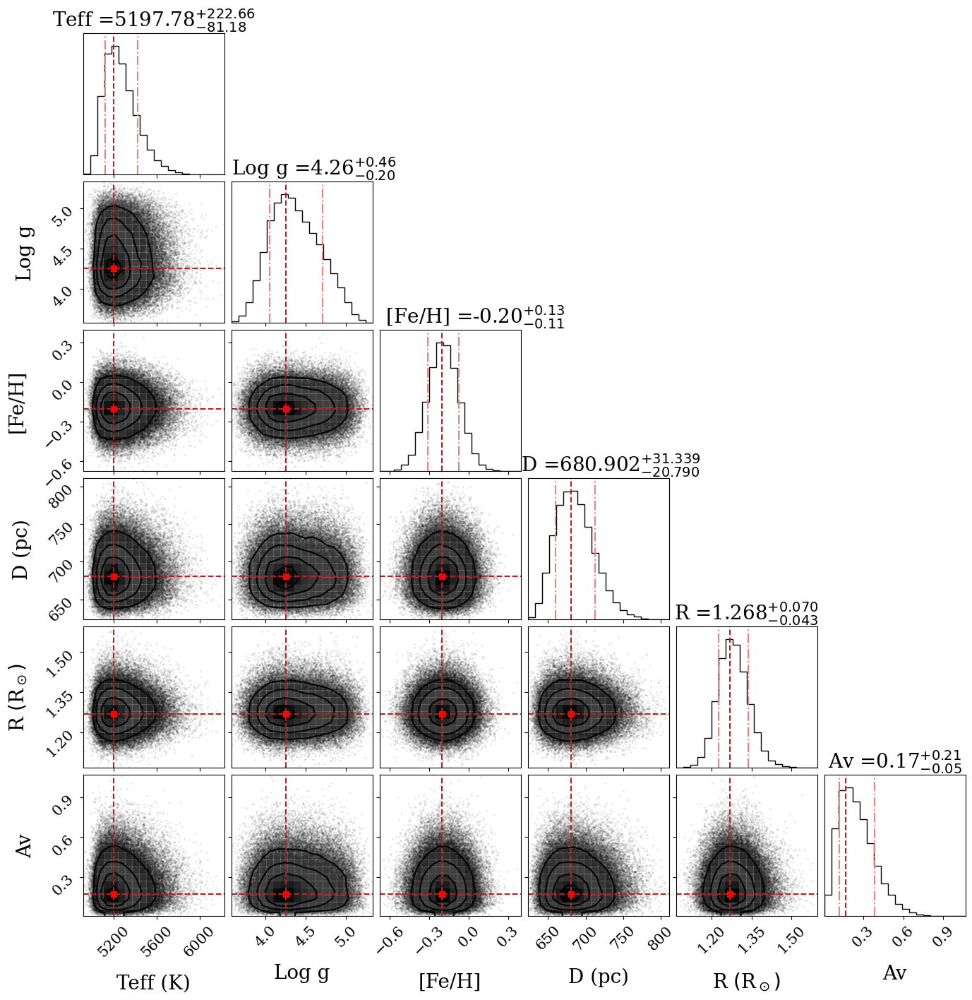

In [12]:
artist.plot_corner()

Plotting SED


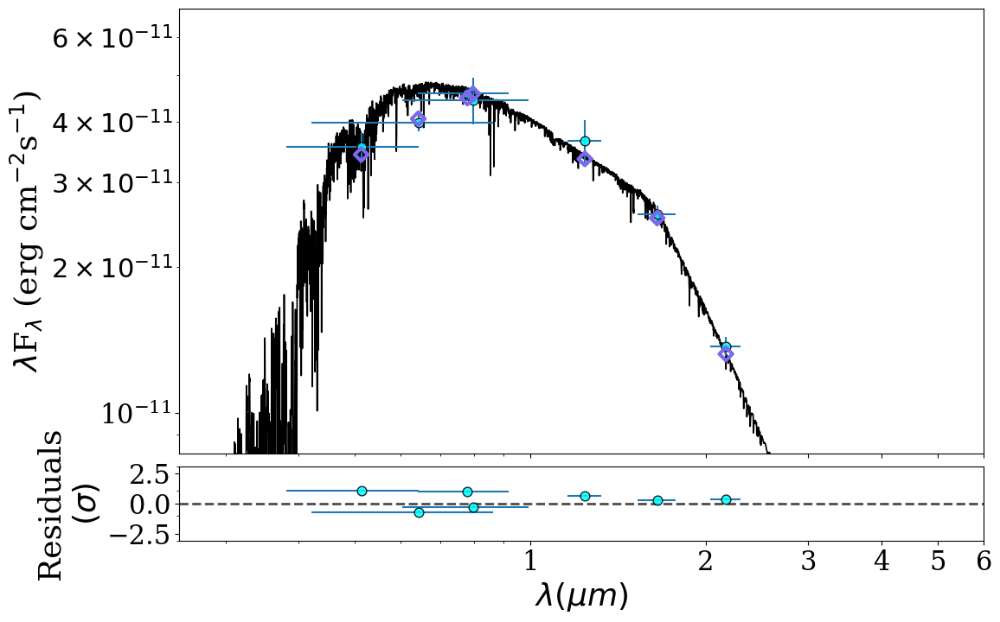

In [12]:
artist.plot_SED()
#plt.rcParams['axes.titley'] = 7.25
#plt.title('TOI4266', fontsize = 20, fontweight = 'bold')
#plt.savefig(out_folder+'/SEDPlots/SED.png')

# ----------------------------------------------
# Kinematics
# ----------------------------------------------

In [3]:
ra_3070 = 173.39915024
dec_3070 = -56.70240271
pmra_3070 = ufloat(-1.320, 0.043)
pmdec_3070 = ufloat(-0.527, 0.039)
vr_3070 = ufloat(45.35, 4.70)
d_3070 = ufloat(2361, 147)
lsr = (8.5, 13.38, 6.49)
#lsr = (0,0,0)

U_3070, V_3070, W_3070 = pyasl.gal_uvw(ra_3070, dec_3070, pmra_3070, pmdec_3070, d_3070, vr_3070, lsr)
Vtot_3070 = (ufloat(U_3070.n, U_3070.s)**2 + ufloat(V_3070.n, V_3070.s)**2 + ufloat(W_3070.n, W_3070.s)**2)**(1/2)

print("For TOI3070 - U, V, W (LSR corrected) [km/s]:  {:}, {:}, {:}".format(U_3070, V_3070, W_3070))
print("For TOI3070 - Total Vel. (LSR corrected) [km/s]:  {:}".format(Vtot_3070))

For TOI3070 - U, V, W (LSR corrected) [km/s]:  14.6+/-2.0, -34+/-4, 0.1+/-0.8
For TOI3070 - Total Vel. (LSR corrected) [km/s]:  37+/-4


In [4]:
ra_3097 = 173.07470833
dec_3097 = -47.4963944
pmra_3097 = ufloat(-16.449, 0.013)
pmdec_3097 = ufloat(-25.469, 0.014)
vr_3097 = ufloat(-31.38, 2.79)
d_3097 = ufloat(415.32, 3.17)
lsr = (8.5, 13.38, 6.49)
#lsr = (0,0,0)

U_3097, V_3097, W_3097 = pyasl.gal_uvw(ra_3097, dec_3097, pmra_3097, pmdec_3097, d_3097, vr_3097, lsr)
Vtot_3097 = (ufloat(U_3097.n, U_3097.s)**2 + ufloat(V_3097.n, V_3097.s)**2 + ufloat(W_3097.n, W_3097.s)**2)**(1/2)

print("For TOI3097 - U, V, W (LSR corrected) [km/s]:  {:}, {:}, {:}".format(U_3097, V_3097, W_3097))
print("For TOI3097 - Total Vel. (LSR corrected) [km/s]:  {:}".format(Vtot_3097))

For TOI3097 - U, V, W (LSR corrected) [km/s]:  -11.6+/-0.9, 24.6+/-2.6, -56.9+/-0.8
For TOI3097 - Total Vel. (LSR corrected) [km/s]:  63.1+/-1.2


In [5]:
ra_3124 = 178.14772736
dec_3124 = -77.4172597
pmra_3124 = ufloat(-29.768, 0.013)
pmdec_3124 = ufloat(2.477, 0.014)
vr_3124 = ufloat(12.36, 5.25)
d_3124 = ufloat(494.2909, 1.6712)
lsr = (8.5, 13.38, 6.49)
#lsr = (0,0,0)

U_3124, V_3124, W_3124 = pyasl.gal_uvw(ra_3124, dec_3124, pmra_3124, pmdec_3124, d_3124, vr_3124, lsr)
Vtot_3124 = (ufloat(U_3124.n, U_3124.s)**2 + ufloat(V_3124.n, V_3124.s)**2 + ufloat(W_3124.n, W_3124.s)**2)**(1/2)

print("For TOI3124 - U, V, W (LSR corrected) [km/s]:  {:}, {:}, {:}".format(U_3124, V_3124, W_3124))
print("For TOI3124 - Total Vel. (LSR corrected) [km/s]:  {:}".format(Vtot_3124))

For TOI3124 - U, V, W (LSR corrected) [km/s]:  -47.1+/-2.5, -29+/-4, -7.0+/-1.4
For TOI3124 - Total Vel. (LSR corrected) [km/s]:  55.6+/-3.1


In [6]:
# TOI3163

ra_3163 = 191.08889026
dec_3163 = -55.01330483
pmra_3163 = ufloat(-13.073, 0.008)
pmdec_3163 = ufloat(-1.893, 0.011)
vr_3163 = ufloat(-7.25, 2.88)
d_3163 = ufloat(554.017,3.74)
lsr = (8.5, 13.38, 6.49)
#lsr = (0,0,0)

U_3163, V_3163, W_3163 = pyasl.gal_uvw(ra_3163, dec_3163, pmra_3163, pmdec_3163, d_3163, vr_3163, lsr)
Vtot_3163 = (ufloat(U_3163.n, U_3163.s)**2 + ufloat(V_3163.n, V_3163.s)**2 + ufloat(W_3163.n, W_3163.s)**2)**(1/2)

print("For TOI3163 - U, V, W (LSR corrected) [km/s]:  {:}, {:}, {:}".format(U_3163, V_3163, W_3163))
print("For TOI3163 - Total Vel. (LSR corrected) [km/s]:  {:}".format(Vtot_3163))

For TOI3163 - U, V, W (LSR corrected) [km/s]:  -23.9+/-1.5, 0.7+/-2.4, -0.4+/-0.4
For TOI3163 - Total Vel. (LSR corrected) [km/s]:  23.9+/-1.5


In [7]:
# TOI4266
ra_4266 = 145.77866667
dec_4266 = -58.51077778
pmra_4266 = ufloat(-9.678, 0.063)
pmdec_4266 = ufloat(8.311, 0.066)
vr_4266 = ufloat(-6.88, 4.93)
d_4266 = ufloat(928.6, 26.7)
lsr = (8.5, 13.38, 6.49)
#lsr = (0,0,0)

U_4266, V_4266, W_4266 = pyasl.gal_uvw(ra_4266, dec_4266, pmra_4266, pmdec_4266, d_4266, vr_4266, lsr)
Vtot_4266 = (ufloat(U_4266.n, U_4266.s)**2 + ufloat(V_4266.n, V_4266.s)**2 + ufloat(W_4266.n, W_4266.s)**2)**(1/2)

print("For TOI4266 - U, V, W (LSR corrected) [km/s]:  {:}, {:}, {:}".format(U_4266, V_4266, W_4266))
print("For TOI4266 - Total Vel. (LSR corrected) [km/s]:  {:}".format(Vtot_4266))

For TOI4266 - U, V, W (LSR corrected) [km/s]:  -48.0+/-1.8, 10+/-5, 6.8+/-0.5
For TOI4266 - Total Vel. (LSR corrected) [km/s]:  49.5+/-2.0


In [9]:
# Probabilities from Bensby, Feltzing & Lundström (2003)

def calc_f(U, V, W, typ):
    if typ == 'thin':
        sigma_u, sigma_v, sigma_w, V_asym = 35.0, 20.0, 16.0, -15.0
    if typ == 'thick':
        sigma_u, sigma_v, sigma_w, V_asym = 67.0, 38.0, 35.0, -46.0
    if typ == 'halo':
        sigma_u, sigma_v, sigma_w, V_asym = 160.0, 90.0, 90.0, -220.0
        
    k = 1/(((2*np.pi)**3/2)*sigma_u*sigma_v*sigma_w)
    
    exp = np.exp(-(((U**2)/(2*sigma_u**2)) + (((V-V_asym)**2)/(2*sigma_v**2)) + ((W**2)/(2*sigma_w**2))))
    f = k*exp
    
    return f

In [10]:
# TOI3070
print((0.06/0.94)*calc_f(U_3070.n, V_3070.n, W_3070.n, 'thick')/calc_f(U_3070.n, V_3070.n, W_3070.n, 'thin'))
print((0.06/0.0015)*calc_f(U_3070.n, V_3070.n, W_3070.n, 'thick')/calc_f(U_3070.n, V_3070.n, W_3070.n, 'halo'))

0.01266877362378497
4601.831449769873


In [11]:
# TOI3097
print((0.06/0.94)*calc_f(U_3097.n, V_3097.n, W_3097.n, 'thick')/calc_f(U_3097.n, V_3097.n, W_3097.n, 'thin'))
print((0.06/0.0015)*calc_f(U_3097.n, V_3097.n, W_3097.n, 'thick')/calc_f(U_3097.n, V_3097.n, W_3097.n, 'halo'))

1.5668961658579565
1338.6565648552385


In [12]:
# TOI3124
print((0.06/0.94)*calc_f(U_3124.n, V_3124.n, W_3124.n, 'thick')/calc_f(U_3124.n, V_3124.n, W_3124.n, 'thin'))
print((0.06/0.0015)*calc_f(U_3124.n, V_3124.n, W_3124.n, 'thick')/calc_f(U_3124.n, V_3124.n, W_3124.n, 'halo'))

0.01915625148482484
4021.394564741043


In [13]:
# TOI3163
print((0.06/0.94)*calc_f(U_3163.n, V_3163.n, W_3163.n, 'thick')/calc_f(U_3163.n, V_3163.n, W_3163.n, 'thin'))
print((0.06/0.0015)*calc_f(U_3163.n, V_3163.n, W_3163.n, 'thick')/calc_f(U_3163.n, V_3163.n, W_3163.n, 'halo'))

0.00607950624980325
5244.899267377606


In [14]:
# TOI4266
print((0.06/0.94)*calc_f(U_4266.n, V_4266.n, W_4266.n, 'thick')/calc_f(U_4266.n, V_4266.n, W_4266.n, 'thin'))
print((0.06/0.0015)*calc_f(U_4266.n, V_4266.n, W_4266.n, 'thick')/calc_f(U_4266.n, V_4266.n, W_4266.n, 'halo'))

0.012598086511747661
4095.9528891218465


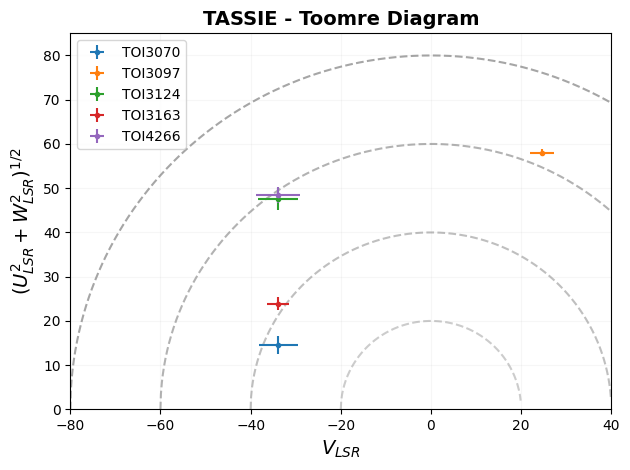

In [19]:
# Toomre diagram
plt.plot(np.arange(-20, 20.1, 0.1), np.sqrt(20**2 - np.arange(-20, 20.1, 0.1)**2), linestyle = 'dashed', color = 'gray', alpha = 0.4)
plt.plot(np.arange(-40, 40.1, 0.1), np.sqrt(40**2 - np.arange(-40, 40.1, 0.1)**2), linestyle = 'dashed', color = 'gray', alpha = 0.5)
plt.plot(np.arange(-60, 60.1, 0.1), np.sqrt(60**2 - np.arange(-60, 60.1, 0.1)**2), linestyle = 'dashed', color = 'gray', alpha = 0.6)
plt.plot(np.arange(-80, 80.1, 0.1), np.sqrt(80**2 - np.arange(-80, 80.1, 0.1)**2), linestyle = 'dashed', color = 'gray', alpha = 0.7)

plt.errorbar(V_3070.n, np.sqrt((U_3070.n**2)+(W_3070.n**2)), xerr=V_3070.s, yerr=1.96, fmt = '.', label = 'TOI3070')
plt.errorbar(V_3097.n, np.sqrt((U_3097.n**2)+(W_3097.n**2)), xerr=V_3097.s, yerr=0.78, fmt = '.', label = 'TOI3097')
plt.errorbar(V_3070.n, np.sqrt((U_3124.n**2)+(W_3124.n**2)), xerr=V_3124.s, yerr=2.50, fmt='.', label = 'TOI3124')
plt.errorbar(V_3070.n, np.sqrt((U_3163.n**2)+(W_3163.n**2)), xerr=V_3163.s, yerr=1.52, fmt = '.', label = 'TOI3163')
plt.errorbar(V_3070.n, np.sqrt((U_4266.n**2)+(W_4266.n**2)), xerr=V_4266.s, yerr=1.82, fmt = '.', label = 'TOI4266')

plt.xlim(-80, 40)
plt.ylim(0, 85)
plt.grid(alpha = 0.1)

plt.xlabel('$V_{LSR}$', fontsize=14)
plt.ylabel('$(U_{LSR}^2 + W_{LSR}^2)^{1/2}$', fontsize=14)
plt.title('TASSIE - Toomre Diagram', fontweight = 'bold', fontsize=14)
plt.legend()
plt.tight_layout()
plt.savefig('ToomreDiagram.png')

# ----------------------------------------------
# Triceratops - Statistical Test for FPP
# ----------------------------------------------

### TOI3070

In [32]:
tpf_3070_sc = lk.search_targetpixelfile('TOI3070')
tpf_3070_sc
tpf_3070 = tpf_3070_sc[0].download()
#tpf_3070.to_fits('TOI3070/TPF_TOI3070.fits', overwrite = True)

#,mission,year,author,exptime,target_name,distance
,,,,s,,arcsec
0,TESS Sector 64,2023,SPOC,120,452049244,0.0
1,TESS Sector 64,2023,TESS-SPOC,200,452049244,0.0


In [49]:
tpf_3070 = lk.TessTargetPixelFile('TOI3070/TPF_TOI3070.fits')

In [53]:
TOI3070_lc_sc = lk.search_lightcurve('TOI3070')
TOI3070_lc_sc

#,mission,year,author,exptime,target_name,distance
,,,,s,,arcsec
0,TESS Sector 64,2023,SPOC,120,452049244,0.0
1,TESS Sector 64,2023,TESS-SPOC,200,452049244,0.0
2,TESS Sector 10,2019,QLP,1800,452049244,0.0
3,TESS Sector 37,2021,QLP,600,452049244,0.0
4,TESS Sector 64,2023,QLP,200,452049244,0.0
5,TESS Sector 10,2019,GSFC-ELEANOR-LITE,1800,452049244,0.0


In [54]:
TOI3070_lc = TOI3070_lc_sc[0].download()
#TOI3070_lc = TOI3070_lc.stitch()
#TOI3070_lc.to_csv('TOI3070/TOI3070_TESS_LC.csv', overwrite = True)
TOI3070_lc_flat = TOI3070_lc.remove_outliers(4).normalize()

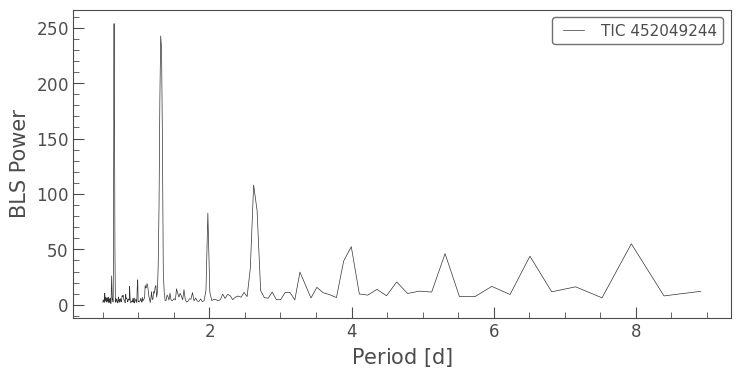

Period: 0.6578836496485664 d


In [55]:
periodogram = TOI3070_lc_flat.to_periodogram(method='bls', frequency_factor = 100)
clean_period = periodogram[np.logical_and(periodogram.period > 0.5 * u.day, periodogram.period < 10 * u.day)]
clean_period.plot()
plt.show()
period = clean_period.period_at_max_power
P_3070 = period
print('Period: {:}'.format(period))

<AxesSubplot:xlabel='Phase [JD]', ylabel='Normalized Flux'>

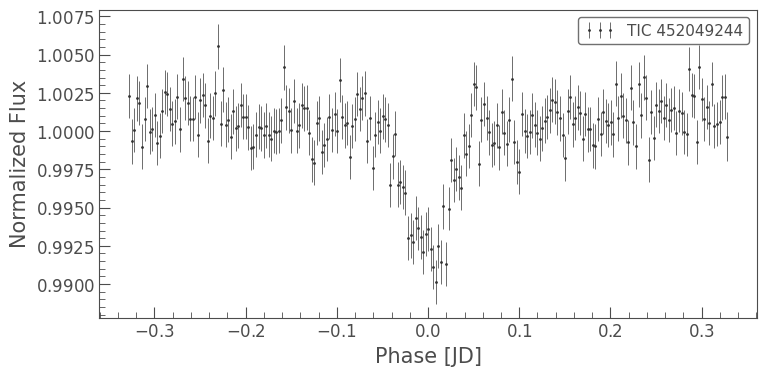

In [56]:
e_time_estimate = TOI3070_lc_flat[TOI3070_lc_flat.flux == TOI3070_lc_flat.flux.min()].time.value[0]

fold_lc = TOI3070_lc_flat.fold(period=period, epoch_time = e_time_estimate + 0.005)

bin_3070_lc = fold_lc.bin(240*u.second)

bin_3070_lc.errorbar(fmt = '.')

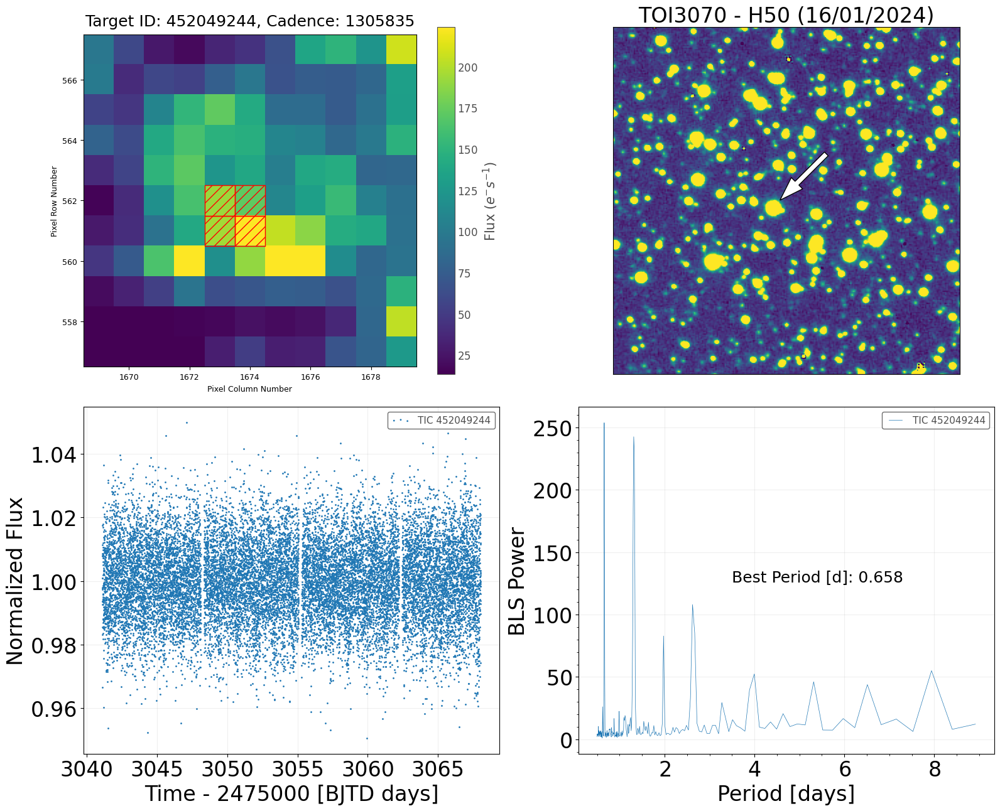

In [198]:
fig, ax = plt.subplots(2,2, figsize = (16,13))

# TPF
tpf_3070.plot(aperture_mask=tpf_3070.pipeline_mask, ax = ax[0,0])

# H50 image
ax[0,1].imshow(toi3070_rot, vmin=z1+10, vmax=z2, origin = 'lower', cmap = 'viridis')
ax[0,1].set_xlim(toi3070_cutout.data.shape[0]/2 - 10 + 130, toi3070_cutout.data.shape[0]/2 - 10 - 130)
ax[0,1].set_ylim(toi3070_cutout.data.shape[0]/2 + 5 -  130, toi3070_cutout.data.shape[0]/2 + 5 + 130)
ax[0,1].tick_params(left = False, right = False , labelleft = False , labelbottom = False, bottom = False)
ax[0,1].arrow(toi3070_cutout.data.shape[0]/2 - 40, toi3070_cutout.data.shape[0]/2 + 40, 22, -22, width = 4, color = 'white', ec = 'black')
ax[0,1].set_title('TOI3070 - H50 (16/01/2024)', fontsize = 24)

TOI3070_lc_flat[TOI3070_lc_flat.time.value > 3000].scatter(ax = ax[1,0])
ax[1,0].set_xlabel('Time - 2475000 [BJTD days]', fontsize = 24)
ax[1,0].set_ylabel('Normalized Flux', fontsize = 24)
ax[1,0].tick_params(axis='both', labelsize = 24)

# Periodogram
clean_period.plot(ax=ax[1,1])
ax[1,1].text(3.5, clean_period.max_power/2, 'Best Period [d]: ' + str(round(P_3070.value,3)), fontsize = 18)
ax[1,1].set_xlabel('Period [days]', fontsize = 24)
ax[1,1].set_ylabel('BLS Power', fontsize = 24)
ax[1,1].tick_params(axis='both', labelsize = 24)

plt.tight_layout()
ax[1,1].grid(alpha=0.2)
ax[1,0].grid(alpha=0.2)


plt.savefig('TOI3070/tpf_lc_prd_toi3070.png')

<AxesSubplot:title={'center':'Target ID: 452049244, Cadence: 1305835'}, xlabel='Pixel Column Number', ylabel='Pixel Row Number'>

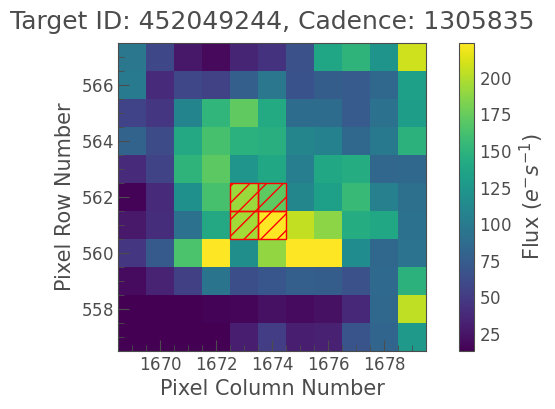

In [12]:
tpf_3070.plot(aperture_mask=tpf_3070.pipeline_mask)

In [18]:
# Triceratops
Id = 452049244
sectors = np.array([64])
ap_s64 = np.array([[1673, 562], [1673, 561], [1674, 562], [1674, 561]])
aps = [ap_s64]

target = tr.target(ID=Id, sectors=sectors, trilegal_fname='452049244_TRILEGAL.csv')

In [19]:
target.stars = target.stars[target.stars['sep (arcsec)'] < 7.0]
target.stars['Teff'][0] = 5970
target.stars['mass'][0] = 1.1
target.stars['rad'][0] = 2.0
target.calc_depths(tdepth=(7010.0/10**6), all_ap_pixels=aps)
target.stars

,ID,Tmag,Jmag,Hmag,Kmag,ra,dec,mass,rad,Teff,plx,sep (arcsec),PA (E of N),fluxratio,tdepth
0,452049244,13.3727,12.745,12.493,12.392,173.399143,-56.702400,1.10,2.000000,5970.0,0.564248,0.000,0.000,0.989775,0.007082
1,930512729,20.6270,NaN,NaN,NaN,173.401082,-56.701577,NaN,NaN,NaN,NaN,4.844,52.277,0.001222,0.000000
2,930512725,18.4789,NaN,NaN,NaN,173.400720,-56.703741,1.17,0.762691,6151.0,-0.229595,5.745,147.135,0.009004,0.778560


In [20]:
FPPs = np.zeros(10)
NFPPs = np.zeros(10)

for i in range(10):
    print('Running... Iteration {:}'.format(i+1))
    target.calc_probs(time=bin_3070_lc.time.value, flux_0=bin_3070_lc.flux.value,\
                      flux_err_0=np.mean(bin_3070_lc.flux_err.value), P_orb=float(P_3070.value), parallel=True, verbose = 0)
    
    FPPs[i] = float(target.FPP)
    NFPPs[i] = float(target.NFPP)

meanFPP = np.round(np.mean(FPPs), 4)
stdvFPP = np.round(np.std(FPPs), 4)
meanNFPP = np.round(np.mean(NFPPs), 4)
stdvNFPP = np.round(np.std(NFPPs), 4)
print("FPP =", meanFPP, "+/-", stdvFPP)
print("NFPP =", meanNFPP, "+/-", stdvNFPP)

Running... Iteration 1


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


Running... Iteration 2
Running... Iteration 3
Running... Iteration 4
Running... Iteration 5
Running... Iteration 6
Running... Iteration 7
Running... Iteration 8
Running... Iteration 9
Running... Iteration 10
FPP = 0.9905 +/- 0.0012
NFPP = 0.0 +/- 0.0


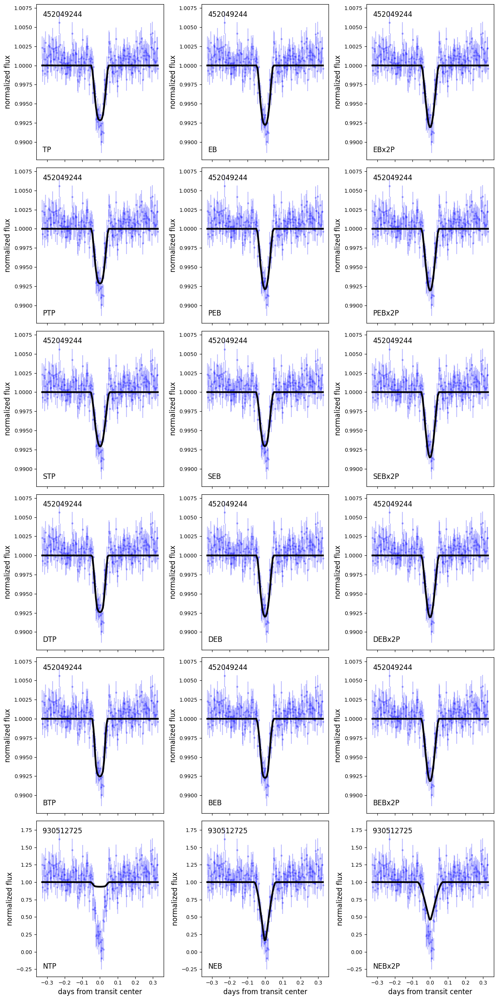

In [21]:
target.plot_fits(time=bin_3070_lc.time.value, flux_0=bin_3070_lc.flux.value, flux_err_0=np.mean(bin_3070_lc.flux_err.value))

In [22]:
target.probs.sort_values('prob', ascending=False)

,ID,scenario,M_s,R_s,P_orb,inc,b,ecc,w,R_p,M_EB,R_EB,prob
2,452049244,EBx2P,1.100000,2.000000,1.315767,63.677116,1.460513,0.003849,229.289220,0.000000,1.096212,1.214982,5.239957e-01
5,452049244,PEBx2P,1.100000,2.000000,1.315767,63.590116,1.462462,0.002973,329.983692,0.000000,1.094221,1.212342,2.017124e-01
1,452049244,EB,1.100000,2.000000,0.657884,58.323768,0.902413,0.000006,54.567222,0.000000,0.158718,0.190656,1.430792e-01
4,452049244,PEB,1.100000,2.000000,0.657884,58.201128,0.915740,0.000160,318.624958,0.000000,0.201295,0.231180,5.611491e-02
11,452049244,DEBx2P,1.100000,2.000000,1.315767,64.547449,1.405592,0.025486,183.069864,0.000000,1.064584,1.171993,4.570316e-02
10,452049244,DEB,1.100000,2.000000,0.657884,58.449097,0.905901,0.001127,197.229223,0.000000,0.185715,0.216856,1.219983e-02
0,452049244,TP,1.100000,2.000000,0.657884,56.204625,0.917513,0.014187,342.967023,19.933616,0.000000,0.000000,7.708137e-03
14,452049244,BEBx2P,0.894000,0.867366,1.315767,79.789101,1.212300,0.130779,175.561482,0.000000,0.861668,0.867366,3.258150e-03
8,452049244,SEBx2P,0.949307,1.005405,1.315767,78.305715,1.033245,0.403796,177.219468,0.000000,0.937145,0.988067,2.108751e-03
13,452049244,BEB,0.989000,1.124947,0.657884,84.583781,0.306993,0.000170,354.398746,0.000000,0.529330,0.536983,1.456491e-03


## TOI3097

In [68]:
lk.search_targetpixelfile('TOI3097')

#,mission,year,author,exptime,target_name,distance
,,,,s,,arcsec
0,TESS Sector 63,2023,SPOC,120,163262555,0.0
1,TESS Sector 64,2023,SPOC,120,163262555,0.0
2,TESS Sector 63,2023,TESS-SPOC,200,163262555,0.0
3,TESS Sector 64,2023,TESS-SPOC,200,163262555,0.0


In [69]:
#toi3097_sec63_pf = lk.search_targetpixelfile('TOI3097')[2].download()
#toi3097_sec64_pf = lk.search_targetpixelfile('TOI3097')[3].download()
#toi3097_sec63_pf.to_fits('TOI3097/TPF_TOI3097_S63.fits')
#toi3097_sec64_pf.to_fits('TOI3097/TPF_TOI3097_S64.fits')

toi3097_sec63_pf = lk.TessTargetPixelFile('TOI3097/TPF_TOI3097_S63.fits')
toi3097_sec64_pf = lk.TessTargetPixelFile('TOI3097/TPF_TOI3097_S64.fits')

In [71]:
Id = 163262555
sectors = np.array([63, 64])
ap_s63 = np.array([ [1671, 1639], [1672, 1640], [1672, 1639], [1672, 1638], [1673, 1639], [1673, 1638] ])
ap_s64 = np.array([ [575, 1718], [575, 1719], [576, 1717], [576, 1718], [576, 1719], [577, 1718], [577, 1719] ])
aps = [ap_s63, ap_s64]

target = tr.target(ID=Id, sectors=sectors)

Sector 63


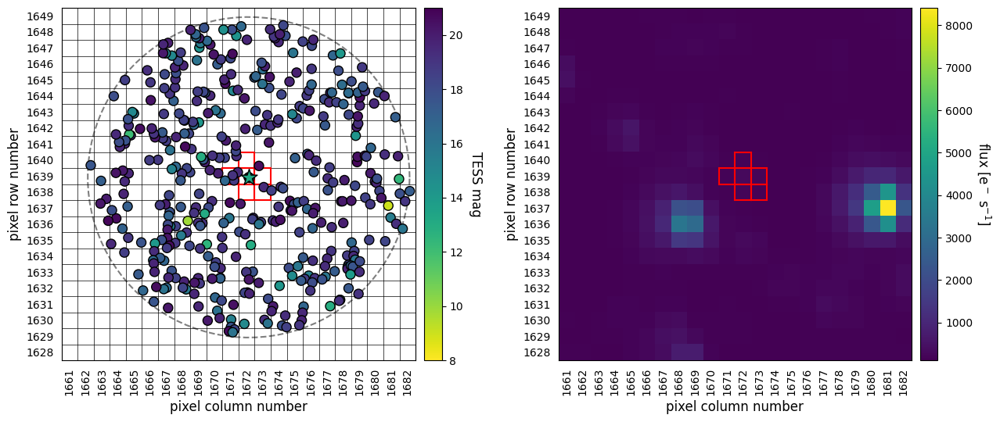

Sector 64


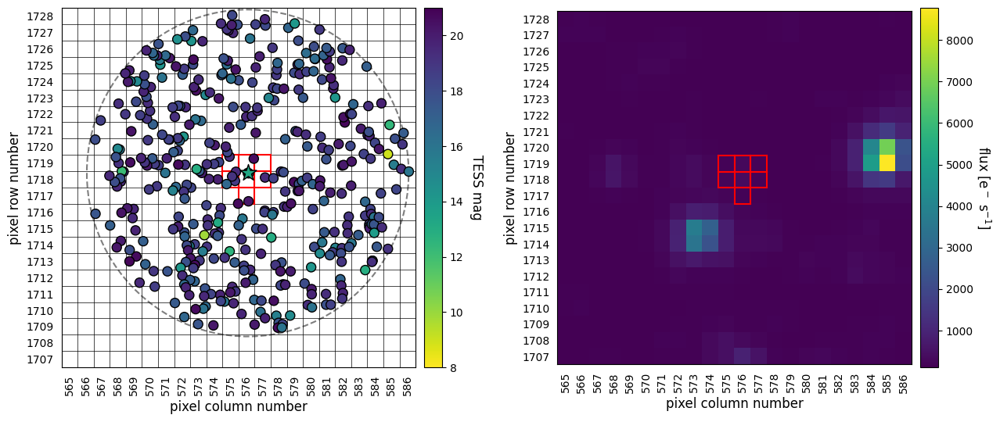

In [3]:
for i,(sector,aperture) in enumerate(zip(sectors,aps)):
    print("Sector", sector)
    target.plot_field(sector=sector, ap_pixels=aperture)

In [13]:
target.stars = target.stars.drop(0).reset_index(drop=True)
target.stars['Teff'][0] = 4802
target.stars['mass'][0] = 0.63
target.stars['rad'][0] = 0.87
target.stars['Teff'][1] = 3940
target.stars['mass'][1] = 0.27
target.stars['rad'][1] = 0.30

In [14]:
target.stars = target.stars[target.stars['sep (arcsec)'] < 4.0]

In [15]:
target.calc_depths(tdepth=(8410.0/10**6), all_ap_pixels=aps)

In [16]:
target.stars

,ID,Tmag,Jmag,Hmag,Kmag,ra,dec,mass,rad,Teff,plx,sep (arcsec),PA (E of N),fluxratio,tdepth
0,163262555,13.2045,12.126,11.668,11.557,173.074803,-47.496501,0.63,0.87,4802.0,2.36608,0.000,0.000,0.812029,0.010357
1,939962358,14.7932,NaN,NaN,NaN,173.075123,-47.496820,0.27,0.30,3940.0,2.39815,1.389,145.929,0.187971,0.044741


In [72]:
lk.search_lightcurve('TOI3097')

#,mission,year,author,exptime,target_name,distance
,,,,s,,arcsec
0,TESS Sector 63,2023,SPOC,120,163262555,0.0
1,TESS Sector 64,2023,SPOC,120,163262555,0.0
2,TESS Sector 63,2023,TESS-SPOC,200,163262555,0.0
3,TESS Sector 64,2023,TESS-SPOC,200,163262555,0.0
4,TESS Sector 10,2019,QLP,1800,163262555,0.0
5,TESS Sector 37,2021,QLP,600,163262555,0.0
6,TESS Sector 37,2021,QLP,600,939962363,0.0
7,TESS Sector 63,2023,QLP,200,163262555,0.0
8,TESS Sector 63,2023,QLP,200,939962363,0.0


In [73]:
TOI3097_lc = lk.search_lightcurve('TOI3097')[[2, 3]].download_all()
TOI3097_lc = TOI3097_lc.stitch()
#TOI3097_lc.to_csv('TOI3097/TOI3097_TESS_LC.csv')

In [74]:
TOI3097_lc_flat = TOI3097_lc.remove_outliers(4).flatten()

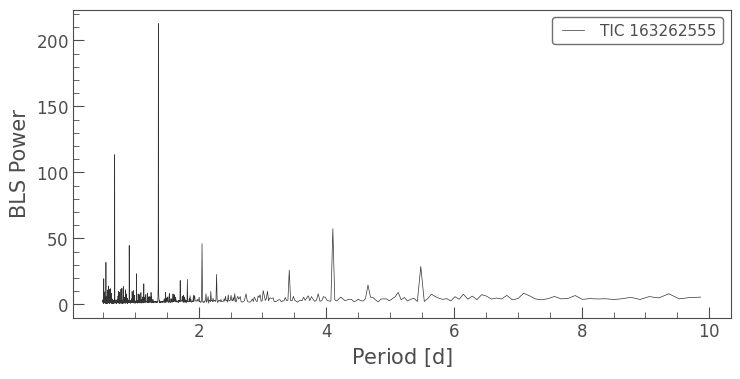

Period: 1.3688808201676068 d


In [75]:
periodogram = TOI3097_lc_flat.to_periodogram(method='bls', frequency_factor = 100)
clean_period_3097 = periodogram[np.logical_and(periodogram.period > 0.5 * u.day, periodogram.period < 10 * u.day)]
clean_period_3097.plot()
plt.show()
period = clean_period_3097.period_at_max_power
print('Period: {:}'.format(period))

In [76]:
e_time_estimate = TOI3097_lc_flat[TOI3097_lc_flat.flux == TOI3097_lc_flat.flux.min()].time.value[0]
P_3097 = period

<AxesSubplot:xlabel='Phase [JD]', ylabel='Normalized Flux'>

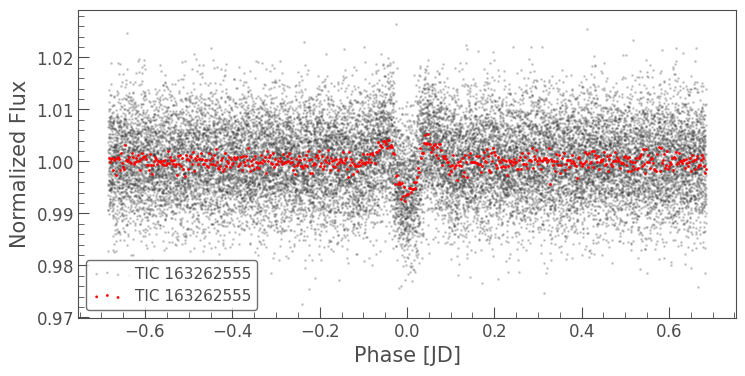

In [77]:
fold_lc = TOI3097_lc_flat.fold(period=P_3097, epoch_time = e_time_estimate + 0.24)
bin_3097_lc = fold_lc.bin(200*u.second)
ax = fold_lc.scatter(alpha = 0.2)
bin_3097_lc.scatter(ax = ax, color = 'r')

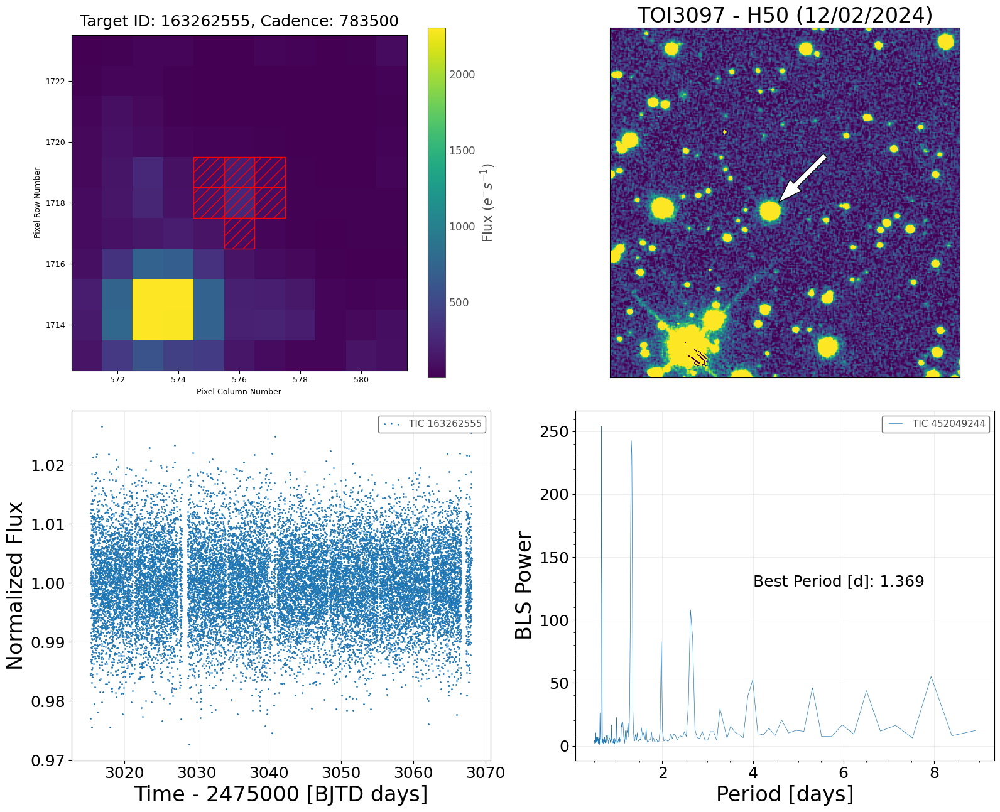

In [163]:
fig, ax = plt.subplots(2,2, figsize = (16,13))
toi3097_sec64_pf.plot(aperture_mask=toi3097_sec64_pf.pipeline_mask, ax = ax[0,0])

# H50 image
ax[0,1].imshow(toi3097_rot, vmin=z1+16, vmax=z2, origin = 'lower', cmap = 'viridis')
ax[0,1].set_xlim(toi3097_cutout.data.shape[0]/2 - 10 + 130, toi3097_cutout.data.shape[0]/2 - 10 - 130)
ax[0,1].set_ylim(toi3097_cutout.data.shape[0]/2 + 5 -  130, toi3097_cutout.data.shape[0]/2 + 5 + 130)
ax[0,1].tick_params(left = False, right = False , labelleft = False , labelbottom = False, bottom = False)
ax[0,1].arrow(toi3097_cutout.data.shape[0]/2 - 40, toi3097_cutout.data.shape[0]/2 + 40, 22, -22, width = 4, color = 'white', ec = 'black')
ax[0,1].set_title('TOI3097 - H50 (12/02/2024)', fontsize = 24)

TOI3097_lc_flat[TOI3097_lc_flat.time.value > 3000].scatter(ax = ax[1,0])
ax[1,0].set_xlabel('Time - 2475000 [BJTD days]', fontsize = 24)
ax[1,0].set_ylabel('Normalized Flux', fontsize = 24)
ax[1,0].tick_params(axis='both', labelsize = 18)

# Periodogram
clean_period.plot(ax=ax[1,1])
ax[1,1].text(4, clean_period.max_power/2, 'Best Period [d]: ' + str(round(P_3097.value,3)), fontsize = 18)
ax[1,1].set_xlabel('Period [days]', fontsize = 24)
ax[1,1].set_ylabel('BLS Power', fontsize = 24)
ax[1,1].tick_params(axis='both', labelsize = 18)

plt.tight_layout()
ax[1,1].grid(alpha=0.2)
ax[1,0].grid(alpha=0.2)

plt.savefig('TOI3097/tpf_lc_prd_toi3097.png')

In [40]:
FPPs = np.zeros(10)
NFPPs = np.zeros(10)

for i in range(10):
    print('Running... Iteration {:}'.format(i+1))
    target.calc_probs(time=bin_3097_lc.time.value, flux_0=bin_3097_lc.flux.value,\
                      flux_err_0=np.mean(bin_3097_lc.flux_err.value), P_orb=float(P_3097.value), parallel=True)
    
    FPPs[i] = float(target.FPP)
    NFPPs[i] = float(target.NFPP)

meanFPP = np.round(np.mean(FPPs), 4)
stdvFPP = np.round(np.std(FPPs), 4)
meanNFPP = np.round(np.mean(NFPPs), 4)
stdvNFPP = np.round(np.std(NFPPs), 4)
print("FPP =", meanFPP, "+/-", stdvFPP)
print("NFPP =", meanNFPP, "+/-", stdvNFPP)

Running... Iteration 1
Calculating TP scenario probabilitiey for 163262555.


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


Calculating EB and EBx2P scenario probabilities for 163262555.
Calculating PTP scenario probability for 163262555.
Calculating PEB and PEBx2P scenario probabilities for 163262555.
Calculating STP scenario probability for 163262555.
Calculating SEB and SEBx2P scenario probabilities for 163262555.
Calculating DTP scenario probability for 163262555.
Calculating DEB and DEBx2P scenario probabilities for 163262555.
Calculating BTP scenario probability for 163262555.
Calculating BEB and BEBx2P scenario probabilities for 163262555.
Calculating NTP, NEB, and NEB2xP scenario probabilities for 939962358.
Running... Iteration 2
Calculating TP scenario probabilitiey for 163262555.
Calculating EB and EBx2P scenario probabilities for 163262555.
Calculating PTP scenario probability for 163262555.
Calculating PEB and PEBx2P scenario probabilities for 163262555.
Calculating STP scenario probability for 163262555.
Calculating SEB and SEBx2P scenario probabilities for 163262555.
Calculating DTP scenario 

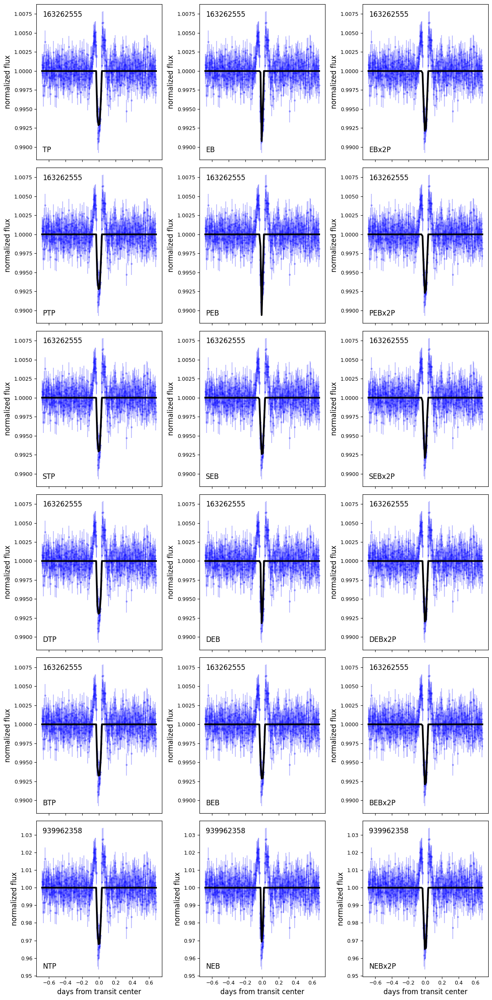

In [41]:
target.plot_fits(time=bin_3097_lc.time.value, flux_0=bin_3097_lc.flux.value, flux_err_0=np.mean(bin_3097_lc.flux_err.value))

In [42]:
target.probs.sort_values('prob', ascending=False)

,ID,scenario,M_s,R_s,P_orb,inc,b,ecc,w,R_p,M_EB,R_EB,prob
0,163262555,TP,0.630000,0.870000,1.368881,80.522045,0.670442,0.204030,85.314980,8.192065,0.000000,0.000000,7.338113e-01
3,163262555,PTP,0.630000,0.870000,1.368881,80.288745,0.702583,0.193314,69.884565,9.007291,0.000000,0.000000,1.580566e-01
9,163262555,DTP,0.630000,0.870000,1.368881,80.697819,0.663386,0.199934,78.405924,8.297136,0.000000,0.000000,5.593341e-02
6,163262555,STP,0.598278,0.595375,1.368881,85.045361,0.424238,0.401638,140.825309,8.475520,0.000000,0.000000,3.152332e-02
5,163262555,PEBx2P,0.630000,0.870000,2.737762,82.239123,1.296696,0.119038,157.783230,0.000000,0.613209,0.599909,6.139920e-03
2,163262555,EBx2P,0.630000,0.870000,2.737762,82.593413,1.255222,0.168361,173.185932,0.000000,0.628905,0.600171,4.599175e-03
12,163262555,BTP,0.935000,0.910835,1.368881,81.973467,0.641728,0.193060,59.743339,14.594941,0.000000,0.000000,3.690178e-03
13,163262555,BEB,0.655000,0.578302,1.368881,89.342467,0.083236,0.133312,85.419789,0.000000,0.155801,0.187661,1.760716e-03
15,939962358,NTP,0.270000,0.300000,1.368881,87.994342,0.378288,0.380765,197.706970,5.585652,0.000000,0.000000,1.642349e-03
7,163262555,SEB,0.167170,0.199126,1.368881,89.757884,0.044044,0.528169,168.618320,0.000000,0.062771,0.100000,1.076328e-03


In [43]:
target.FPP

0.05219869064383309

In [44]:
target.NFPP

0.0018123541449246651

## TOI3124

In [4]:
toi3124_pf_sc = lk.search_targetpixelfile('TOI3124')
toi3124_lc_sc = lk.search_lightcurve('TOI3124')

In [5]:
toi3124_pf_sc

#,mission,year,author,exptime,target_name,distance
,,,,s,,arcsec
0,TESS Sector 64,2023,SPOC,120,454918388,0.0
1,TESS Sector 65,2023,SPOC,120,454918388,0.0
2,TESS Sector 66,2023,SPOC,120,454918388,0.0
3,TESS Sector 11,2019,TESS-SPOC,1800,454918388,0.0
4,TESS Sector 38,2021,TESS-SPOC,600,454918388,0.0
5,TESS Sector 64,2023,TESS-SPOC,200,454918388,0.0
6,TESS Sector 65,2023,TESS-SPOC,200,454918388,0.0
7,TESS Sector 66,2023,TESS-SPOC,200,454918388,0.0


In [6]:
toi3124_sec64_pf = toi3124_pf_sc[0].download()
toi3124_sec65_pf = toi3124_pf_sc[1].download()
toi3124_sec66_pf = toi3124_pf_sc[2].download()
#TOI3124_lc = toi3124_lc_sc[0:3].download_all()
TOI3124_lc = toi3124_lc_sc[0].download()

In [7]:
#TOI3124_lc = TOI3124_lc.stitch()

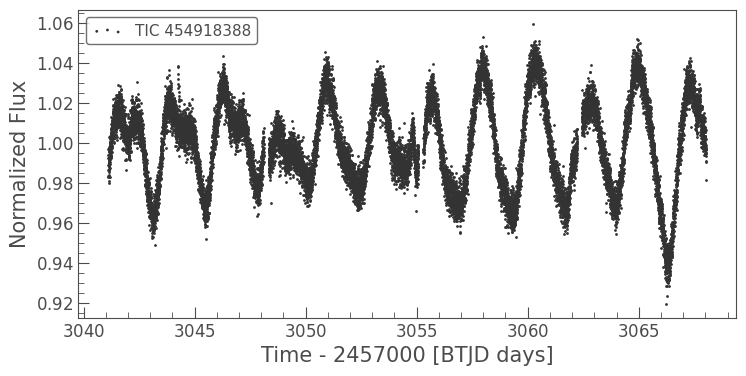

In [8]:
# Stellar rotation
TOI3124_lc_norm = TOI3124_lc.normalize().remove_outliers(4)

TOI3124_lc_norm.scatter()
plt.show()

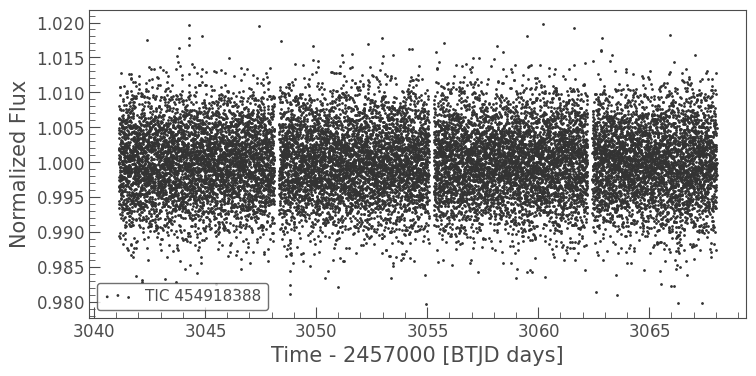

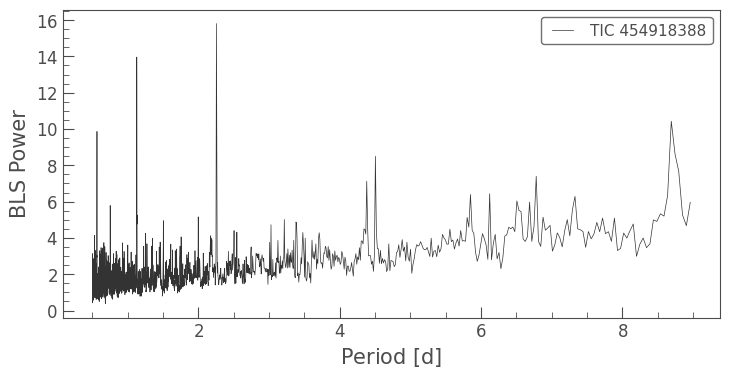

Period: 2.2545258501504186 d


In [9]:
TOI3124_lc_flat = TOI3124_lc_norm.flatten().remove_outliers(4)
TOI3124_lc_flat.scatter()
periodogram = TOI3124_lc_flat.to_periodogram(method='bls')
clean_period_3124 = periodogram[periodogram.period > 0.5 * u.day]
clean_period_3124.plot()
plt.show()
P_3124 = clean_period_3124.period_at_max_power
print('Period: {:}'.format(P_3124))

<AxesSubplot:xlabel='Phase [JD]', ylabel='Normalized Flux'>

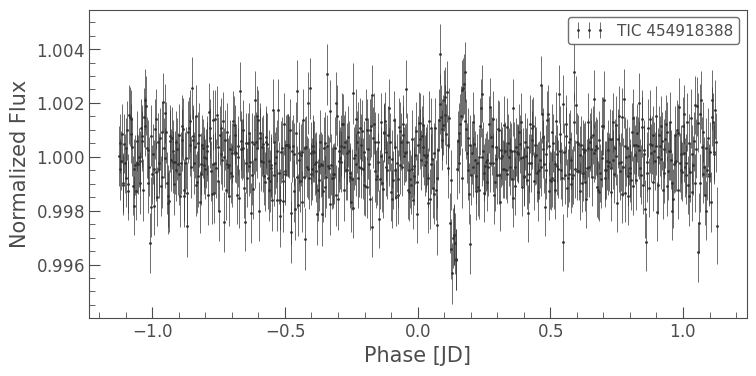

In [10]:
e_estimate = TOI3124_lc_flat.time[TOI3124_lc_flat.flux == TOI3124_lc_flat.flux.min()]
bin_3124_lc = TOI3124_lc_flat.fold(P_3124, epoch_time=e_estimate + 0.5).bin(240*u.second)
bin_3124_lc.errorbar(fmt = '.')

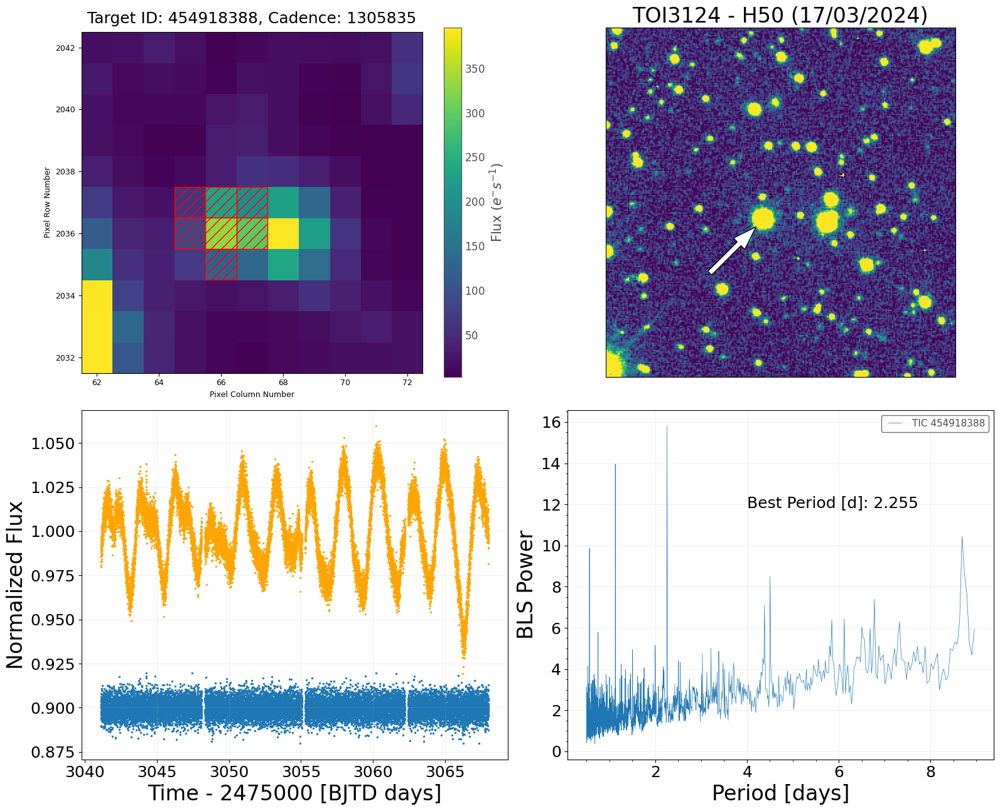

In [13]:
fig, ax = plt.subplots(2,2, figsize = (16,13))
toi3124_sec64_pf.plot(aperture_mask=toi3124_sec64_pf.pipeline_mask, ax = ax[0,0])

# H50 image
ax[0,1].imshow(toi3124_rot, vmin=z1+39, vmax=z2, origin = 'lower', cmap = 'viridis')
ax[0,1].set_xlim(toi3124_cutout.data.shape[0]/2 + 13 - 131, toi3124_cutout.data.shape[0]/2 + 13  + 131)
ax[0,1].set_ylim(toi3124_cutout.data.shape[0]/2 - 13 + 131, toi3124_cutout.data.shape[0]/2 - 13  - 131)
ax[0,1].tick_params(left = False, right = False , labelleft = False , labelbottom = False, bottom = False)
ax[0,1].arrow(toi3124_cutout.data.shape[0]/2 - 40, toi3124_cutout.data.shape[0]/2 + 40, 22, -22, width = 4, color = 'white', ec = 'black')
ax[0,1].set_title('TOI3124 - H50 (17/03/2024)', fontsize = 24)

ax[1,0].scatter(TOI3124_lc_flat.time.value, TOI3124_lc_flat.flux - 0.1, s=2)
ax[1,0].scatter(TOI3124_lc_norm.time.value, TOI3124_lc_norm.flux, color = 'orange', s=2)
ax[1,0].set_xlabel('Time - 2475000 [BJTD days]', fontsize = 24)
ax[1,0].set_ylabel('Normalized Flux', fontsize = 24)
ax[1,0].tick_params(axis='both', labelsize = 18)

# Periodogram
clean_period_3124.plot(ax=ax[1,1])
ax[1,1].text(4, 3*clean_period_3124.max_power/4, 'Best Period [d]: ' + str(round(P_3124.value,3)), fontsize = 18)
ax[1,1].set_xlabel('Period [days]', fontsize = 24)
ax[1,1].set_ylabel('BLS Power', fontsize = 24)
ax[1,1].tick_params(axis='both', labelsize = 18)

plt.tight_layout()
ax[1,1].grid(alpha=0.2)
ax[1,0].grid(alpha=0.2)

plt.savefig('TOI3124/tpf_lc_prd_toi3124.png')

In [45]:
Id = 454918388
mask_pixs_s64 = np.where(toi3124_sec64_pf.pipeline_mask == True)
mask_pixs_s65 = np.where(toi3124_sec65_pf.pipeline_mask == True)
mask_pixs_s66 = np.where(toi3124_sec66_pf.pipeline_mask == True)
sectors = np.array([64, 64, 66])
ap_s64 = np.array(list(zip(mask_pixs_s64[0] + toi3124_sec64_pf.column, mask_pixs_s64[1] + toi3124_sec64_pf.row)))
ap_s65 = np.array(list(zip(mask_pixs_s65[0] + toi3124_sec65_pf.column, mask_pixs_s65[1] + toi3124_sec65_pf.row)))
ap_s66 = np.array(list(zip(mask_pixs_s66[0] + toi3124_sec65_pf.column, mask_pixs_s66[1] + toi3124_sec66_pf.row)))
aps = [ap_s64, ap_s65, ap_s66]

target = tr.target(ID=Id, sectors=sectors)

In [47]:
target.calc_depths(tdepth = (5980.0/10**6), all_ap_pixels=aps)
target.stars

,ID,Tmag,Jmag,Hmag,Kmag,ra,dec,mass,rad,Teff,plx,sep (arcsec),PA (E of N),fluxratio,tdepth
0,454918388,12.6177,11.788,11.409,11.300,178.147727,-77.417260,0.98,1.252440,5567.0,2.025480,0.000,0.000,NaN,NaN
1,904372958,18.0479,NaN,NaN,NaN,178.136007,-77.419882,NaN,NaN,5866.0,0.332026,13.174,224.230,NaN,NaN
2,454918387,16.9042,16.107,16.222,15.599,178.166565,-77.417082,1.17,1.116080,6154.0,0.229716,14.788,87.525,NaN,NaN
3,904372960,19.2452,NaN,NaN,NaN,178.163313,-77.420139,NaN,NaN,3682.0,2.773110,16.027,130.313,NaN,NaN
4,904372964,17.7233,NaN,NaN,NaN,178.171390,-77.413680,1.08,0.897251,5940.0,0.101796,22.596,55.239,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
445,904373076,20.3645,NaN,NaN,NaN,178.404758,-77.415342,NaN,NaN,NaN,NaN,201.712,88.164,NaN,NaN
446,904373277,18.8091,NaN,NaN,NaN,178.135260,-77.361228,0.80,0.541642,4902.0,0.191759,201.950,357.213,NaN,NaN
447,904372869,18.5646,NaN,NaN,NaN,178.164221,-77.473260,NaN,NaN,3699.0,1.245690,202.014,176.345,NaN,NaN
448,904373442,19.5470,NaN,NaN,NaN,177.890025,-77.418599,NaN,NaN,4410.0,0.239123,202.151,268.507,NaN,NaN


In [48]:
target.stars = target.stars[target.stars['sep (arcsec)'] < 10]
target.calc_depths(tdepth = (5980.0/10**6), all_ap_pixels=aps)

In [49]:
target.stars['fluxratio'][0] = 1.0
target.stars['tdepth'][0] = (5980.0/10**6)

In [52]:
FPPs = np.zeros(10)
NFPPs = np.zeros(10)

for i in range(10):
    print('Running... Iteration {:}'.format(i+1))
    target.calc_probs(time=bin_3124_lc.time.value, flux_0=bin_3124_lc.flux.value,\
                      flux_err_0=np.mean(bin_3124_lc.flux_err.value), P_orb=float(P_3124.value), parallel=True, verbose = 0)
    
    FPPs[i] = float(target.FPP)
    NFPPs[i] = float(target.NFPP)

meanFPP = np.round(np.mean(FPPs), 4)
stdvFPP = np.round(np.std(FPPs), 4)
meanNFPP = np.round(np.mean(NFPPs), 4)
stdvNFPP = np.round(np.std(NFPPs), 4)
print("FPP =", meanFPP, "+/-", stdvFPP)
print("NFPP =", meanNFPP, "+/-", stdvNFPP)

Running... Iteration 1
Running... Iteration 2
Running... Iteration 3
Running... Iteration 4
Running... Iteration 5
Running... Iteration 6
Running... Iteration 7
Running... Iteration 8
Running... Iteration 9
Running... Iteration 10
FPP = 0.2678 +/- 0.0978
NFPP = 0.0 +/- 0.0


In [53]:
target.probs.sort_values('prob', ascending=False)

,ID,scenario,M_s,R_s,P_orb,inc,b,ecc,w,R_p,M_EB,R_EB,prob
0,454918388,TP,0.980000,1.252440,2.254772,58.504698,0.936333,0.731723,41.786511,8.532042,0.000000,0.000000,5.485701e-01
1,454918388,EB,0.980000,1.252440,2.254772,68.441151,1.606779,0.436064,40.927319,0.000000,0.754508,0.784502,9.304484e-02
3,454918388,PTP,0.980000,1.252440,2.254772,69.280757,0.976057,0.567244,46.406315,14.906639,0.000000,0.000000,7.630012e-02
7,454918388,SEB,0.617961,0.600505,2.254772,76.623372,0.359530,0.856039,93.850445,0.000000,0.098737,0.118176,6.303660e-02
4,454918388,PEB,0.980000,1.252440,2.254772,71.471847,1.580498,0.339295,48.874557,0.000000,0.842537,0.869409,5.113057e-02
6,454918388,STP,0.964221,1.026972,2.254772,71.658570,0.785049,0.654841,65.053703,13.924887,0.000000,0.000000,4.852916e-02
9,454918388,DTP,0.980000,1.252440,2.254772,72.367012,0.992387,0.489406,42.743109,10.780384,0.000000,0.000000,4.109854e-02
8,454918388,SEBx2P,0.765875,0.795108,4.509543,77.451863,1.743472,0.556154,50.646690,0.000000,0.755386,0.785324,3.916605e-02
10,454918388,DEB,0.980000,1.252440,2.254772,70.032820,1.608903,0.385892,43.327059,0.000000,0.799783,0.826820,2.987967e-02
14,454918388,BEBx2P,0.656000,0.588147,4.509543,67.834563,1.051141,0.876626,62.294283,0.000000,0.654613,0.588147,7.783674e-03


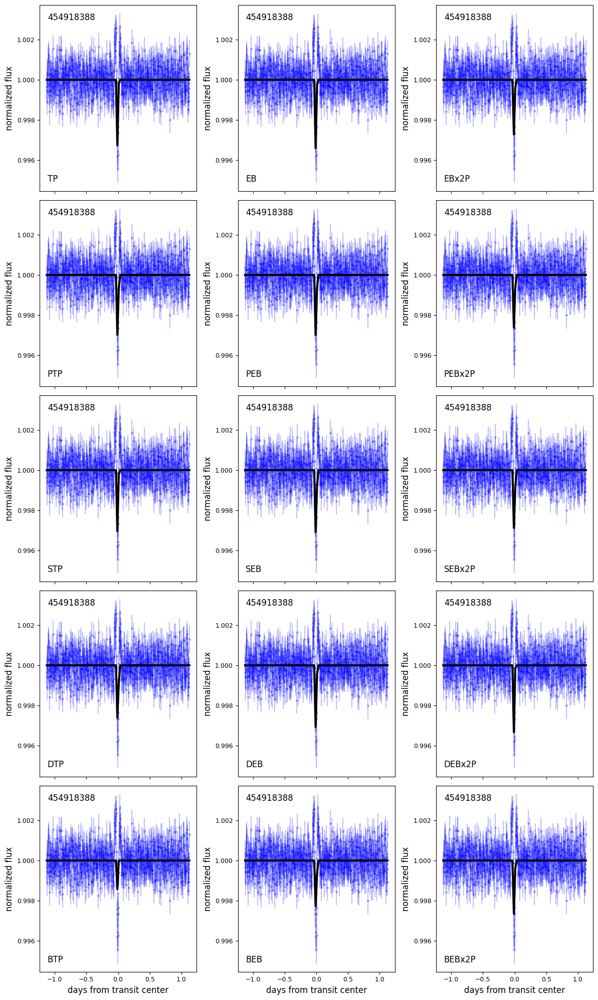

In [59]:
target.plot_fits(time=bin_3124_lc.time.value, flux_0=bin_3124_lc.flux.value, flux_err_0=np.mean(bin_3124_lc.flux_err.value))

## TOI3163

In [148]:
lk.search_targetpixelfile('TOI3163')

#,mission,year,author,exptime,target_name,distance
,,,,s,,arcsec
0,TESS Sector 64,2023,SPOC,120,425316308,0.0
1,TESS Sector 64,2023,TESS-SPOC,200,425316308,0.0


In [149]:
toi3163_sec64_pf = lk.search_targetpixelfile('TOI3163')[0].download()

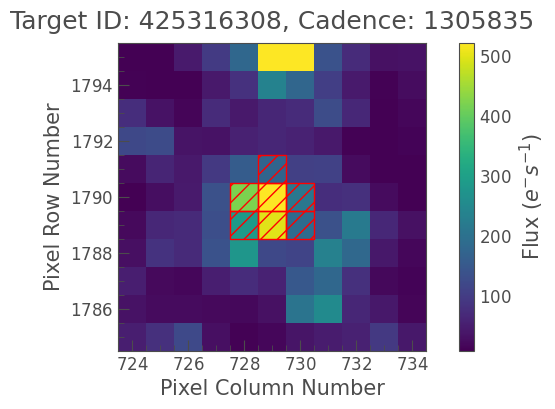

In [150]:
toi3163_sec64_pf.plot(aperture_mask=toi3163_sec64_pf.pipeline_mask)

plt.show()

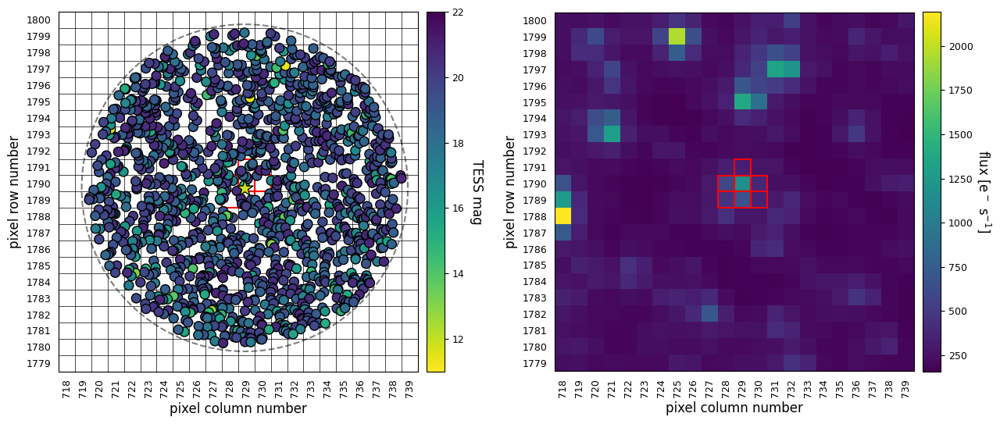

,ID,Tmag,Jmag,Hmag,Kmag,ra,dec,mass,rad,Teff,plx,sep (arcsec),PA (E of N)
0,425316308,11.8232,11.278,11.032,10.959,191.088890,-55.013304,1.46,1.597410,6782.0,1.719130,0.000,0.000
1,990196865,14.7832,NaN,NaN,NaN,191.089468,-55.012380,NaN,NaN,NaN,1.572950,3.537,19.741
2,990196859,20.6356,NaN,NaN,NaN,191.083623,-55.012963,NaN,NaN,NaN,NaN,10.942,276.440
3,990196861,19.7242,NaN,NaN,NaN,191.093069,-55.010998,NaN,NaN,NaN,0.415008,11.974,46.103
4,990196864,20.7519,NaN,NaN,NaN,191.083556,-55.015962,NaN,NaN,NaN,NaN,14.586,229.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1329,990196745,18.7392,NaN,NaN,NaN,191.010396,-55.046810,0.96,0.613238,5486.0,0.133618,201.940,233.291
1330,990196252,20.8465,NaN,NaN,NaN,191.031002,-55.058548,NaN,NaN,NaN,NaN,201.968,216.226
1331,990190094,20.7591,NaN,NaN,NaN,191.143644,-55.059835,NaN,NaN,NaN,NaN,202.037,146.029
1332,990189837,19.1579,NaN,NaN,NaN,191.114923,-55.067515,NaN,NaN,6108.0,0.721609,202.412,164.625


In [7]:
Id = 425316308
sectors = np.array([64])
aps = np.array([ [728, 1789], [728, 1790], [729, 1789], [729, 1790], [729, 1791], [730, 1789], [730, 1790] ])

target = tr.target(ID=Id, sectors=sectors)

target.plot_field(sector=64, ap_pixels=aps)

target.stars

In [22]:
target.stars['Teff'][0] = 6501.0
target.stars['mass'][0] = 1.29
target.stars['rad'][0] = 1.56
target.stars['Teff'][1] = 4701.0
target.stars['mass'][1] = 0.81
target.stars['rad'][1] = 0.69

target.stars = target.stars[target.stars['sep (arcsec)'] < 10.0]

In [23]:
target.calc_depths(tdepth=(8540.0/10**6), all_ap_pixels=[aps])

In [24]:
target.stars

,ID,Tmag,Jmag,Hmag,Kmag,ra,dec,mass,rad,Teff,plx,sep (arcsec),PA (E of N),fluxratio,tdepth
0,425316308,11.8232,11.278,11.032,10.959,191.088890,-55.013304,1.29,1.56,6501.0,1.71913,0.000,0.000,0.939487,0.009090
1,990196865,14.7832,NaN,NaN,NaN,191.089468,-55.012380,0.81,0.69,4701.0,1.57295,3.537,19.741,0.060513,0.141127


In [153]:
TOI3163_lc_s64 = lk.search_lightcurve('TOI3163')[0].download()
TOI3163_lc_s64_norm = TOI3163_lc_s64.normalize().remove_outliers(4)

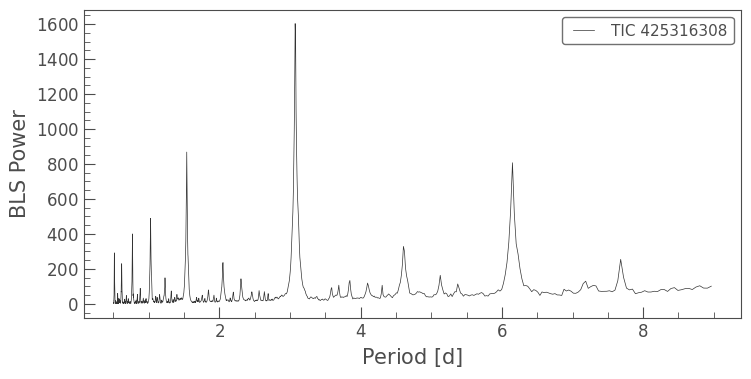

Period: 3.0723784455109096 d


In [154]:
periodogram = TOI3163_lc_s64_norm.to_periodogram(method='bls')
clean_period_3163 = periodogram[periodogram.period > 0.5 * u.day]
clean_period_3163.plot()
plt.show()
period = clean_period_3163.period_at_max_power
print('Period: {:}'.format(period))

In [155]:
P_3163 = period
e_time_estimate = TOI3163_lc_s64_norm[TOI3163_lc_s64_norm.flux == TOI3163_lc_s64_norm.flux.min()].time.value[0]

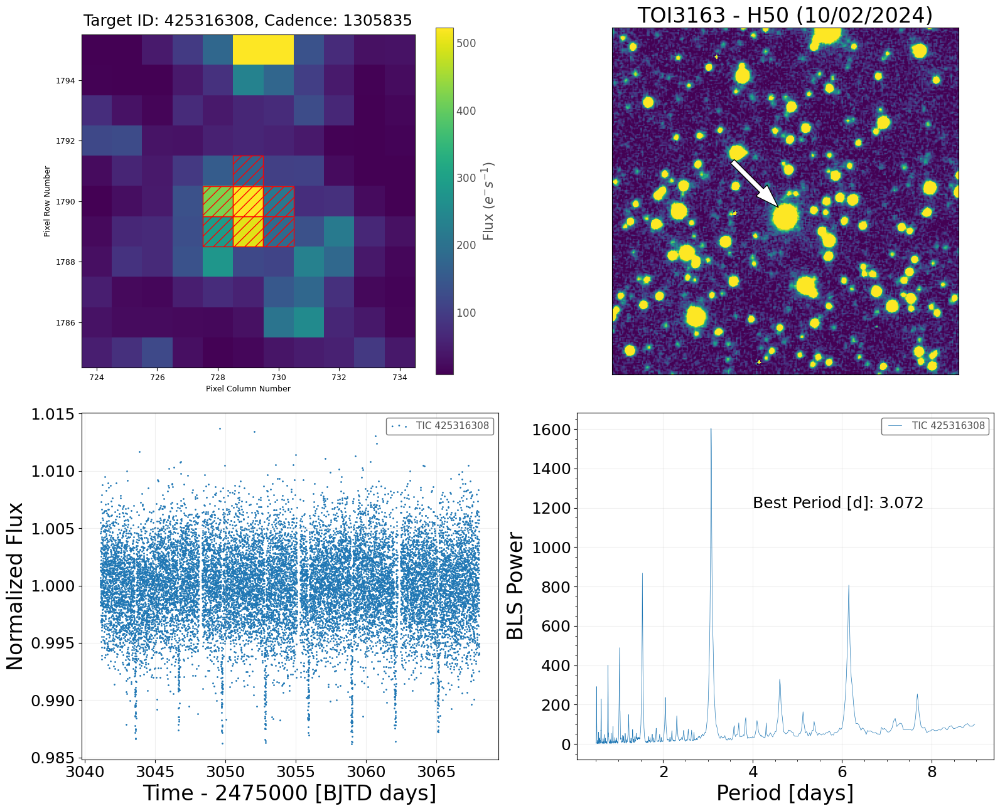

In [166]:
toi3163_im = fits.getdata('TOI3163/Nightly_Summaries/TOI3163_Stack_10022024.fits')
toi3163_header = fits.getheader('TOI3163/Nightly_Summaries/TOI3163_Stack_10022024.fits')

toi3163_cutout = Cutout2D(toi3163_im, (995,899), size = 500, wcs = WCS(toi3163_header))
toi3163_rot = rotate(toi3163_cutout.data, angle = 45, reshape=False)
z1,z2 = z.get_limits(toi3163_im)

fig, ax = plt.subplots(2,2, figsize = (16,13))
toi3163_sec64_pf.plot(aperture_mask=toi3163_sec64_pf.pipeline_mask, ax = ax[0,0])

# H50 image
ax[0,1].imshow(toi3163_rot, vmin=z1+19, vmax=z2, origin = 'lower', cmap = 'viridis')
ax[0,1].set_xlim(toi3163_cutout.data.shape[0]/2 - 131, toi3163_cutout.data.shape[0]/2 + 131)
ax[0,1].set_ylim(toi3163_cutout.data.shape[0]/2 + 10 - 131, toi3163_cutout.data.shape[0]/2 + 10 + 131)
ax[0,1].tick_params(left = False, right = False , labelleft = False , labelbottom = False, bottom = False)
ax[0,1].arrow(toi3163_cutout.data.shape[0]/2 - 40, toi3163_cutout.data.shape[0]/2 + 40, 22, -22, width = 4, color = 'white', ec = 'black')
ax[0,1].set_title('TOI3163 - H50 (10/02/2024)', fontsize = 24)

TOI3163_lc_s64_norm[TOI3163_lc_s64_norm.time.value > 3000].scatter(ax = ax[1,0])
ax[1,0].set_xlabel('Time - 2475000 [BJTD days]', fontsize = 24)
ax[1,0].set_ylabel('Normalized Flux', fontsize = 24)
ax[1,0].tick_params(axis='both', labelsize = 18)

# Periodogram
clean_period_3163.plot(ax=ax[1,1])
ax[1,1].text(4, 3*clean_period_3163.max_power/4, 'Best Period [d]: ' + str(round(P_3163.value,3)), fontsize = 18)
ax[1,1].set_xlabel('Period [days]', fontsize = 24)
ax[1,1].set_ylabel('BLS Power', fontsize = 24)
ax[1,1].tick_params(axis='both', labelsize = 18)

plt.tight_layout()
ax[1,1].grid(alpha=0.2)
ax[1,0].grid(alpha=0.2)

plt.savefig('TOI3163/tpf_lc_prd_toi3163.png')

<AxesSubplot:xlabel='Phase [JD]', ylabel='Normalized Flux'>

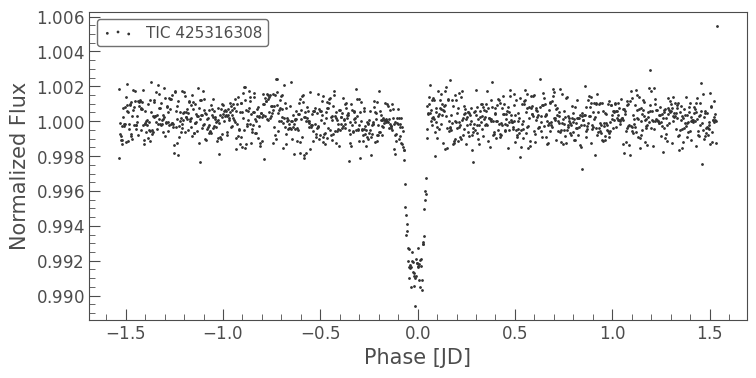

In [20]:
fold_lc = TOI3163_lc_s64_norm.fold(period=P_3163, epoch_time = e_time_estimate+0.005)

bin_3163_lc = fold_lc.bin(200*u.second)

bin_3163_lc.scatter()

In [26]:
FPPs = np.zeros(10)
NFPPs = np.zeros(10)

for i in range(10):
    print('Running... Iteration {:}'.format(i+1))
    target.calc_probs(time=bin_3163_lc.time.value, flux_0=bin_3163_lc.flux.value, flux_err_0=np.mean(bin_3163_lc.flux_err.value), P_orb=float(P_3163.value), parallel=True)
    
    FPPs[i] = float(target.FPP)
    NFPPs[i] = float(target.NFPP)

meanFPP = np.round(np.mean(FPPs), 4)
stdvFPP = np.round(np.std(FPPs), 4)
meanNFPP = np.round(np.mean(NFPPs), 4)
stdvNFPP = np.round(np.std(NFPPs), 4)
print("FPP =", meanFPP, "+/-", stdvFPP)
print("NFPP =", meanNFPP, "+/-", stdvNFPP)


Running... Iteration 1
Calculating TP scenario probabilitiey for 425316308.
Calculating EB and EBx2P scenario probabilities for 425316308.
Calculating PTP scenario probability for 425316308.
Calculating PEB and PEBx2P scenario probabilities for 425316308.
Calculating STP scenario probability for 425316308.
Calculating SEB and SEBx2P scenario probabilities for 425316308.
Calculating DTP scenario probability for 425316308.
Calculating DEB and DEBx2P scenario probabilities for 425316308.
Calculating BTP scenario probability for 425316308.
Calculating BEB and BEBx2P scenario probabilities for 425316308.
Calculating NTP, NEB, and NEB2xP scenario probabilities for 990196865.
Running... Iteration 2
Calculating TP scenario probabilitiey for 425316308.
Calculating EB and EBx2P scenario probabilities for 425316308.
Calculating PTP scenario probability for 425316308.
Calculating PEB and PEBx2P scenario probabilities for 425316308.
Calculating STP scenario probability for 425316308.
Calculating SE

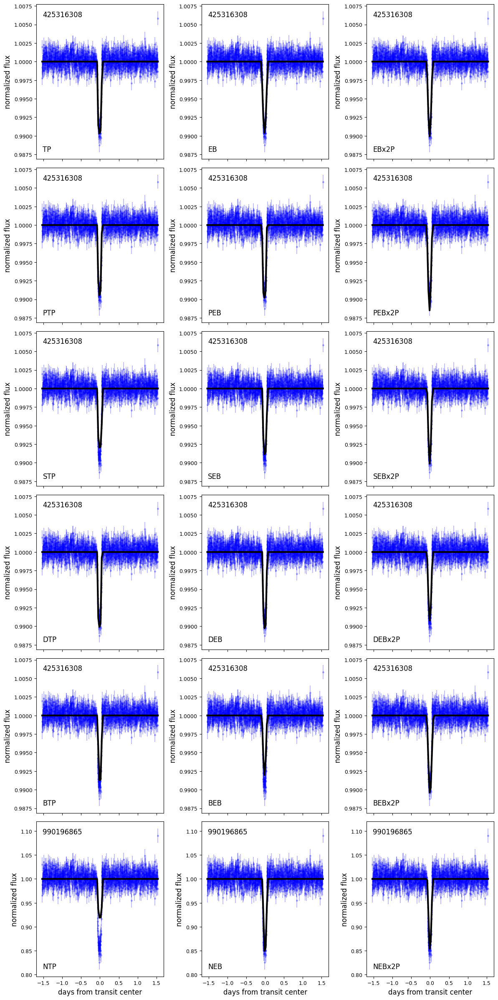

In [27]:
target.plot_fits(time=bin_3163_lc.time.value, flux_0=bin_3163_lc.flux.value, flux_err_0=np.mean(bin_3163_lc.flux_err.value))

In [28]:
target.probs.sort_values('prob', ascending=False)

,ID,scenario,M_s,R_s,P_orb,inc,b,ecc,w,R_p,M_EB,R_EB,prob
0,425316308,TP,1.290000,1.560000,3.072378,81.456296,0.364775,0.622303,118.132846,16.880089,0.000000,0.000000,7.096296e-01
9,425316308,DTP,1.290000,1.560000,3.072378,79.375576,0.339414,0.712470,112.138857,17.326607,0.000000,0.000000,1.201051e-01
4,425316308,PEB,1.290000,1.560000,3.072378,78.150868,0.255613,0.822246,123.399829,0.000000,0.179294,0.210827,1.089160e-01
3,425316308,PTP,1.290000,1.560000,3.072378,80.711142,0.365792,0.653425,119.392898,18.303178,0.000000,0.000000,6.134637e-02
2,425316308,EBx2P,1.290000,1.560000,6.144757,82.999018,0.826547,0.508981,135.966964,0.000000,1.276172,1.424191,2.956634e-06
5,425316308,PEBx2P,1.290000,1.560000,6.144757,82.333271,0.784374,0.560780,128.663324,0.000000,1.240114,1.385899,1.456583e-16
10,425316308,DEB,1.290000,1.560000,3.072378,82.093620,0.404985,0.559201,117.392584,0.000000,0.131690,0.161151,3.945964e-17
1,425316308,EB,1.290000,1.560000,3.072378,83.808765,0.276430,0.703886,156.207991,0.000000,0.207587,0.236894,1.285579e-17
7,425316308,SEB,1.260187,1.407369,3.072378,83.654023,0.352334,0.580470,124.500173,0.000000,0.162379,0.194361,1.070874e-19
11,425316308,DEBx2P,1.290000,1.560000,6.144757,83.156689,0.912999,0.442760,137.764357,0.000000,1.261871,1.409152,2.082776e-20


In [29]:
target.FPP

0.10891893796661778

In [30]:
target.NFPP

2.2973885420840453e-46

## TOI4266

In [167]:
toi4266_pf_sc = lk.search_targetpixelfile('TOI4266')
toi4266_lc_sc = lk.search_lightcurve('TOI4266')

In [168]:
toi4266_lc_sc

#,mission,year,author,exptime,target_name,distance
,,,,s,,arcsec
0,TESS Sector 63,2023,SPOC,120,442050698,0.0
1,TESS Sector 64,2023,SPOC,120,442050698,0.0
2,TESS Sector 63,2023,TESS-SPOC,200,442050698,0.0
3,TESS Sector 64,2023,TESS-SPOC,200,442050698,0.0
4,TESS Sector 09,2019,QLP,1800,442050698,0.0
5,TESS Sector 10,2019,QLP,1800,442050698,0.0
6,TESS Sector 36,2021,QLP,600,442050698,0.0
7,TESS Sector 37,2021,QLP,600,442050698,0.0
8,TESS Sector 63,2023,QLP,200,442050698,0.0


In [176]:
toi4266_sec63_pf = toi4266_pf_sc[0].download()
toi4266_sec64_pf = toi4266_pf_sc[1].download()
#TOI4266_lc = toi4266_lc_sc[0:2].download_all()
TOI4266_lc = toi4266_lc_sc[0].download()
#TOI4266_lc = TOI4266_lc.stitch()

<AxesSubplot:xlabel='Time - 2457000 [BTJD days]', ylabel='Flux [$\\mathrm{e^{-}\\,s^{-1}}$]'>

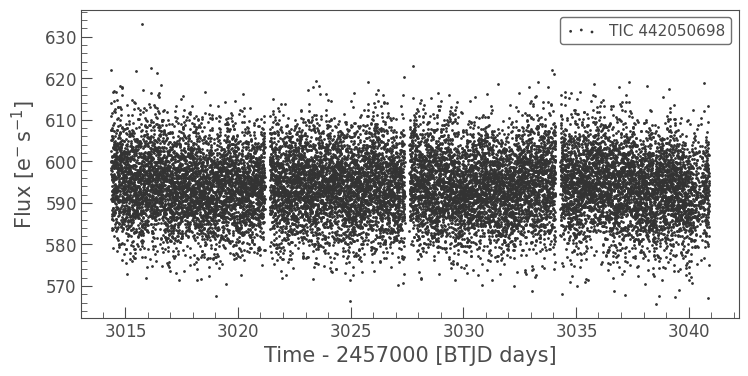

In [177]:
TOI4266_lc.scatter()

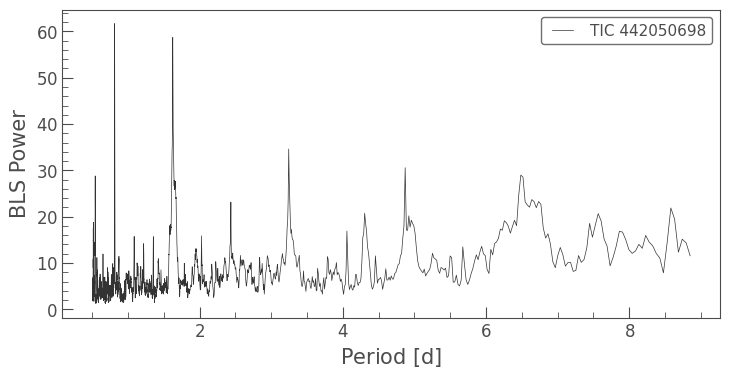

Period: 0.8113652538076984 d


In [182]:
TOI4266_lc_norm = TOI4266_lc.normalize().remove_outliers(4)
#TOI4266_lc_s63_flat = TOI4266_sec63_lc.flatten()
periodogram = TOI4266_lc_norm.to_periodogram(method='bls')
clean_period_4266 = periodogram[periodogram.period > 0.5 * u.day]
clean_period_4266.plot()
plt.show()
P_4266 = clean_period_4266.period_at_max_power
print('Period: {:}'.format(P_4266))

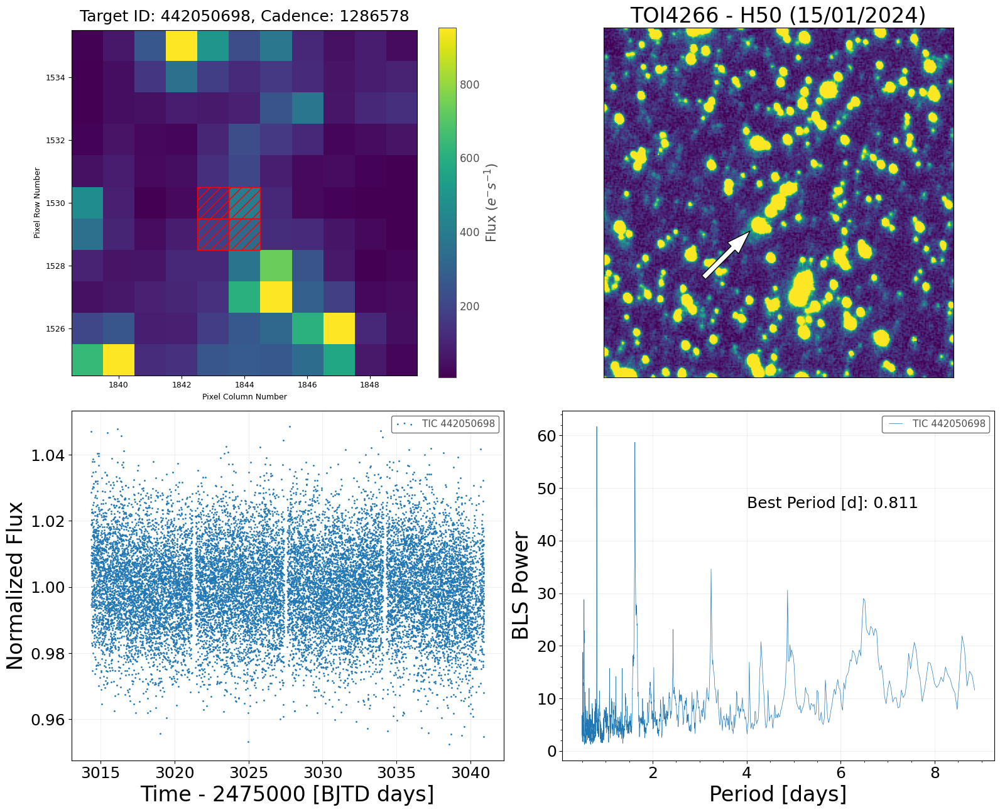

In [190]:
toi4266_im = fits.getdata('TOI4266/Nightly_Summaries/TOI4266b_Stack_15012024.fits')
toi4266_header = fits.getheader('TOI4266/Nightly_Summaries/TOI4266b_Stack_15012024.fits')

toi4266_cutout = Cutout2D(toi4266_im, (1100,1150), size = 500, wcs = WCS(toi4266_header))
toi4266_rot = rotate(toi4266_cutout.data, angle = 45, reshape=False)
z1,z2 = z.get_limits(toi4266_im)

fig, ax = plt.subplots(2,2, figsize = (16,13))
toi4266_sec63_pf.plot(aperture_mask=toi4266_sec63_pf.pipeline_mask, ax = ax[0,0])

# H50 image
ax[0,1].imshow(toi4266_rot, vmin=z1+9, vmax=z2, origin = 'lower', cmap = 'viridis')
ax[0,1].set_xlim(toi4266_cutout.data.shape[0]/2 + 16 - 131, toi4266_cutout.data.shape[0]/2 + 16  + 131)
ax[0,1].set_ylim(toi4266_cutout.data.shape[0]/2 - 16 +  131, toi4266_cutout.data.shape[0]/2 - 16 - 131)
ax[0,1].tick_params(left = False, right = False , labelleft = False , labelbottom = False, bottom = False)
ax[0,1].arrow(toi4266_cutout.data.shape[0]/2 - 40, toi4266_cutout.data.shape[0]/2 + 40, 22, -22, width = 4, color = 'white', ec = 'black')
ax[0,1].set_title('TOI4266 - H50 (15/01/2024)', fontsize = 24)

TOI4266_lc_norm[TOI4266_lc_norm.time.value > 3000].scatter(ax = ax[1,0])
ax[1,0].set_xlabel('Time - 2475000 [BJTD days]', fontsize = 24)
ax[1,0].set_ylabel('Normalized Flux', fontsize = 24)
ax[1,0].tick_params(axis='both', labelsize = 18)

# Periodogram
clean_period_4266.plot(ax=ax[1,1])
ax[1,1].text(4, 3*clean_period_4266.max_power/4, 'Best Period [d]: ' + str(round(P_4266.value,3)), fontsize = 18)
ax[1,1].set_xlabel('Period [days]', fontsize = 24)
ax[1,1].set_ylabel('BLS Power', fontsize = 24)
ax[1,1].tick_params(axis='both', labelsize = 18)

plt.tight_layout()
ax[1,1].grid(alpha=0.2)
ax[1,0].grid(alpha=0.2)

plt.savefig('TOI4266/tpf_lc_prd_toi4266.png')

In [68]:
Id = 442050698
mask_pixs_s63 = np.where(toi4266_sec63_pf.pipeline_mask == True)
mask_pixs_s64 = np.where(toi4266_sec64_pf.pipeline_mask == True)
sectors = np.array([63, 64])
ap_s63 = np.array(list(zip(mask_pixs_s63[0] + toi4266_sec63_pf.column, mask_pixs_s63[1] + toi4266_sec63_pf.row)))
ap_s64 = np.array(list(zip(mask_pixs_s64[0] + toi4266_sec64_pf.column, mask_pixs_s64[1] + toi4266_sec64_pf.row)))
aps = [ap_s63, ap_s64]

target = tr.target(ID=Id, sectors=sectors, trilegal_fname='442050698_TRILEGAL.csv')

In [69]:
target.stars = target.stars[target.stars['sep (arcsec)'] < 5.0]

In [70]:
target.stars

,ID,Tmag,Jmag,Hmag,Kmag,ra,dec,mass,rad,Teff,plx,sep (arcsec),PA (E of N)
0,442050698,13.4530,12.559,12.156,12.074,145.778750,-58.510809,NaN,NaN,6574.0,0.941866,0.000,0.000
1,523001496,16.5668,NaN,NaN,NaN,145.778859,-58.510961,NaN,NaN,NaN,NaN,0.584,159.489


In [79]:
target.calc_depths(tdepth=(6450.0/10**6), all_ap_pixels=aps)

In [81]:
#target.stars = target.stars.drop(1)
target.stars['mass'][0] = 0.93
target.stars['rad'][0] = 1.27
target.stars['Teff'][0] = 5198

In [82]:
target.stars

,ID,Tmag,Jmag,Hmag,Kmag,ra,dec,mass,rad,Teff,plx,sep (arcsec),PA (E of N),fluxratio,tdepth
0,442050698,13.453,12.559,12.156,12.074,145.77875,-58.510809,0.93,1.27,5198.0,0.941866,0.0,0.0,1.0,0.00645


In [83]:
e_estimate_4266 = TOI4266_lc_norm[TOI4266_lc_norm.flux == TOI4266_lc_norm.flux.min()].time.value[0]

<AxesSubplot:xlabel='Phase [JD]', ylabel='Normalized Flux'>

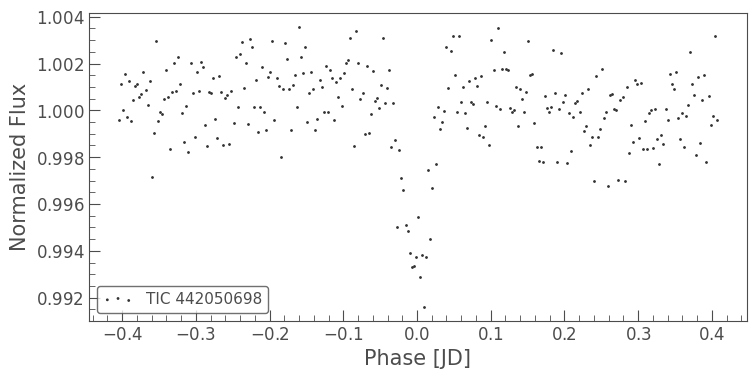

In [84]:
TOI4266_lc_fold = TOI4266_lc_norm.fold(period=period_4266, epoch_time=e_estimate_4266 + 0.01)
bin_4266_lc =  TOI4266_lc_fold.bin(240*u.second)
bin_4266_lc.scatter()

In [86]:
FPPs = np.zeros(10)
NFPPs = np.zeros(10)

for i in range(10):
    print('Running... Iteration {:}'.format(i+1))
    target.calc_probs(time=bin_4266_lc.time.value, flux_0=bin_4266_lc.flux.value,\
                      flux_err_0=np.mean(bin_4266_lc.flux_err.value), P_orb=float(period_4266.value), parallel=True, verbose = 0)
    
    FPPs[i] = float(target.FPP)
    NFPPs[i] = float(target.NFPP)

meanFPP = np.round(np.mean(FPPs), 4)
stdvFPP = np.round(np.std(FPPs), 4)
meanNFPP = np.round(np.mean(NFPPs), 4)
stdvNFPP = np.round(np.std(NFPPs), 4)
print("FPP =", meanFPP, "+/-", stdvFPP)
print("NFPP =", meanNFPP, "+/-", stdvNFPP)

Running... Iteration 1
Running... Iteration 2
Running... Iteration 3
Running... Iteration 4
Running... Iteration 5
Running... Iteration 6
Running... Iteration 7
Running... Iteration 8
Running... Iteration 9
Running... Iteration 10
FPP = 0.7434 +/- 0.0153
NFPP = 0.0 +/- 0.0


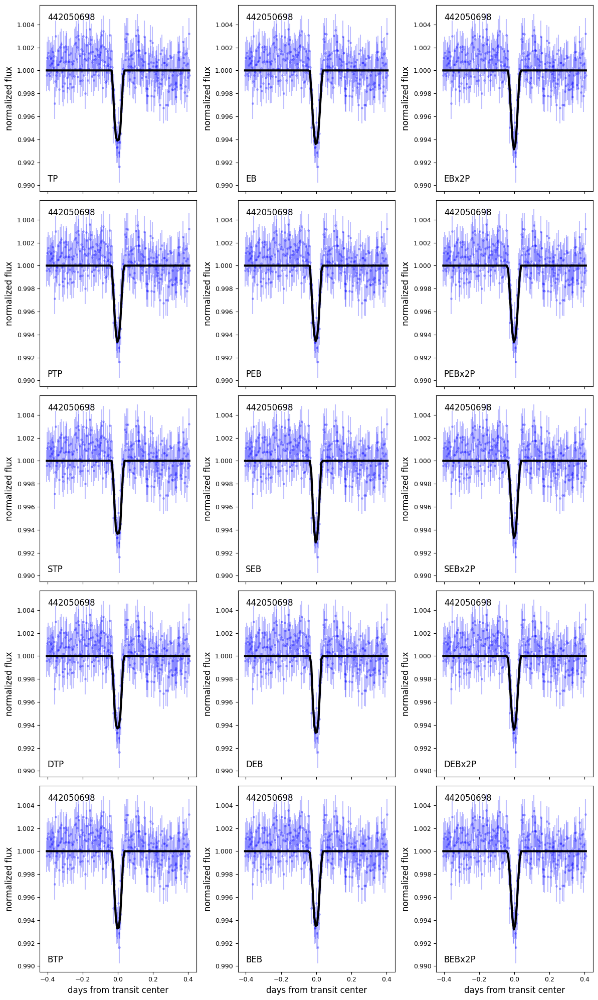

In [87]:
target.plot_fits(time=bin_4266_lc.time.value, flux_0=bin_4266_lc.flux.value, flux_err_0=np.mean(bin_4266_lc.flux_err.value))

In [88]:
target.probs.sort_values('prob', ascending=False)

,ID,scenario,M_s,R_s,P_orb,inc,b,ecc,w,R_p,M_EB,R_EB,prob
2,442050698,EBx2P,0.930000,1.270000,1.623658,74.419886,1.427814,0.088814,148.627861,0.000000,0.906889,0.946434,0.333248
0,442050698,TP,0.930000,1.270000,0.811829,73.807630,0.720829,0.164084,158.699309,11.859715,0.000000,0.000000,0.187877
5,442050698,PEBx2P,0.930000,1.270000,1.623658,75.794536,1.280541,0.183982,167.921688,0.000000,0.909709,0.950201,0.179174
3,442050698,PTP,0.930000,1.270000,0.811829,73.053889,0.739198,0.183443,156.711220,18.388119,0.000000,0.000000,0.079757
8,442050698,SEBx2P,0.404551,0.406204,1.623658,85.373796,0.826304,0.286232,137.232203,0.000000,0.403120,0.404950,0.062729
6,442050698,STP,0.400536,0.402697,0.811829,88.806255,0.103222,0.330371,141.570502,19.894342,0.000000,0.000000,0.033863
14,442050698,BEBx2P,0.745000,0.764913,1.623658,79.530951,0.823864,0.497842,61.061205,0.000000,0.731582,0.762695,0.025442
4,442050698,PEB,0.930000,1.270000,0.811829,74.878673,0.661301,0.240792,159.714987,0.000000,0.103734,0.125302,0.022961
11,442050698,DEBx2P,0.930000,1.270000,1.623658,74.882357,1.357019,0.108649,145.483313,0.000000,0.890735,0.925401,0.022643
13,442050698,BEB,0.709000,0.692400,0.811829,89.387597,0.059121,0.000150,354.140457,0.000000,0.434681,0.433590,0.017925


In [89]:
FPPs

array([0.76361487, 0.73070699, 0.73173829, 0.72369499, 0.74042591,
       0.74875206, 0.75436843, 0.76718827, 0.75180581, 0.72189192])

In [90]:
NFPPs

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

# Stellar Variability

In [31]:
from astropy.stats import sigma_clip
from astropy.timeseries import LombScargle, LombScargleMultiband

In [22]:
assn_lc_3070 = pd.read_csv('TOI3070/TOI3070_ASASN_LC.csv')
atlas_lc_3070 = pd.read_csv('TOI3070/TOI3070_ATLAS_LC.csv')

assn_lc_3097 = pd.read_csv('TOI3097/TOI3097_ASASN_LC.csv')
atlas_lc_3097 = pd.read_csv('TOI3097/TOI3097_ATLAS_LC.csv')

assn_lc_3124 = pd.read_csv('TOI3124/TOI3124_ASASN_LC.csv')

assn_lc_3163 = pd.read_csv('TOI3163/TOI3163_ASASN_LC.csv')
atlas_lc_3163 = pd.read_csv('TOI3163/TOI3163_ATLAS_LC.csv')

assn_lc_4266 = pd.read_csv('TOI4266/TOI4266_ASASN_LC.csv')
atlas_lc_4266 = pd.read_csv('TOI4266/TOI4266_ATLAS_LC.csv')

In [23]:
atlas_lcs = [atlas_lc_3070, atlas_lc_3097, atlas_lc_3163, atlas_lc_4266]
target_list = ['TOI3070', 'TOI3097', 'TOI3163', 'TOI4266']

In [29]:
assn_lcs = [assn_lc_3070, assn_lc_3097, assn_lc_3124, assn_lc_3163, assn_lc_4266]
assn_targets = ['TOI3070', 'TOI3097', 'TOI3124', 'TOI3163', 'TOI4266']

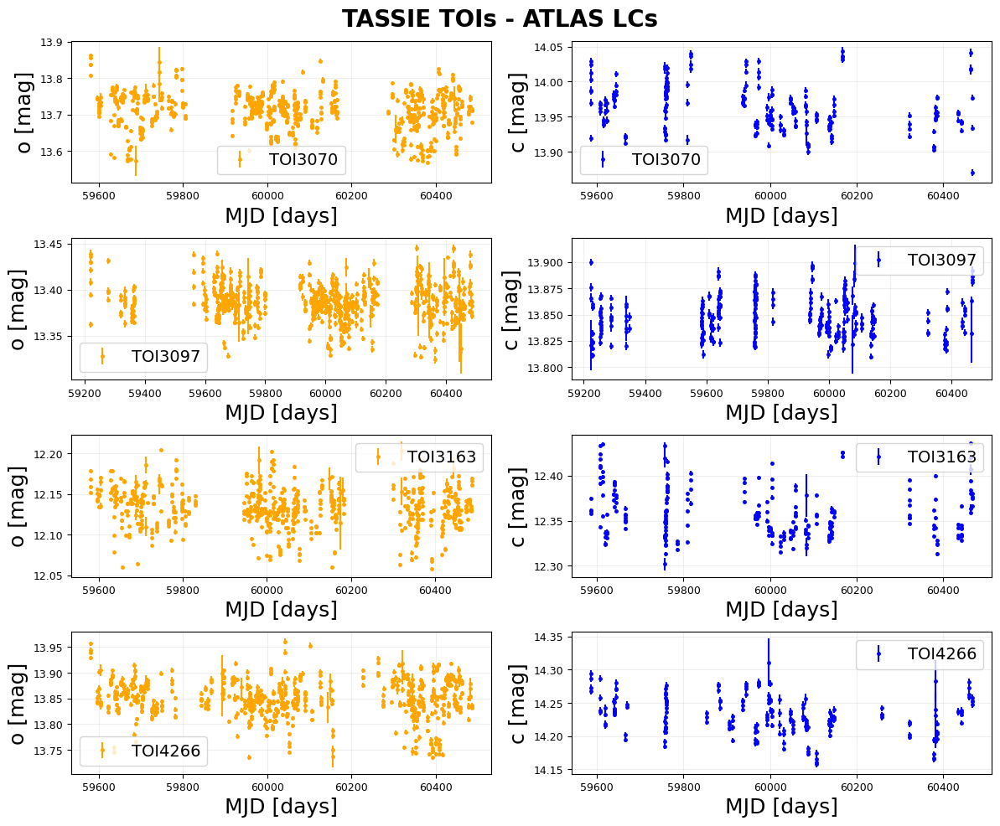

In [28]:
fig, ax = plt.subplots(4, 2, figsize = (12,10))
filt_list = atlas_lcs[0].F.unique()
cols = ['orange', 'b']

for i in range(0, len(atlas_lcs)):
    for j in range(0, len(filt_list)):
        lc = atlas_lcs[i][atlas_lcs[i].F == filt_list[j]]
        mask = sigma_clip(lc.mag, sigma=3, maxiters=10).mask
        masked_lc = lc[~mask]
        masked_lc = masked_lc[masked_lc.mag_er < 0.05]
        
        ax[i,j].errorbar(masked_lc.MJD, masked_lc.mag,yerr = masked_lc.mag_er, label = target_list[i], color = cols[j], fmt = '.')
        ax[i,j].set_xlabel('MJD [days]', fontsize = 18)
        ax[i,j].set_ylabel(filt_list[j]+' [mag]', fontsize = 18)
        ax[i,j].legend(fontsize=14)
        ax[i,j].grid(alpha = 0.2)

fig.suptitle('TASSIE TOIs - ATLAS LCs', fontweight = 'bold', fontsize = 20)
plt.tight_layout()
plt.savefig('TASSIE_ATLAS_LCs.png')

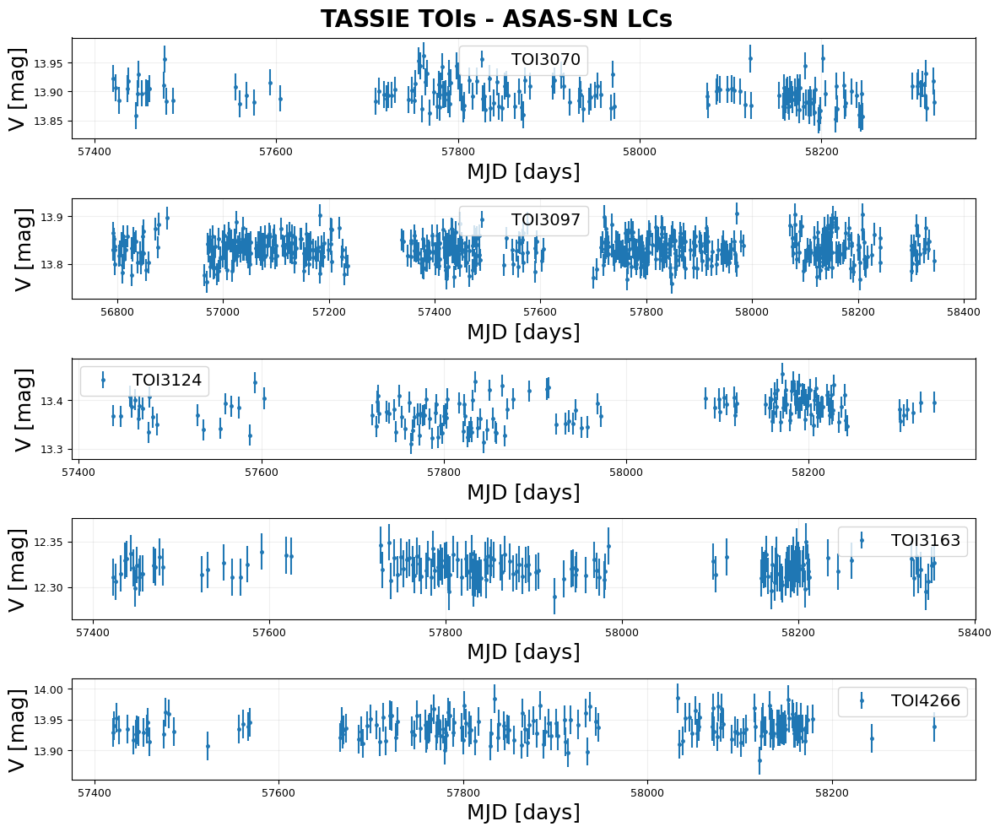

In [31]:
fig, ax = plt.subplots(5, 1, figsize = (12,10))

for i in range(0, len(assn_lcs)):
    lc = assn_lcs[i]
    target = assn_targets[i]
    mask = sigma_clip(lc.mag, sigma=3, maxiters=10).mask
    masked_lc = lc[~mask]
    masked_lc = masked_lc[masked_lc.mag_err < 0.05]
        
    ax[i].errorbar(masked_lc.hjd - 2400000.5, masked_lc.mag,yerr = masked_lc.mag_err, fmt = '.', label = target)
    ax[i].set_xlabel('MJD [days]', fontsize = 18)
    ax[i].set_ylabel('V [mag]', fontsize = 18)
    ax[i].legend(fontsize = 14)
    ax[i].grid(alpha = 0.2)

fig.suptitle('TASSIE TOIs - ASAS-SN LCs', fontweight = 'bold', fontsize = 20)
plt.tight_layout()
plt.savefig('TASSIE_ASAS-SN_LCs.png')

Best period: 5.75 days
FAP: 0.47685005921717105


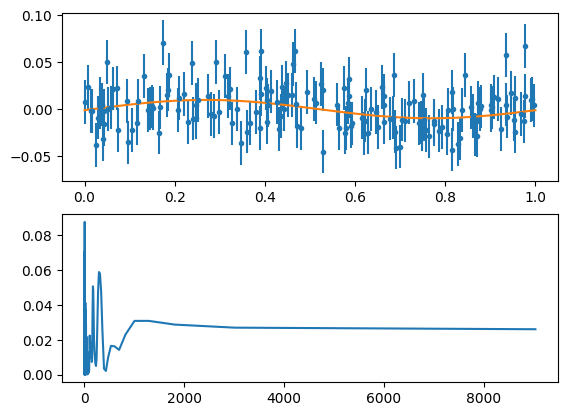

In [50]:
mask = sigma_clip(assn_lc_3070.mag, sigma=4, maxiters=10).mask
masked_lc = assn_lc_3070[~mask]

ls = LombScargle(masked_lc.hjd,masked_lc.mag, masked_lc.mag_err)
frequency, power = ls.autopower()
period_days = 1. / frequency
period_hours = period_days * 24
best_period = period_days[np.argmax(power)]
phase = (masked_lc.hjd / best_period) % 1

print("Best period: {0:.2f} days".format(best_period))
print("FAP: {:}".format(ls.false_alarm_probability(power.max())))

phase_model = np.linspace(-0, 1, 100)
best_frequency = frequency[np.argmax(power)]
mag_model = ls.model(phase_model / best_frequency, best_frequency)

fig, ax = plt.subplots(2,1)
ax[1].plot(period_days, power)
ax[0].errorbar(phase, masked_lc.mag - np.median(masked_lc.mag), masked_lc.mag_err, fmt = '.')
ax[0].plot(phase_model, mag_model - np.median(mag_model))

Best period: 80.41 days
FAP: 0.691432960263601


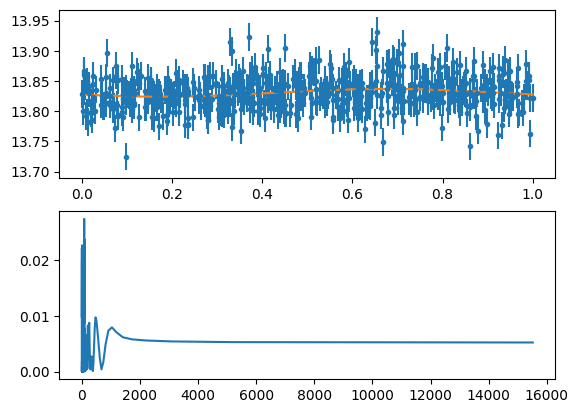

In [31]:
mask = sigma_clip(assn_lc_3097.mag, sigma=4, maxiters=10).mask
masked_lc = assn_lc_3097[~mask]
#masked_lc = masked_lc[masked_lc.mag_err < 0.05]

ls = LombScargle(masked_lc.hjd, masked_lc.mag, masked_lc.mag_err)
frequency, power = ls.autopower()
period_days = 1. / frequency
period_hours = period_days * 24
best_period = period_days[np.argmax(power)]
phase = (masked_lc.hjd / best_period) % 1

print("Best period: {0:.2f} days".format(best_period))
print("FAP: {:}".format(ls.false_alarm_probability(power.max())))

phase_model = np.linspace(-0, 1, 100)
best_frequency = frequency[np.argmax(power)]
mag_model = ls.model(phase_model / best_frequency, best_frequency)

fig, ax = plt.subplots(2,1)
ax[1].plot(period_days, power)
ax[0].errorbar(phase, masked_lc.mag, masked_lc.mag_err, fmt = '.')
ax[0].plot(phase_model, mag_model)

Best period: 2.31 days
FAP: 2.3785307392881623e-05


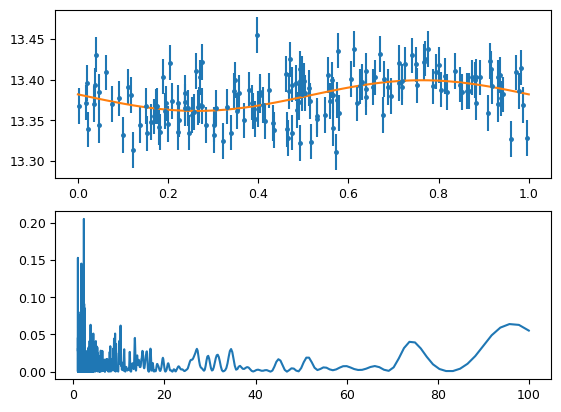

In [39]:
mask = sigma_clip(assn_lc_3124.mag, sigma=3, maxiters=10).mask
masked_lc = assn_lc_3124[~mask]
#masked_lc = masked_lc[masked_lc.mag_err < 0.05]

ls = LombScargle(masked_lc.hjd, masked_lc.mag, masked_lc.mag_err)
frequency_assn, power_assn = ls.autopower(minimum_frequency=1/100, maximum_frequency=1.0)
#frequency_assn, power_assn = ls.autopower()
period_days_assn = 1. / frequency_assn
period_hours_assn = period_days_assn * 24
best_period_assn = period_days_assn[np.argmax(power_assn)]
phase_assn = (masked_lc.hjd / best_period_assn) % 1

print("Best period: {0:.2f} days".format(best_period_assn))
print("FAP: {:}".format(ls.false_alarm_probability(power_assn.max())))

phase_model_assn = np.linspace(-0, 1, 100)
best_frequency_assn = frequency_assn[np.argmax(power_assn)]
mag_model_assn = ls.model(phase_model_assn / best_frequency_assn, best_frequency_assn)

fig, ax = plt.subplots(2,1)
ax[1].plot(period_days_assn, power_assn)
ax[0].errorbar(phase_assn, masked_lc.mag, masked_lc.mag_err, fmt = '.')
ax[0].plot(phase_model_assn, mag_model_assn)

In [28]:
TOI3124_lc_norms = TOI3124_lc.normalize().remove_outliers(4)

In [ ]:
ls = LombScargle(TOI3124_lc_norm.time.value, TOI3124_lc_norm.flux, TOI3124_lc_norm.flux_err, nterms=1)
frequency_tess, power_tess = ls.autopower(minimum_frequency=1/100, maximum_frequency=1.0)
period_days_tess = 1. / frequency_tess
period_hours_tess = period_days_tess * 24
best_period_tess = period_days_tess[np.argmax(power_tess)]
phase_tess = (TOI3124_lc_norm.time.value / best_period_tess) % 1

print("Best period: {0:.2f} days".format(best_period_tess))
#print("FAP: {:}".format(ls.false_alarm_probability(power_tess.max())))

phase_tess_model = np.linspace(-0, 1, 100)
best_frequency_tess = frequency_tess[np.argmax(power_tess)]
mag_model_1 = ls.model(phase_tess_model / best_frequency_tess, best_frequency_tess)

In [7]:
y_data = TOI3124_lc_norm.flux 
x_data = TOI3124_lc_norm.time.value

In [77]:
from scipy import optimize

def test_func(t, a, b, c, P1, P2, P3, theta1, theta2, theta3):
    return 1 + a * np.sin((2*np.pi/P1)*t + theta1) + b*np.sin((2*np.pi/P2) * t + theta2) + c*np.sin((2*np.pi/P3) * t + theta3)

params, params_covariance = optimize.curve_fit(test_func, x_data, y_data, p0=[1.1, 1.02, 1.0, 2.31, 2.42, 2.37, 0., 0., 0.])

print(params)

[-1.80177210e-02  1.22724295e-02 -1.41770156e-02  2.30774780e+00
  2.46113046e+00  2.42804980e+00 -8.73078428e+00  1.32177628e+02
  1.96241341e+02]


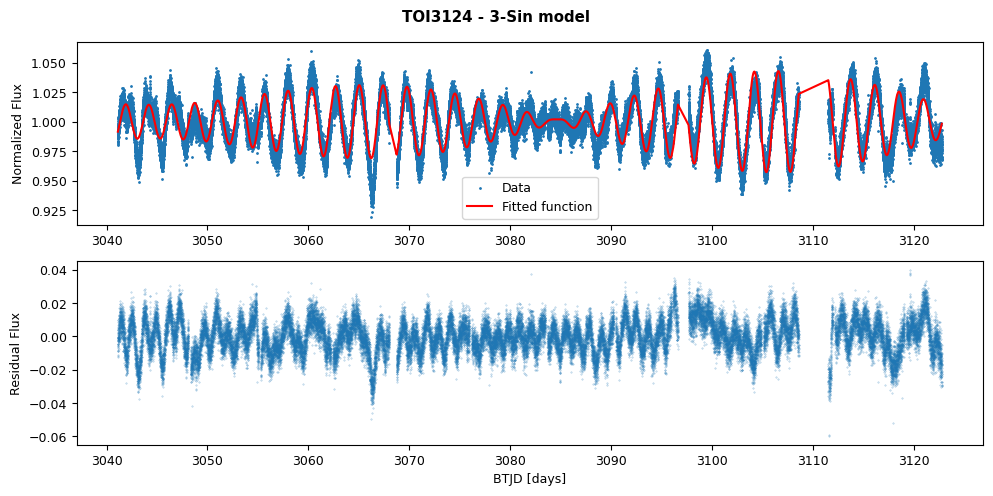

In [95]:
fig, ax = plt.subplots(2,1, figsize=(10, 5))
ax[0].scatter(x_data, y_data, label='Data', s = 1)
ax[0].plot(x_data, test_func(x_data, params[0], params[1], params[2], params[3], params[4], params[5], params[6],\
                           params[7], params[8]),
         label='Fitted function', color = 'r', alpha = 1)

ax[1].scatter(x_data, y_data - test_func(x_data, params[0], params[1], params[2], params[3], params[4], params[5], params[6],\
                           params[7], params[8]), alpha = 0.5, s = 0.1)

ax[1].set_xlabel('BTJD [days]')
ax[1].set_ylabel('Residual Flux')
ax[0].set_ylabel('Normalized Flux')

ax[0].legend(loc='best')
fig.suptitle('TOI3124 - 3-Sin model', fontweight = 'bold')
plt.tight_layout()

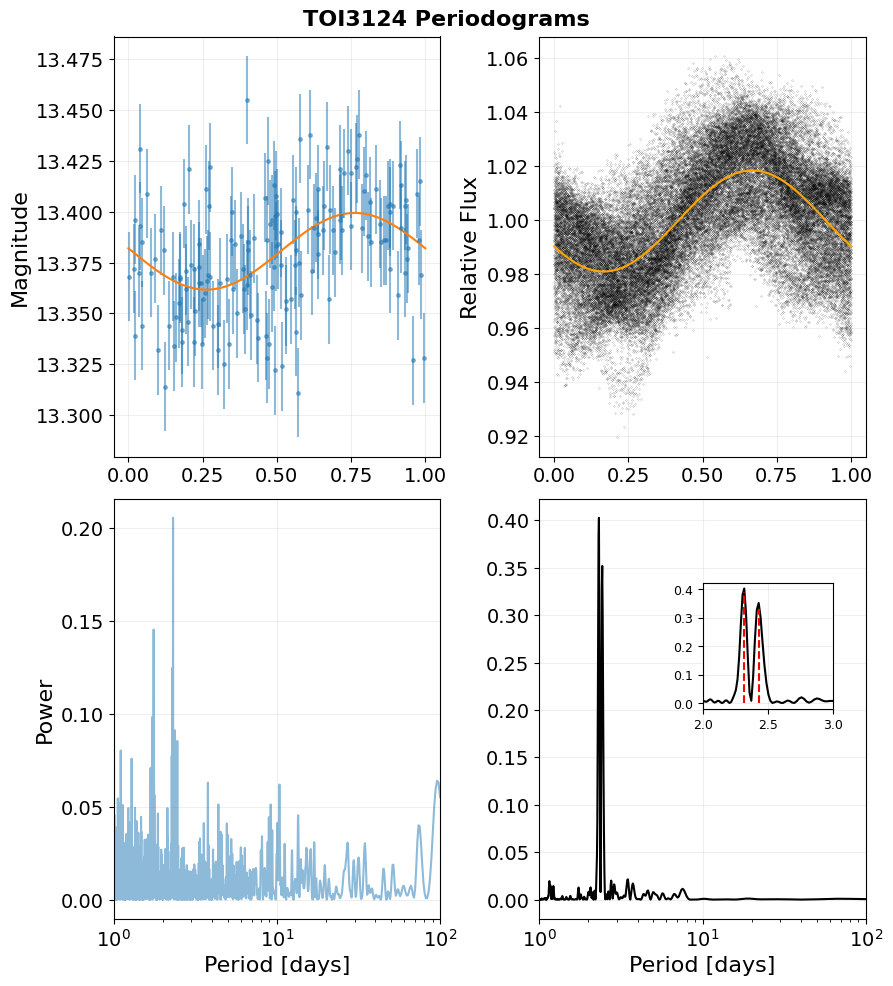

In [45]:
fig, ax = plt.subplots(2,2, figsize = (9,10))

ax[1,0].set_xscale('log')
ax[1,0].plot(period_days_assn, power_assn, alpha = 0.5)
ax[1,0].tick_params(axis = 'both', labelsize = 14)
ax[0,0].tick_params(axis = 'both', labelsize = 14)
ax[0,0].errorbar(phase_assn, masked_lc.mag, masked_lc.mag_err, fmt = '.', label = 'ASAS-SN', alpha = 0.5)
ax[0,0].plot(phase_model_assn, mag_model_assn)
ax[1,0].grid(alpha = 0.2)
ax[0,0].grid(alpha = 0.2)
ax[1,0].set_xlabel('Period [days]', fontsize = 16)
ax[1,0].set_ylabel('Power', fontsize = 16)
ax[0,0].set_ylabel('Magnitude', fontsize = 16)
ax[1,0].set_xlim(1, 100)

ax[1,1].set_xscale('log')
ax[1,1].plot(period_days_tess, power_tess, color = 'black')
ax[0,1].scatter(x=phase_tess, y=TOI3124_lc_norm.flux, s = 0.01, color = 'black', label = 'TESS')
ax[0,1].plot(phase_tess_model, mag_model_1, color = 'orange')
ax[0,1].grid(alpha = 0.2)
ax[1,1].grid(alpha = 0.2)
ax[1,1].set_xlim(1, 100)
ax[1,1].set_xlabel('Period [days]', fontsize = 16)
ax[0,1].set_ylabel('Relative Flux', fontsize = 16)
ax[0,1].tick_params(axis = 'both', labelsize = 14)
ax[1,1].tick_params(axis = 'both', labelsize = 14)


# create inset axes & plot on them
ins_ax = ax[1,1].inset_axes([.5, 0.5, .4, .3])  # [x, y, width, height] w.r.t. ax
ins_ax.plot(period_days_tess, power_tess, color = 'black')
ins_ax.set_xlim(2, 3)
ins_ax.vlines(2.32, 0, 0.39, color = 'r', linestyle = 'dashed')
ins_ax.vlines(2.43, 0, 0.33, color = 'r', linestyle = 'dashed')
ins_ax.grid(alpha = 0.2)

fig.suptitle('TOI3124 Periodograms', fontweight = 'bold', fontsize = 16)
plt.tight_layout()
#plt.savefig('TESS_Periodogram_3124.png')

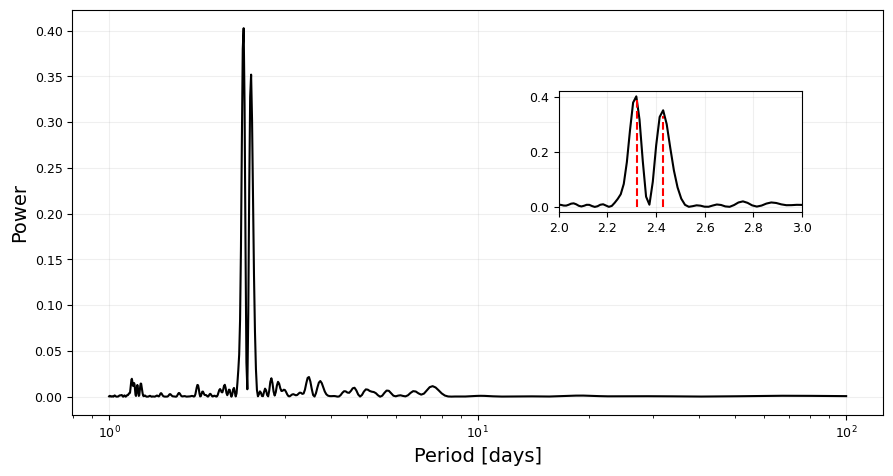

In [101]:
fig, ax = plt.subplots(figsize = (9, 6)) 
ax.set_box_aspect(0.5)  # main figure and axes

ax.set_xscale('log')
ax.plot(period_days, power, color = 'black')
ax.grid(alpha = 0.2)
ax.set_xlabel('Period [days]', fontsize = 14)
ax.set_ylabel('Power', fontsize = 14)

# create inset axes & plot on them
ins_ax = ax.inset_axes([.6, 0.5, .3, .3])  # [x, y, width, height] w.r.t. ax
ins_ax.plot(period_days, power, color = 'black')
ins_ax.set_xlim(2, 3)
ins_ax.vlines(2.32, 0, 0.39, color = 'r', linestyle = 'dashed')
ins_ax.vlines(2.43, 0, 0.33, color = 'r', linestyle = 'dashed')
ins_ax.grid(alpha = 0.2)

plt.tight_layout()
plt.savefig('TESS_Periodogram_3124')

Best period: 14.63 days
FAP: 0.12125720857337592


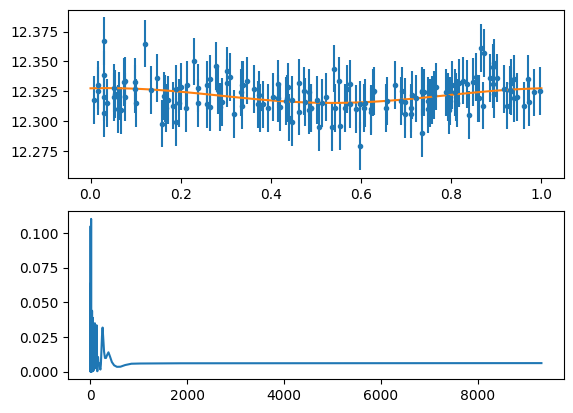

In [34]:
mask = sigma_clip(assn_lc_3163.mag, sigma=4, maxiters=10).mask
masked_lc = assn_lc_3163[~mask]
#masked_lc = masked_lc[masked_lc.mag_err < 0.05]

ls = LombScargle(masked_lc.hjd, masked_lc.mag, masked_lc.mag_err)
frequency, power = ls.autopower()
period_days = 1. / frequency
period_hours = period_days * 24
best_period = period_days[np.argmax(power)]
phase = (masked_lc.hjd / best_period) % 1

print("Best period: {0:.2f} days".format(best_period))
print("FAP: {:}".format(ls.false_alarm_probability(power.max())))

phase_model = np.linspace(-0, 1, 100)
best_frequency = frequency[np.argmax(power)]
mag_model = ls.model(phase_model / best_frequency, best_frequency)

fig, ax = plt.subplots(2,1)
ax[1].plot(period_days, power)
ax[0].errorbar(phase, masked_lc.mag, masked_lc.mag_err, fmt = '.')
ax[0].plot(phase_model, mag_model)

Best period: 131.72 hours
Best period: 5.49 days
FAP: 0.8656149156110399


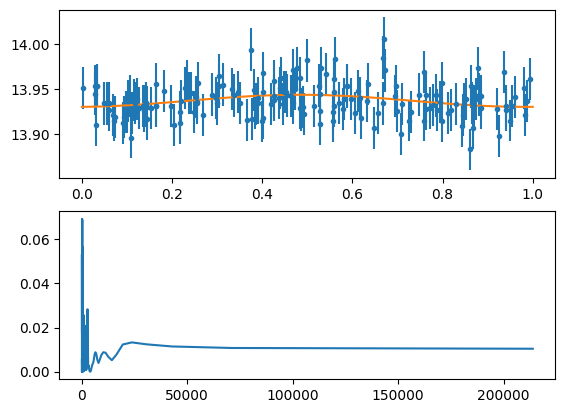

In [44]:
mask = sigma_clip(assn_lc_4266.mag, sigma=4, maxiters=10).mask
masked_lc = assn_lc_4266[~mask]
#masked_lc = masked_lc[masked_lc.mag_err < 0.05]

ls = LombScargle(masked_lc.hjd, masked_lc.mag, masked_lc.mag_err)
frequency, power = ls.autopower()
period_days = 1. / frequency
period_hours = period_days * 24
best_period = period_days[np.argmax(power)]
phase = (masked_lc.hjd / best_period) % 1

print("Best period: {0:.2f} hours".format(24*best_period))
print("Best period: {0:.2f} days".format(best_period))
print("FAP: {:}".format(ls.false_alarm_probability(power.max())))

phase_model = np.linspace(-0, 1, 100)
best_frequency = frequency[np.argmax(power)]
mag_model = ls.model(phase_model / best_frequency, best_frequency)

fig, ax = plt.subplots(2,1)
ax[1].plot(period_hours, power)
ax[0].errorbar(phase, masked_lc.mag, masked_lc.mag_err, fmt = '.')
ax[0].plot(phase_model, mag_model)

Best period for TOI3070 in o with FAP = 1.7018053836835294e-11: 0.5719079326892722 days
Best period for TOI3070 in c with FAP = 1.3525116779353361e-08: 58.41557708609299 days
Best period for TOI3097 in o with FAP = 1.044962617103354e-18: 0.9968191135952117 days
Best period for TOI3097 in c with FAP = 3.858456205358766e-09: 3.854241117993168 days
Best period for TOI3163 in o with FAP = 2.8925033504972255e-10: 0.8008803739306832 days
Best period for TOI3163 in c with FAP = 3.1487113005173786e-10: 6.748693251721511 days
Best period for TOI4266 in o with FAP = 5.988048553987899e-19: 0.5688956102003656 days
Best period for TOI4266 in c with FAP = 7.63953165299407e-10: 19.645033563474396 days


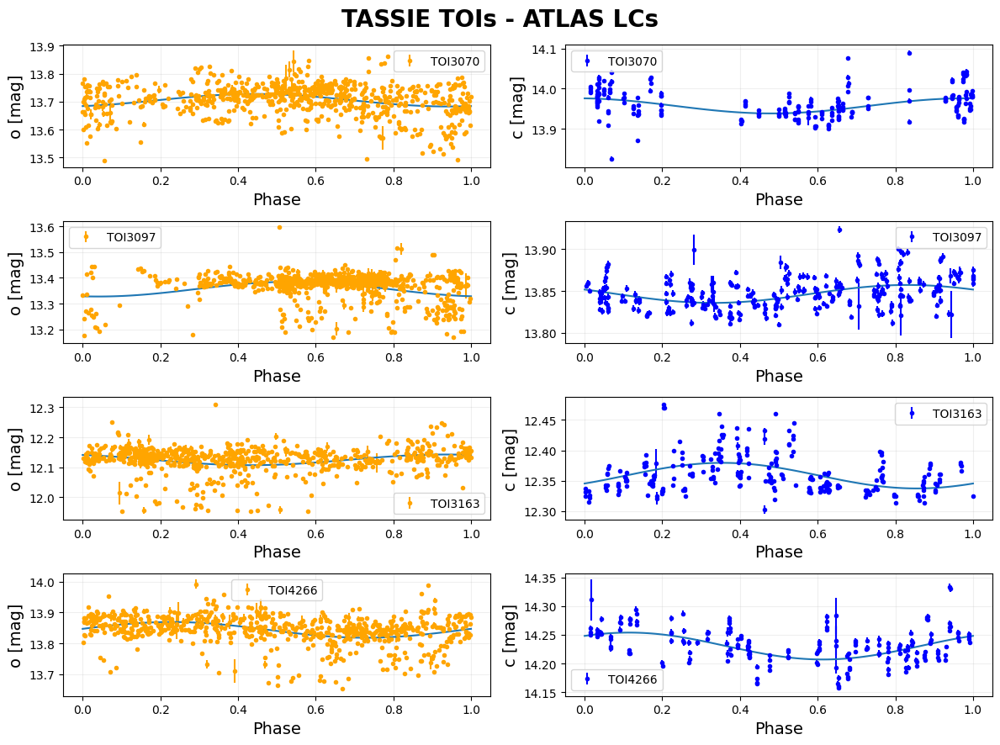

In [43]:
fig, ax = plt.subplots(4, 2, figsize = (12,9))
filt_list = atlas_lcs[0].F.unique()
cols = ['orange', 'b']

for i in range(0, len(atlas_lcs)):
    for j in range(0, len(filt_list)):
        lc = atlas_lcs[i][atlas_lcs[i].F == filt_list[j]]
        mask = sigma_clip(lc.mag, sigma=4, maxiters=10).mask
        masked_lc = lc[~mask]
        masked_lc = masked_lc[masked_lc.mag_er < 0.05]
        
        
        ls = LombScargle(masked_lc.MJD, masked_lc.mag, masked_lc.mag_er)
        frequency, power = ls.autopower()
        period_days = 1. / frequency
        period_hours = period_days * 24
        best_period = period_days[np.argmax(power)]
        phase = (masked_lc.MJD / best_period) % 1

        print("Best period for {:} in {:} with FAP = {:}: {:} days".format(str(target_list[i]), str(filt_list[j]), ls.false_alarm_probability(power.max()), best_period))

        phase_model = np.linspace(-0, 1, 100)
        best_frequency = frequency[np.argmax(power)]
        mag_model = ls.model(phase_model / best_frequency, best_frequency)

        ax[i,j].errorbar(phase, masked_lc.mag, masked_lc.mag_er, fmt = '.', color = cols[j], label = target_list[i])
        ax[i,j].plot(phase_model, mag_model)
        ax[i,j].set_xlabel('Phase', fontsize = 14)
        ax[i,j].set_ylabel(filt_list[j]+' [mag]', fontsize = 14)
        ax[i,j].legend()
        ax[i,j].grid(alpha = 0.2)

fig.suptitle('TASSIE TOIs - ATLAS LCs', fontweight = 'bold', fontsize = 20)
plt.tight_layout()

# Planetary modelling with Juliet

In [8]:
def calc_qs(u1, u2):
    """
    A function to calculate the quadratic limb darkening coefficients
    suggested by Kipping from usual (Claret?) coefficients.
    """
    q1 = (u1 + u2)**2  
    q2 = u1/(2*(u1 + u2))
    return q1, q2

In [ ]:
def calc_K(P, M, Mstar, e, i):
    """
    A function to calculate the RV semi-amplitude from the period, eccentricity, inclination
    and stellar/planetary mass. 
    """
    K = 203 * ((P)**(-1/3)) * (1/np.sqrt(1-(e**2))) * (M*np.sin(i)/((Mstar) + (9.548 * 10**(-4))*(M))**(2/3))
    return K

def calc_TSM(scale, mj, Rp, T_eq, Mp, Rs):
    """
    A function to calculate the transmission spectroscopy metric defined by
    Kempton et al. 2018 using planetary and stellar parameters.
    
    """
    TSM = scale*(10**(-mj/5))*((Rp**3)*T_eq)/(Mp*(Rs**2))
    return TSM

## TOI3124

In [2]:
toi3124_lc_sc = lk.search_lightcurve('TOI3124')
TOI3124_lc_col = toi3124_lc_sc[0:3].download_all()
TOI3124_lc = TOI3124_lc_col[0]
TOI3124_lc = TOI3124_lc[TOI3124_lc.quality == 0]
TOI3124_lc = TOI3124_lc.normalize()

<ErrorbarContainer object of 3 artists>

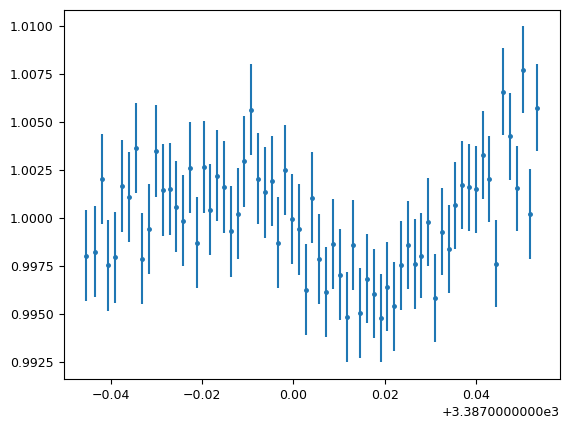

In [9]:
TOI3124_H50 = pd.read_csv('TOI3124/Phot_Outputs/DR2/diffLC.csv')
plt.errorbar(x=TOI3124_H50['BJD-TDB'] - 2457000.0, y=TOI3124_H50['DIFF_FLUX'], yerr=TOI3124_H50['ERROR'], fmt = '.')

In [15]:
t_3124, f_3124, ferr_3124 = TOI3124_lc['time'].value, TOI3124_lc['flux'].value.unmasked, TOI3124_lc['flux_err'].value.unmasked
t_h50_3124, f_h50_3124, ferr_h50_3124 = TOI3124_H50['BJD-TDB'] - 2457000.0, TOI3124_H50['DIFF_FLUX'], TOI3124_H50['ERROR']
#t, f, ferr = t[t > 3110.0], f[t > 3110.0], ferr[t > 3110.0]

In [14]:
M_3124 = ufloat(0.99, 0.11)
R_3124 = ufloat(1.34, 0.03)
rho_sol = ufloat(1408, 2)
rho_3124 = (M_3124/(R_3124**3))*rho_sol
rho_3124

579.3265793997266+/-75.22042801187169

In [22]:
t_h50_3124.to_numpy()

array([3386.9545711 , 3386.9564504 , 3386.95794145, 3386.95943258,
       3386.96092368, 3386.96241481, 3386.96390595, 3386.96539709,
       3386.96688819, 3386.96837942, 3386.96987059, 3386.9713617 ,
       3386.97285281, 3386.97434399, 3386.9758351 , 3386.97732617,
       3386.97881729, 3386.98030842, 3386.98179956, 3386.98329069,
       3386.98478173, 3386.98627287, 3386.98776398, 3386.98925511,
       3386.99074622, 3386.99223727, 3386.99372844, 3386.99521958,
       3386.99671067, 3386.9982018 , 3386.9996929 , 3387.00118404,
       3387.00267514, 3387.00416637, 3387.00565746, 3387.00714865,
       3387.00863976, 3387.01013091, 3387.01162201, 3387.01311322,
       3387.01460442, 3387.01609553, 3387.01758668, 3387.01907777,
       3387.02056884, 3387.02205999, 3387.02355111, 3387.0250422 ,
       3387.02653336, 3387.02802446, 3387.02951556, 3387.03100671,
       3387.03249783, 3387.03398893, 3387.03548003, 3387.0369712 ,
       3387.03846233, 3387.03995346, 3387.04144467, 3387.04293

In [18]:
# limb darkening

u1_r_3124 = ufloat(0.549, 0.002)
u2_r_3124 = ufloat(0.113,0.003)
u1_tess_3124 = ufloat(0.440,0.003)
u2_tess_3124 = ufloat(0.127,0.005)


print(calc_qs(u1_r_3124, u2_r_3124))
print(calc_qs(u1_tess_3124, u2_tess_3124))

(0.438244+/-0.0047737498887143225, 0.41465256797583083+/-0.001896698479973381)
(0.32148899999999997+/-0.00661229944875457, 0.3880070546737214+/-0.0034725098070272813)


In [23]:
# First define the priors:
priors = {}
times, fluxes, fluxes_error = {},{},{}

# Same priors as for the transit-only fit, but we now add the GP priors:
params = ['P_p1','t0_p1','r1_p1','r2_p1', 'ecc_p1', 'omega_p1', 'rho',\
          'q1_TESS','q2_TESS', 'q1_H50','q2_H50',\
          'mdilution_TESS', 'mflux_TESS', 'sigma_w_TESS',\
          'mdilution_H50','mflux_H50','sigma_w_H50',\
          'GP_sigma_TESS', 'GP_rho_TESS', 'GP_sigma_H50', 'GP_rho_H50']
          

dists = ['normal','normal','uniform','uniform','fixed', 'fixed', 'normal', \
         'normal', 'normal', 'normal', 'normal', \
         'fixed', 'normal', 'loguniform', \
         'fixed', 'normal', 'loguniform', \
         'loguniform','loguniform', 'loguniform', 'loguniform']

hyperps = [[2.25,0.1], [3107.45, 0.1], [0.,1], [0.,1.], 0., 90., [579.33, 75.22], \
           [0.32, 0.03],[0.39, 0.04], [0.44, 0.04],[0.42, 0.04], \
           1.0, [0.,0.1], [0.1, 1000.], \
           1.0, [0.,0.1], [0.1, 1000.], \
           [1e-6, 1e6], [1e-3, 1e3],[1e-6, 1e6], [1e-3, 1e3]]

# Populate the priors dictionary:
for param, dist, hyperp in zip(params, dists, hyperps):
    priors[param] = {}
    priors[param]['distribution'], priors[param]['hyperparameters'] = dist, hyperp

times['TESS'], fluxes['TESS'], fluxes_error['TESS'] = t_3124,f_3124,ferr_3124
times['H50'], fluxes['H50'], fluxes_error['H50'] = t_h50_3124.to_numpy(), f_h50_3124.to_numpy(), ferr_h50_3124.to_numpy()
dataset = juliet.load(priors=priors, t_lc = times, y_lc = fluxes, \
yerr_lc = fluxes_error, GP_regressors_lc = times, out_folder = 'TOI3124/JulietFitting_wH50', verbose = True)

results = dataset.fit(sampler='dynesty', nthreads = 7, n_live_points=500)

	 Transit fit detected for instrument  TESS
	 Transit fit detected for instrument  H50
	 >> ecc,omega parametrization detected for lc planet p1
	 >> (b,p) parametrization detected for lc planet p1


18741it [06:46, 46.13it/s, +500 | bound: 226 | nc: 1 | ncall: 648589 | eff(%):  2.969 | loglstar:   -inf < 72459.883 <    inf | logz: 72422.937 +/-    nan | dlogz:  0.001 >  0.509]


In [51]:
# First define the priors:
priors = {}
times, fluxes, fluxes_error = {},{},{}

# Same priors as for the transit-only fit, but we now add the GP priors:
params = ['P_p1','t0_p1','r1_p1','r2_p1', 'sesinomega_p1', 'secosomega_p1', 'rho',\
          'q1_TESS','q2_TESS', 'q1_H50','q2_H50',\
          'mdilution_TESS', 'mflux_TESS', 'sigma_w_TESS',\
          'mdilution_H50','mflux_H50','sigma_w_H50',\
          'GP_sigma_TESS', 'GP_rho_TESS', 'GP_sigma_H50', 'GP_rho_H50']
          

dists = ['normal','normal','uniform','uniform','uniform','uniform', 'normal', \
         'normal', 'normal', 'normal', 'normal', \
         'fixed', 'normal', 'loguniform', \
         'fixed', 'normal', 'loguniform', \
         'loguniform','loguniform', 'loguniform', 'loguniform']

hyperps = [[2.25,0.1], [3107.45, 0.1], [0.,1], [0.,1.], [-1.,1.], [-1.,1.], [579.33, 75.22], \
           [0.32, 0.03],[0.39, 0.04], [0.44, 0.04],[0.42, 0.04], \
           1.0, [0.,0.1], [0.1, 1000.], \
           1.0, [0.,0.1], [0.1, 1000.], \
           [1e-6, 1e6], [1e-3, 1e3],[1e-6, 1e6], [1e-3, 1e3]]

# Populate the priors dictionary:
for param, dist, hyperp in zip(params, dists, hyperps):
    priors[param] = {}
    priors[param]['distribution'], priors[param]['hyperparameters'] = dist, hyperp

times['TESS'], fluxes['TESS'], fluxes_error['TESS'] = t_3124,f_3124,ferr_3124
times['H50'], fluxes['H50'], fluxes_error['H50'] = t_h50_3124.to_numpy(), f_h50_3124.to_numpy(), ferr_h50_3124.to_numpy()
dataset = juliet.load(priors=priors, t_lc = times, y_lc = fluxes, \
yerr_lc = fluxes_error, GP_regressors_lc = times, out_folder = 'TOI3124/JulietFitting_wH50_esinomega', verbose = True)

results = dataset.fit(sampler='dynamic_dynesty', nthreads = 7, n_live_points=300)

	 Transit fit detected for instrument  TESS
	 Transit fit detected for instrument  H50
	 >> sqrt(e)cosomega, sqrt(e)sinomega parametrization detected for lc planet p1
	 >> (b,p) parametrization detected for lc planet p1
Detected dynamic_dynesty sampler output files --- extracting from TOI3124/JulietFitting_wH50_esinomega/_dynesty_DNS_posteriors.pkl


(0.96, 1.04)

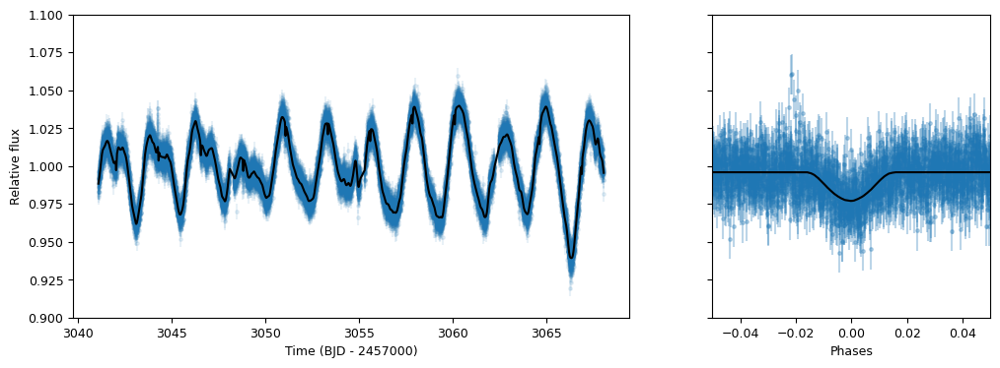

In [52]:
import matplotlib.gridspec as gridspec

# Extract full model:
transit_plus_GP_model = results.lc.evaluate('TESS')

# Deterministic part of the model (in our case transit divided by mflux):
transit_model = results.lc.model['TESS']['deterministic']

# GP part of the model:
gp_model = results.lc.model['TESS']['GP']

# Now plot. First preambles:
fig = plt.figure(figsize=(12,4))
gs = gridspec.GridSpec(1, 2, width_ratios=[2,1])
ax1 = plt.subplot(gs[0])

# Plot data
ax1.errorbar(dataset.times_lc['TESS'], dataset.data_lc['TESS'], \
             yerr = dataset.errors_lc['TESS'], fmt = '.', alpha = 0.1)

# Plot the (full, transit + GP) model:
ax1.plot(dataset.times_lc['TESS'], transit_plus_GP_model, color='black',zorder=10)

#ax1.set_xlim([3090,31])
ax1.set_ylim([0.9,1.1])
ax1.set_xlabel('Time (BJD - 2457000)')
ax1.set_ylabel('Relative flux')

ax2 = plt.subplot(gs[1])

# Now plot phase-folded lightcurve but with the GP part removed:
phases = juliet.utils.get_phases(dataset.times_lc['TESS'], np.median(results.posteriors['posterior_samples']['P_p1']), np.median(results.posteriors['posterior_samples']['t0_p1']))
ax2.errorbar(phases, dataset.data_lc['TESS'] - gp_model, \
             yerr = dataset.errors_lc['TESS'], fmt = '.', alpha = 0.3)

# Plot transit-only (divided by mflux) model:
idx = np.argsort(phases)
ax2.plot(phases[idx],transit_model[idx], color='black',zorder=10)
ax2.yaxis.set_major_formatter(plt.NullFormatter())
ax2.set_xlabel('Phases')
ax2.set_xlim([-0.05,0.05])
ax2.set_ylim([0.96,1.04])

(0.96, 1.04)

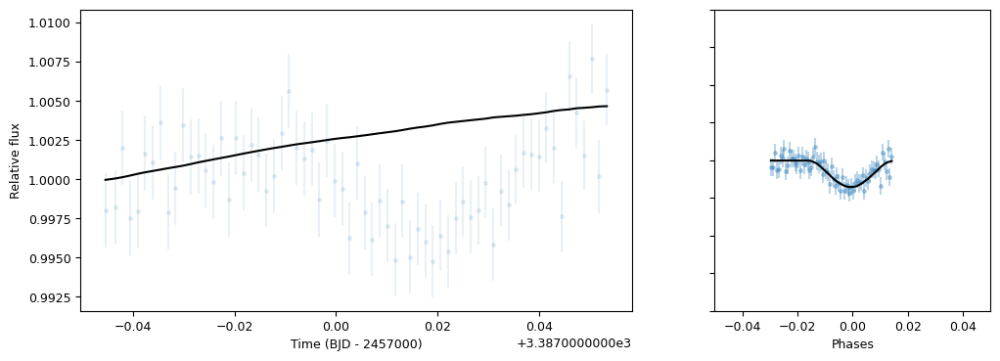

In [56]:
import matplotlib.gridspec as gridspec

# Extract full model:
transit_plus_GP_model = results.lc.evaluate('H50')

# Deterministic part of the model (in our case transit divided by mflux):
transit_model = results.lc.model['H50']['deterministic']

# GP part of the model:
gp_model = results.lc.model['H50']['GP']

# Now plot. First preambles:
fig = plt.figure(figsize=(12,4))
gs = gridspec.GridSpec(1, 2, width_ratios=[2,1])
ax1 = plt.subplot(gs[0])

# Plot data
ax1.errorbar(dataset.times_lc['H50'], dataset.data_lc['H50'], \
             yerr = dataset.errors_lc['H50'], fmt = '.', alpha = 0.1)

# Plot the (full, transit + GP) model:
#ax1.plot(dataset.times_lc['H50'], transit_plus_GP_model, color='black',zorder=10)
ax1.plot(dataset.times_lc['H50'], 1+gp_model, color='black',zorder=10)

ax1.set_xlabel('Time (BJD - 2457000)')
ax1.set_ylabel('Relative flux')

ax2 = plt.subplot(gs[1])

# Now plot phase-folded lightcurve but with the GP part removed:
phases = juliet.utils.get_phases(dataset.times_lc['H50'], np.median(results.posteriors['posterior_samples']['P_p1']), np.median(results.posteriors['posterior_samples']['t0_p1']))
ax2.errorbar(phases, dataset.data_lc['H50'] - gp_model, \
             yerr = dataset.errors_lc['H50'], fmt = '.', alpha = 0.3)

# Plot transit-only (divided by mflux) model:
idx = np.argsort(phases)
ax2.plot(phases[idx],transit_model[idx], color='black',zorder=10)
ax2.yaxis.set_major_formatter(plt.NullFormatter())
ax2.set_xlabel('Phases')
ax2.set_xlim([-0.05,0.05])
ax2.set_ylim([0.96,1.04])

Text(0, 0.5, '$p = R_p/R_*$')

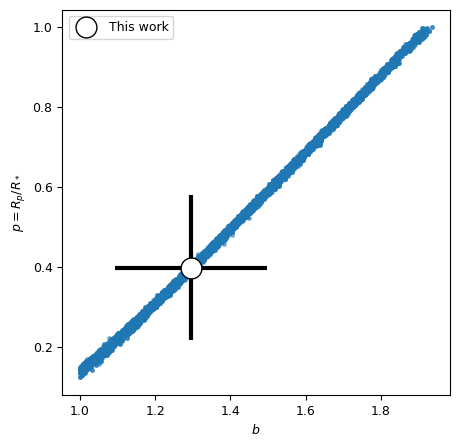

In [49]:
fig = plt.figure(figsize=(5,5))
# Store posterior samples for r1 and r2:
r1, r2 = results.posteriors['posterior_samples']['r1_p1'],\
         results.posteriors['posterior_samples']['r2_p1']

# Transform back to (b,p):
b,p = juliet.utils.reverse_bp(r1, r2, 0., 1.)

# Plot posterior distribution:
plt.plot(b,p,'.',alpha=0.5)

# Extract median and 1-sigma errors for b and p from
# the posterior distribution:
bm,bu,bl = juliet.utils.get_quantiles(b)
pm,pu,pl = juliet.utils.get_quantiles(p)

# Plot them:
plt.errorbar(x=np.array([bm]),y = np.array([pm]),\
             xerr = [bm-bl],\
             yerr = [pm-pl],\
             fmt = 'o', mfc = 'white', mec = 'black',\
             ecolor='black', ms = 15, elinewidth = 3, \
             zorder = 5, label = 'This work')


plt.legend()
#plt.xlim([0.,0.8])
#plt.ylim([0.1,0.125])
plt.xlabel('$b$')
plt.ylabel('$p = R_p/R_*$')

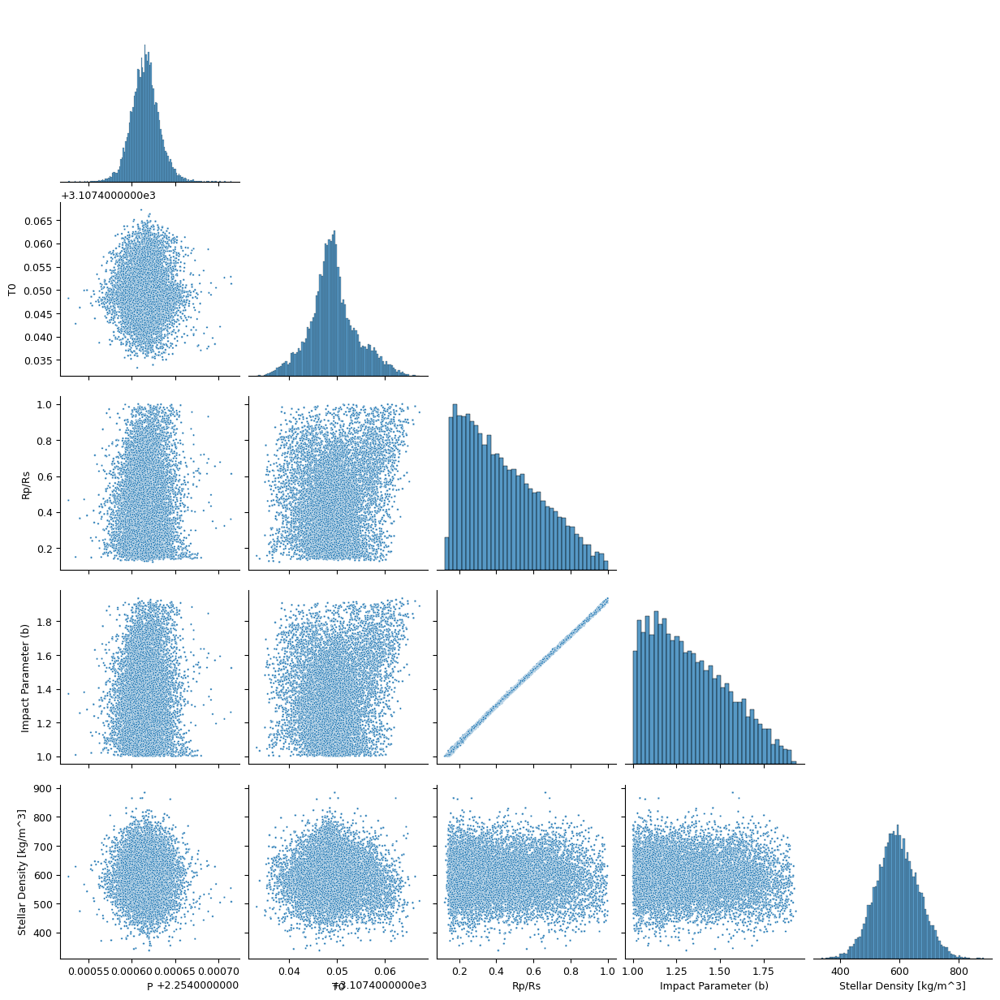

In [50]:
P = results.posteriors['posterior_samples']['P_p1']
t0 = results.posteriors['posterior_samples']['t0_p1']
rho = results.posteriors['posterior_samples']['rho']
df = pd.DataFrame(data={'P': P, 'T0': t0, 'Rp/Rs': p, 'Impact Parameter (b)': b, 'Stellar Density [kg/m^3]': rho})
fig = sns.pairplot(df, corner = True, plot_kws=dict(marker='.',size=1))
fig.tight_layout()

## TOI3163

In [2]:
TOI3163_lc_sc = lk.search_lightcurve('TOI3163')
TOI3163_lc_sc

#,mission,year,author,exptime,target_name,distance
,,,,s,,arcsec
0,TESS Sector 64,2023,SPOC,120,425316308,0.0
1,TESS Sector 64,2023,TESS-SPOC,200,425316308,0.0
2,TESS Sector 11,2019,QLP,1800,425316308,0.0
3,TESS Sector 37,2021,QLP,600,425316308,0.0
4,TESS Sector 38,2021,QLP,600,425316308,0.0
5,TESS Sector 64,2023,QLP,200,425316308,0.0


In [3]:
TOI3163_lc_s64 = TOI3163_lc_sc[0].download()
TOI3163_lc_s64_norm = TOI3163_lc_s64.normalize().remove_outliers(4)

<AxesSubplot:xlabel='Time - 2457000 [BTJD days]', ylabel='Normalized Flux'>

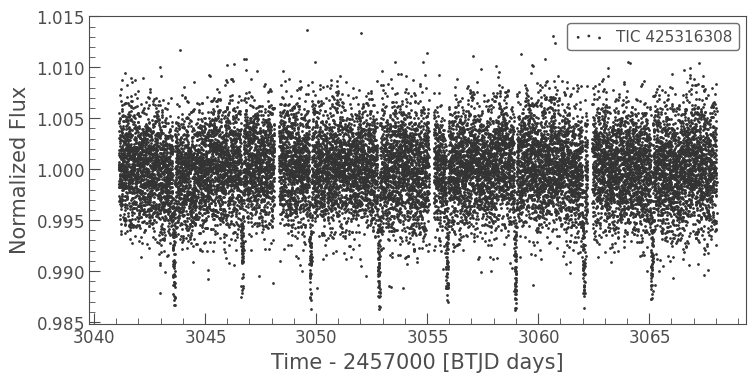

In [4]:
TOI3163_lc_s64_norm.scatter()
#plt.xlim(3043, 3044)

In [15]:
P_3163, t0_3163 = 3.072, 3043.6

In [16]:
M_3163 = ufloat(1.29, 0.24)
R_3163 = ufloat(1.56, 0.2)
rho_sol = ufloat(1408, 2)
rho_3163 = (M_3163/(R_3163**3))*rho_sol
T_3163 = ufloat(6501, 57)

rho_3163

478.4301825721944+/-204.4102774244783

In [17]:
# limb darkening

u1_r_3163 = ufloat(0.428, 0.002)
u2_r_3163 = ufloat(0.141,0.004)
u1_tess_3163 = ufloat(0.342,0.004)
u2_tess_3163 = ufloat(0.138,0.006)

print(calc_qs(u1_r_3163, u2_r_3163))
print(calc_qs(u1_tess_3163, u2_tess_3163))

(0.32376099999999997+/-0.005089290716789521, 0.37609841827768015+/-0.0026795537872153137)
(0.23040000000000005+/-0.00692265844889086, 0.35625+/-0.004611434332819104)


<ErrorbarContainer object of 3 artists>

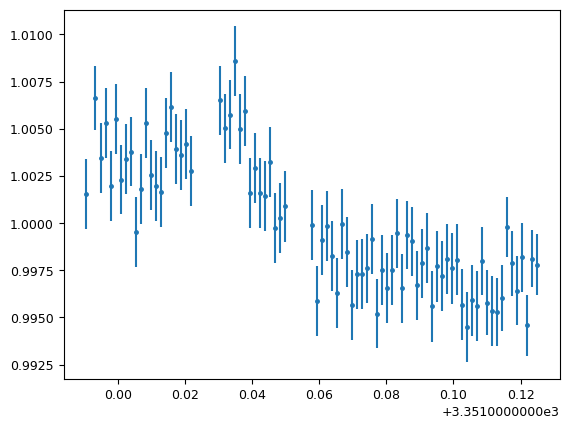

In [8]:
TOI3163_H50 = pd.read_csv('TOI3163/Phot_Outputs/DR2/diffLC.csv')
TOI3163_H50 = TOI3163_H50[TOI3163_H50['BJD-TDB'] > (3350.99 + 2457000.0)]
plt.errorbar(x=TOI3163_H50['BJD-TDB'] - 2457000.0, y=TOI3163_H50['DIFF_FLUX'], yerr=TOI3163_H50['ERROR'], fmt = '.')

In [9]:
t_3163, f_3163, ferr_3163 = TOI3163_lc_s64_norm['time'].value, TOI3163_lc_s64_norm['flux'].value.unmasked, TOI3163_lc_s64_norm['flux_err'].value.unmasked
t_h50_3163, f_h50_3163, ferr_h50_3163 = TOI3163_H50['BJD-TDB'] - 2457000.0, TOI3163_H50['DIFF_FLUX'], TOI3163_H50['ERROR']

In [172]:
# First define the priors:
priors = {}
times, fluxes, fluxes_error = {},{},{}

# Same priors as for the transit-only fit, but we now add the GP priors:
params = ['P_p1','t0_p1','r1_p1','r2_p1', 'ecc_p1', 'omega_p1', 'rho',\
          'q1_TESS','q2_TESS', 'q1_H50','q2_H50',\
          'mdilution_TESS', 'mflux_TESS', 'sigma_w_TESS',\
          'mdilution_H50','mflux_H50','sigma_w_H50',\
          'GP_sigma_TESS', 'GP_rho_TESS', 'GP_sigma_H50', 'GP_rho_H50']
          

dists = ['normal','normal','uniform','uniform','fixed', 'fixed', 'normal', \
         'normal', 'normal', 'normal', 'normal', \
         'fixed', 'normal', 'loguniform', \
         'normal', 'normal', 'loguniform', \
         'loguniform','loguniform', 'loguniform', 'loguniform']

hyperps = [[P_3163, 0.1], [t0_3163, 0.05], [0.,1], [0.,1.], 0., 90., [478.4, 204.4], \
           [0.23, 0.02],[0.36, 0.04], [0.32, 0.03],[0.38, 0.04],\
           1.0, [0.,0.1], [0.1, 1000.], \
           [0.94, 0.01], [0.,0.1], [0.1, 1000.], \
           [1e-6, 1e6], [1e-3, 1e3],[1e-6, 1e6], [1e-3, 1e3]]

# Populate the priors dictionary:
for param, dist, hyperp in zip(params, dists, hyperps):
    priors[param] = {}
    priors[param]['distribution'], priors[param]['hyperparameters'] = dist, hyperp

times['TESS'], fluxes['TESS'], fluxes_error['TESS'] = t_3163,f_3163,ferr_3163
times['H50'], fluxes['H50'], fluxes_error['H50'] = t_h50_3163.to_numpy(), f_h50_3163.to_numpy(), ferr_h50_3163.to_numpy()

dataset = juliet.load(priors=priors, t_lc = times, y_lc = fluxes, \
yerr_lc = fluxes_error, GP_regressors_lc = times, out_folder = 'TOI3163/JulietFitting_Final', verbose = True)

results = dataset.fit(sampler='dynesty', nthreads = 7, n_live_points=1000)

results.posteriors['lnZ']

	 Transit fit detected for instrument  TESS
	 Transit fit detected for instrument  H50
	 >> ecc,omega parametrization detected for lc planet p1
	 >> (b,p) parametrization detected for lc planet p1
Detected dynesty sampler output files --- extracting from TOI3163/JulietFitting_Final/_dynesty_NS_posteriors.pkl


81807.3011753555

In [12]:
# Eccentric orbit version for TOI3163

# First define the priors:
priors = {}
times, fluxes, fluxes_error = {},{},{}

# Same priors as for the transit-only fit, but we now add the GP priors:
params = ['P_p1','t0_p1','r1_p1','r2_p1', 'sesinomega_p1', 'secosomega_p1', 'rho',\
          'q1_TESS','q2_TESS', 'q1_H50','q2_H50',\
          'mdilution_TESS', 'mflux_TESS', 'sigma_w_TESS',\
          'mdilution_H50','mflux_H50','sigma_w_H50',\
          'GP_sigma_TESS', 'GP_rho_TESS', 'GP_sigma_H50', 'GP_rho_H50']
          

dists = ['normal','normal','uniform','uniform','uniform','uniform', 'normal', \
         'normal', 'normal', 'normal', 'normal', \
         'fixed', 'normal', 'loguniform', \
         'normal', 'normal', 'loguniform', \
         'loguniform','loguniform', 'loguniform', 'loguniform']

hyperps = [[P_3163, 0.1], [t0_3163, 0.05], [0.,1], [0.,1.], [-1.,1.], [-1.,1.], [478.4, 204.4],\
           [0.23, 0.02],[0.36, 0.04], [0.32, 0.03],[0.38, 0.04],\
           1.0, [0.,0.1], [0.1, 1000.],\
           [0.94, 0.01], [0.,0.1], [0.1, 1000.],\
           [1e-6, 1e6], [1e-3, 1e3],[1e-6, 1e6], [1e-3, 1e3]]

# Populate the priors dictionary:
for param, dist, hyperp in zip(params, dists, hyperps):
    priors[param] = {}
    priors[param]['distribution'], priors[param]['hyperparameters'] = dist, hyperp

times['TESS'], fluxes['TESS'], fluxes_error['TESS'] = t_3163,f_3163,ferr_3163
times['H50'], fluxes['H50'], fluxes_error['H50'] = t_h50_3163.to_numpy(), f_h50_3163.to_numpy(), ferr_h50_3163.to_numpy()

dataset = juliet.load(priors=priors, t_lc = times, y_lc = fluxes, \
yerr_lc = fluxes_error, GP_regressors_lc = times, out_folder = 'TOI3163/JulietFitting_FinalwEcc', verbose = True)

results = dataset.fit(sampler='dynamic_dynesty', nthreads = 7, n_live_points=400)

results.posteriors['lnZ']

	 Transit fit detected for instrument  TESS
	 Transit fit detected for instrument  H50
	 >> sqrt(e)cosomega, sqrt(e)sinomega parametrization detected for lc planet p1
	 >> (b,p) parametrization detected for lc planet p1


30140it [20:16, 24.77it/s, batch: 3 | bound: 26 | nc: 1 | ncall: 1138423 | eff(%):  2.612 | loglstar: 81844.910 < 81854.015 < 81849.846 | logz: 81799.882 +/-  0.286 | stop:  0.976]      


81799.92759546338

In [19]:
# Extract full model:
transit_plus_GP_model_TESS = results.lc.evaluate('TESS')

# Deterministic part of the model (in our case transit divided by mflux):
transit_model_TESS = results.lc.model['TESS']['deterministic']

# GP part of the model:
gp_model_TESS = results.lc.model['TESS']['GP']

# Extract full model:
transit_plus_GP_model_H50 = results.lc.evaluate('H50')

# Deterministic part of the model (in our case transit divided by mflux):
transit_model_H50 = results.lc.model['H50']['deterministic']

# GP part of the model:
gp_model_H50 = results.lc.model['H50']['GP']

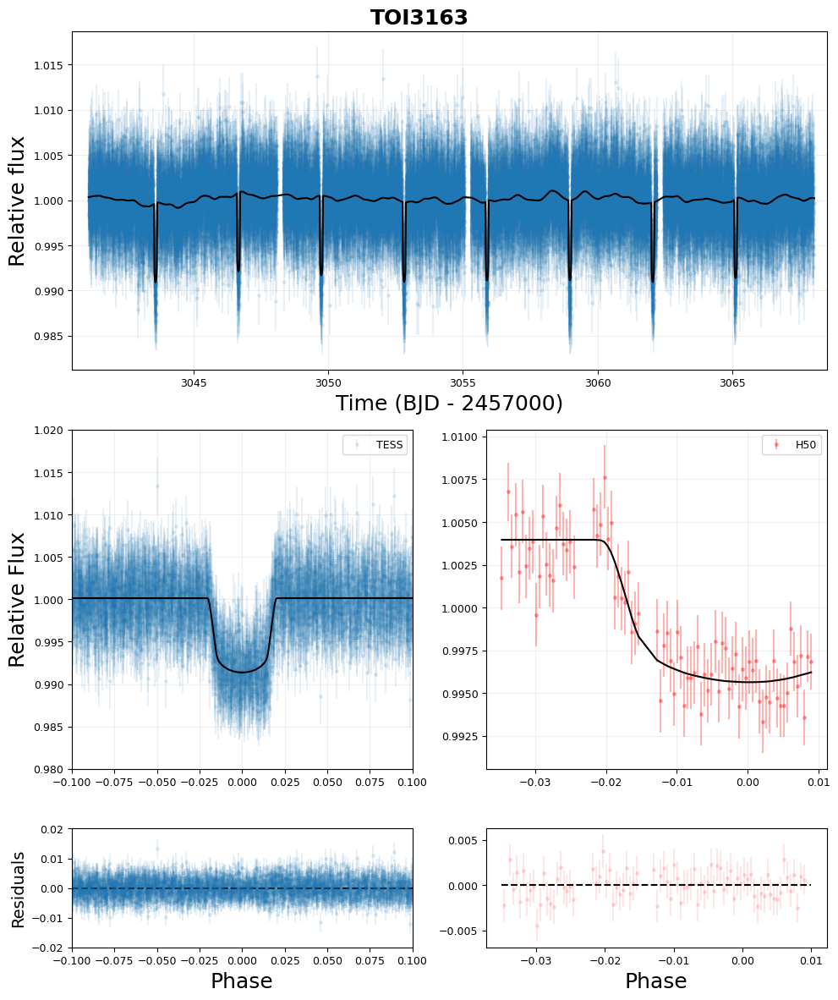

In [20]:
import matplotlib.gridspec as gridspec

# Now plot. First preambles:
fig = plt.figure(figsize=(10,12))
gs = gridspec.GridSpec(3,2, height_ratios=[1, 1, 0.35])
ax1 = plt.subplot(gs[0,:])
ax1.grid(alpha = 0.2)

# Plot data
ax1.errorbar(dataset.times_lc['TESS'], dataset.data_lc['TESS'], \
             yerr = dataset.errors_lc['TESS'], fmt = '.', alpha = 0.1)

# Plot the (full, transit + GP) model:
ax1.plot(dataset.times_lc['TESS'], transit_plus_GP_model_TESS, color='black',zorder=10)

ax1.set_xlim(3040.5, 3068.5)
#ax1.set_ylim([0.98,1.02])
ax1.set_xlabel('Time (BJD - 2457000)', fontsize = 18)
ax1.set_ylabel('Relative flux', fontsize = 18)

ax2 = plt.subplot(gs[1,0])

# Now plot phase-folded lightcurve but with the GP part removed:
phases_TESS = juliet.utils.get_phases(dataset.times_lc['TESS'], np.median(results.posteriors['posterior_samples']['P_p1']), np.median(results.posteriors['posterior_samples']['t0_p1']))
ax2.errorbar(phases_TESS, dataset.data_lc['TESS'] - gp_model_TESS, \
             yerr = dataset.errors_lc['TESS'], fmt = '.', alpha = 0.1, label = 'TESS')

# Plot transit-only (divided by mflux) model:
idx_TESS = np.argsort(phases_TESS)
ax2.plot(phases_TESS[idx_TESS],transit_model_TESS[idx_TESS], color='black',zorder=10)
ax2.set_xlim([-0.1,0.1])
ax2.set_ylim([0.98,1.02])
ax2.set_ylabel('Relative Flux', fontsize = 18)
ax2.grid(alpha = 0.2)
ax2.legend()

ax3 = plt.subplot(gs[1,1])

# Plot data

# Now plot phase-folded lightcurve but with the GP part removed:
phases_H50 = juliet.utils.get_phases(dataset.times_lc['H50'], np.median(results.posteriors['posterior_samples']['P_p1']), np.median(results.posteriors['posterior_samples']['t0_p1']))
ax3.errorbar(phases_H50, dataset.data_lc['H50'] - gp_model_H50, \
             yerr = dataset.errors_lc['H50'], color='r', fmt = '.', alpha = 0.3, label = 'H50')

# Plot transit-only (divided by mflux) model:
idx_H50 = np.argsort(phases_H50)
ax3.plot(phases_H50[idx_H50],transit_model_H50[idx_H50], color='black',zorder=10)
ax3.grid(alpha = 0.2)
ax3.legend()

ax4 = plt.subplot(gs[2,0])
ax4.errorbar(phases_TESS, dataset.data_lc['TESS'] - transit_model_TESS - gp_model_TESS, \
             yerr = dataset.errors_lc['TESS'], fmt = '.', alpha = 0.1, label = 'TESS')
ax4.set_xlim([-0.1,0.1])
ax4.set_xlabel('Phase', fontsize = 18)
ax4.set_ylabel('Residuals', fontsize = 14)
ax4.hlines(0, -0.1, 0.1, linestyle = 'dashed', color = 'black')
ax4.set_ylim(-0.02, 0.02)

ax5 = plt.subplot(gs[2,1])
ax5.errorbar(phases_H50, dataset.data_lc['H50'] - transit_model_H50 - gp_model_H50, \
             yerr = dataset.errors_lc['H50'], fmt = '.', alpha = 0.1, label = 'H50', color = 'r')
ax5.set_xlabel('Phase', fontsize = 18)
ax5.hlines(0, -0.035, 0.01, linestyle = 'dashed', color = 'black')
#ax5.set_ylim(-0.05, 0.05)

fig.suptitle('TOI3163', fontsize = 18, fontweight = 'bold')

plt.tight_layout()

#plt.savefig('TOI3163b_Model.png')

Text(0, 0.5, '$p = R_p/R_*$')

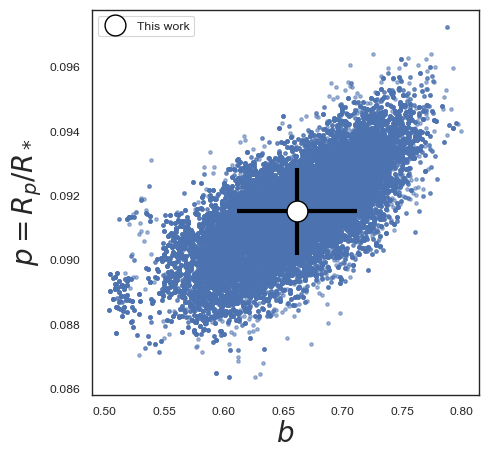

In [173]:
fig = plt.figure(figsize=(5,5))
# Store posterior samples for r1 and r2:
r1, r2 = results.posteriors['posterior_samples']['r1_p1'],\
         results.posteriors['posterior_samples']['r2_p1']

# Transform back to (b,p):
b,p = juliet.utils.reverse_bp(r1, r2, 0., 1.)

# Plot posterior distribution:
plt.plot(b,p,'.',alpha=0.5)

# Extract median and 1-sigma errors for b and p from
# the posterior distribution:
bm,bu,bl = juliet.utils.get_quantiles(b)
pm,pu,pl = juliet.utils.get_quantiles(p)

# Plot them:
plt.errorbar(x=np.array([bm]),y = np.array([pm]),\
             xerr = [bm-bl],\
             yerr = [pm-pl],\
             fmt = 'o', mfc = 'white', mec = 'black',\
             ecolor='black', ms = 15, elinewidth = 3, \
             zorder = 5, label = 'This work')


plt.legend()
#plt.xlim([0.,0.8])
#plt.ylim([0.1,0.125])
plt.xlabel('$b$')
plt.ylabel('$p = R_p/R_*$')

In [176]:
df = pd.DataFrame()

for key in results.posteriors['posterior_samples'].keys():
    if key == 'P_p1' or key == 't0_p1' or key == 'rho' or key == 'q1_TESS' or key == 'q2_TESS' or key == 'q1_H50' or key == 'q2_H50':
          df[key] = results.posteriors['posterior_samples'][key]
            
df['Rp/Rs'] = p
df['b'] = b

df['P - 3.0749 [days]'] = df['P_p1'] - 3.0749
df['T0 - 3043.60 [BTJD]'] = df['t0_p1'] - 3043.60

del df['P_p1']
del df['t0_p1']

df

,rho,q1_TESS,q2_TESS,q1_H50,q2_H50,Rp/Rs,b,P - 3.0749 [days],T0 - 3043.60 [BTJD]
0,783.688003,0.240506,0.328950,0.320729,0.402104,0.090170,0.592397,0.000047,-0.000034
1,759.511124,0.228678,0.312648,0.298655,0.356641,0.089048,0.611634,0.000083,0.000547
2,581.002432,0.242135,0.300172,0.353551,0.362676,0.094123,0.695445,0.000047,0.000955
3,500.941566,0.224568,0.354007,0.297300,0.409960,0.091481,0.727065,0.000039,0.000317
4,507.667417,0.211976,0.350484,0.357553,0.330828,0.093094,0.731868,0.000066,0.001000
...,...,...,...,...,...,...,...,...,...
50321,817.423474,0.239298,0.305715,0.340528,0.363790,0.090394,0.571393,0.000039,0.001169
50322,529.267384,0.223270,0.353342,0.349691,0.329629,0.091675,0.719226,0.000073,0.000432
50323,603.666889,0.236771,0.355110,0.346898,0.413368,0.092632,0.691645,0.000080,0.000824
50324,641.484492,0.216358,0.350594,0.347940,0.390330,0.091329,0.668435,0.000061,0.000895


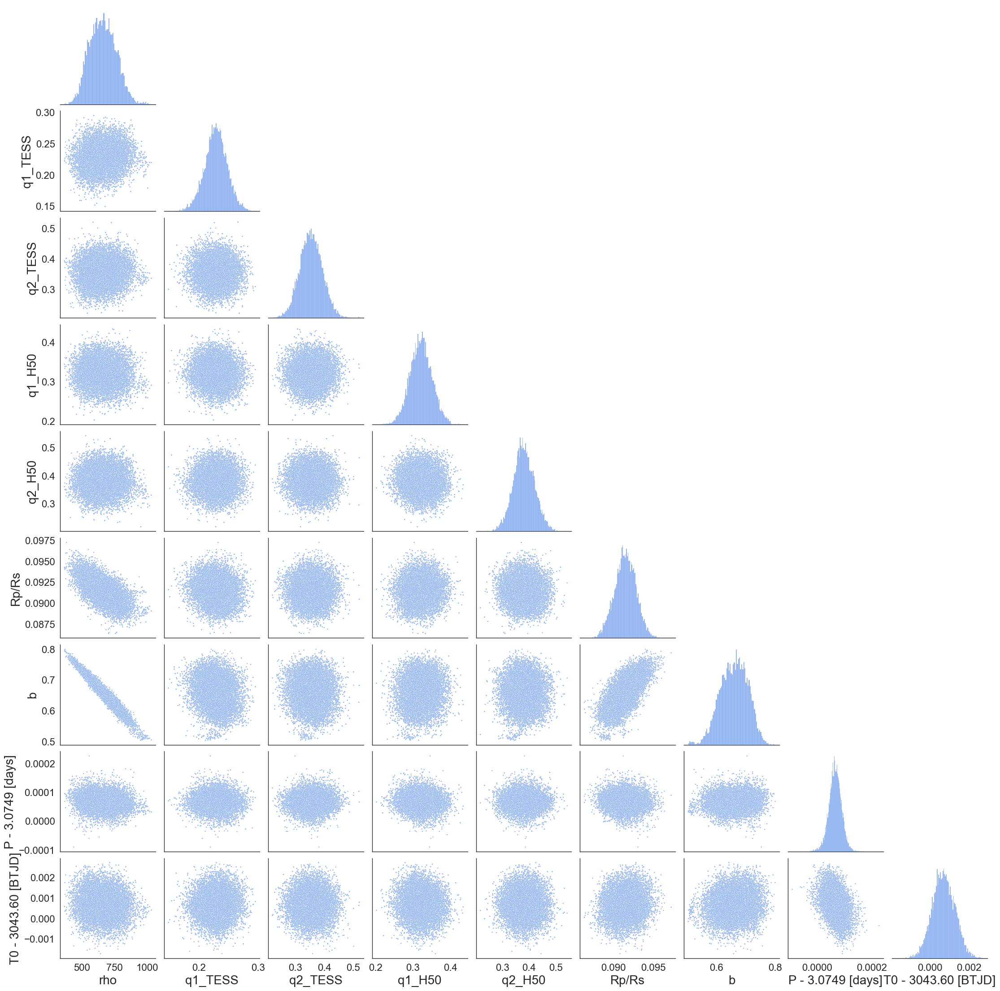

In [177]:
sns.set_theme(style='white')

sns.set_context('paper', rc={"axes.labelsize":20})

fig = sns.pairplot(df, corner = True, plot_kws=dict(marker='.',size=1, color = 'cornflowerblue'), diag_kws=dict(color='cornflowerblue'))

fig.tick_params(axis='both', labelsize = 16)
        
fig.tight_layout()

plt.savefig('TOI3163_Posteriors.png')

In [18]:
R_p = ufloat(0.0915, 0.0013)*R_3163 # in solar units
R_J = 0.10045 # in solar units
R_J_E = 10.979
R_3163b = ufloat((R_p.n/R_J), R_p.s/R_J) #*R_J_E
a_r = ufloat(6.9, 0.4)
a_3163b = a_r*R_3163*0.00465047
a_3163b = ufloat(a_3163b.n, a_3163b.s)
T_3163b = T_3163*unp.sqrt(R_3163/(a_r))
F_3163b = (((R_3163**2)*((T_3163/5778)**4))*(1/a_3163b**2))*(1361)

In [19]:
print('Radius: ', R_3163b)

print('Semi-major axis: ', a_3163b)

print('Equilibrium Temp [K]. ', T_3163b)

print('Surface Flux [W/m^2]. ', F_3163b)

Radius:  1.42+/-0.18
Semi-major axis:  0.050+/-0.007
Equilibrium Temp [K].  (3.09+/-0.22)e+03
Surface Flux [W/m^2].  (2.1+/-0.8)e+06


In [106]:
F_3163b/1361

3803.863747754479+/-1078.7075239994574

In [31]:
print(np.median(t0) + np.arange(0, 8, 1)*np.median(P))

[3043.60180639 3046.67649036 3049.75117433 3052.8258583  3055.90054227
 3058.97522625 3062.04991022 3065.12459419]


In [80]:
# Look for TTVs
priors = {}
times, fluxes, fluxes_error = {},{},{}

# Same priors as for the transit-only fit, but we now add the GP priors:
params = ['r1_p1','r2_p1','q1_TESS','q2_TESS', 'ecc_p1','omega_p1',\
          'rho', 'mdilution_TESS', 'mflux_TESS', 'sigma_w_TESS',\
          'GP_sigma_TESS', 'GP_rho_TESS']

dists = ['normal','normal','normal','normal','fixed', 'fixed',\
         'normal', 'fixed', 'normal', 'loguniform',\
         'normal','normal']

hyperps = [[0.77 , 0.03], [0.092, 0.001], [0.22, 0.02], [0.35, 0.04], 0.0, 90.0,\
           [657.4, 106.5], 1.0, [0.,0.1], [0.1, 1000.], \
           [0.00041, 0.00005], [0.296, 0.085]]

params = params + ['T_p1_TESS_0','T_p1_TESS_1', 'T_p1_TESS_2', 'T_p1_TESS_3', 'T_p1_TESS_4','T_p1_TESS_5', 'T_p1_TESS_6', 'T_p1_TESS_7']
dists = dists + ['normal','normal','normal','normal', 'normal', 'normal', 'normal','normal']
hyperps = hyperps + [[3043.602, 0.1], [3046.677, 0.1], [3049.752, 0.1], [3052.826, 0.1], [3055.901, 0.1], \
                     [3058.975, 0.1], [3062.050, 0.1], [3065.125, 0.1]]

# Populate the priors dictionary:
for param, dist, hyperp in zip(params, dists, hyperps):
    priors[param] = {}
    priors[param]['distribution'], priors[param]['hyperparameters'] = dist, hyperp
    
    
times['TESS'], fluxes['TESS'], fluxes_error['TESS'] = t_3163, f_3163, ferr_3163

dataset = juliet.load(priors=priors, t_lc = times, y_lc = fluxes,\
                      yerr_lc = fluxes_error, GP_regressors_lc = times, out_folder = 'TOI3163/TTVFitting', verbose = True)

results = dataset.fit(sampler='dynesty', nthreads = 7, n_live_points=1000)

	 Transit fit detected for instrument  TESS
	 >> ecc,omega parametrization detected for lc planet p1
	 >> (b,p) parametrization detected for lc planet p1
Detected dynesty sampler output files --- extracting from TOI3163/TTVFitting/_dynesty_NS_posteriors.pkl


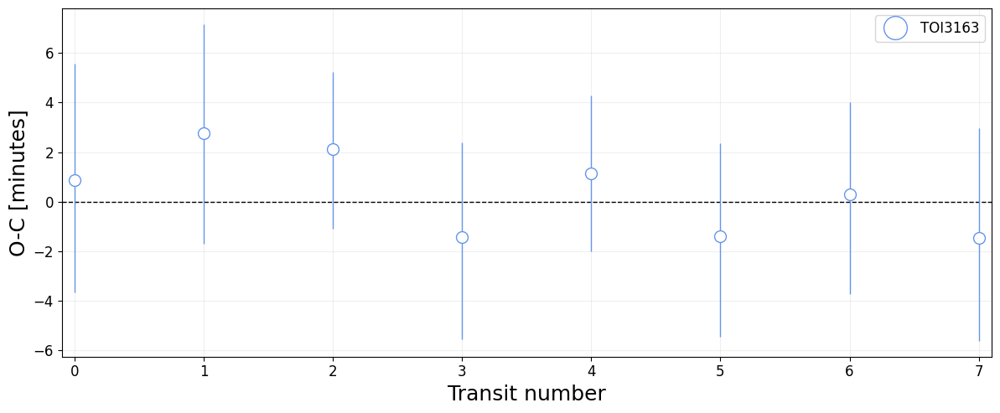

In [101]:
# To extract O-C data from the posterior distributions, first define some variables:
transit_numbers = np.array([0,1,2,3,4,5,6,7])
OC = np.zeros(len(transit_numbers))
OC_up_err = np.zeros(len(transit_numbers))
OC_down_err = np.zeros(len(transit_numbers))
instrument = 'TESS'
# Now go through known transit-numberings, and generate the O-C distributions. From there,
# compute the medians and 68% credibility bands:
for i in range(len(transit_numbers)):
    transit_number = transit_numbers[i]
    # Compute distribution of predicted times:
    computed_time = results.posteriors['posterior_samples']['t0_p1'] + transit_number*results.posteriors['posterior_samples']['P_p1']
    # Extract observed times:
    observed_time = results.posteriors['posterior_samples']['T_p1_'+instrument+'_'+str(transit_number)]
    # Generate O-C (multiply by 24*60 to get it in minutes) posterior distribution,
    # and get quantiles from it:
    val,vup,vdown = juliet.utils.get_quantiles((observed_time - computed_time)*24*60.)
    # Save value and "1-sigma" errors:
    OC[i], OC_up_err[i], OC_down_err[i] = val, vup-val,val-vdown

# Finally, generate plot with the O-C:
fig = plt.figure(figsize=(12,5))
plt.errorbar(transit_numbers,OC,yerr=[OC_down_err,OC_up_err],fmt='o',mfc='white',mec='cornflowerblue',ecolor='cornflowerblue',ms=10,elinewidth=1,zorder=3, label = 'TOI3163')
plt.plot([-0.1,7.1],[0.,0],'--',linewidth=1,color='black',zorder=2)
plt.xlim([-0.1,7.1])
plt.xlabel('Transit number', fontsize = 18)
plt.ylabel('O-C [minutes]', fontsize = 18)
plt.legend(prop={'size': 12}, markerscale = 2.0)
plt.tick_params(axis='both', which='major', labelsize = 12)
plt.grid(alpha=0.2)
plt.tight_layout()
plt.savefig('oc_3163.png',transparent=True)

## TOI3097

In [2]:
TOI3097_lc_sc = lk.search_lightcurve('TOI3097')
TOI3097_lc_sc

#,mission,year,author,exptime,target_name,distance
,,,,s,,arcsec
0,TESS Sector 63,2023,SPOC,120,163262555,0.0
1,TESS Sector 64,2023,SPOC,120,163262555,0.0
2,TESS Sector 63,2023,TESS-SPOC,200,163262555,0.0
3,TESS Sector 64,2023,TESS-SPOC,200,163262555,0.0
4,TESS Sector 10,2019,QLP,1800,163262555,0.0
5,TESS Sector 37,2021,QLP,600,163262555,0.0
6,TESS Sector 37,2021,QLP,600,939962363,0.0
7,TESS Sector 63,2023,QLP,200,163262555,0.0
8,TESS Sector 63,2023,QLP,200,939962363,0.0


In [3]:
TOI3097_lc_col = TOI3097_lc_sc[0:2].download_all()
TOI3097_lc = TOI3097_lc_col.stitch().normalize()
TOI3097_lc = TOI3097_lc[TOI3097_lc.quality == 0]

In [4]:
P_3097 = 1.368
t0_3097 = 3015.54
M_3097B = ufloat(0.27, 0.08)
M_3097A = ufloat(0.63, 0.13)
R_3097A = ufloat(0.87, 0.12)
rho_sol = ufloat(1408, 2)
R_3097B = ufloat(0.30, 0.02)
T_3097A = ufloat(4802,24)

rho_3097A = (M_3097A/(R_3097A**3))*rho_sol
rho_3097B = (M_3097B/(R_3097B**3))*rho_sol

print('A: ', rho_3097A)
print('B: ', rho_3097B)

A:  (1.3+/-0.6)e+03
B:  (1.4+/-0.5)e+04


In [5]:
# limb darkening

u1_r_3097 = ufloat(0.596, 0.001)
u2_r_3097 = ufloat(0.093,0.002)
u1_tess_3097 = ufloat(0.473,0.003)
u2_tess_3097 = ufloat(0.113,0.004)

def calc_qs(u1, u2):
    q1 = (u1 + u2)**2  
    q2 = u1/(2*(u1 + u2))
    return q1, q2

print(calc_qs(u1_r_3097, u2_r_3097))
print(calc_qs(u1_tess_3097, u2_tess_3097))

(0.47472099999999995+/-0.0030813016729947097, 0.432510885341074+/-0.0012592895954056725)
(0.343396+/-0.00586, 0.4035836177474403+/-0.002798708092941908)


<ErrorbarContainer object of 3 artists>

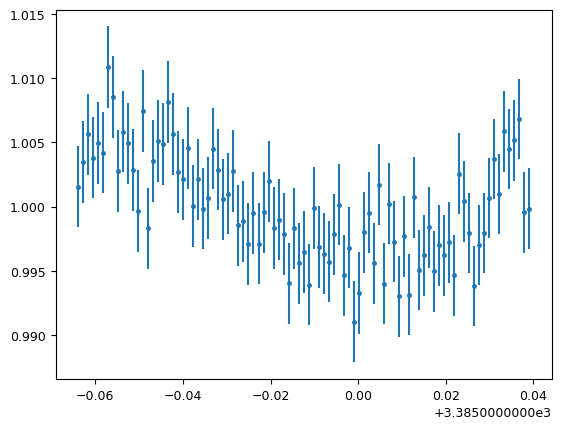

In [6]:
TOI3097_H50 = pd.read_csv('TOI3097/Phot_Outputs/DR2/diffLC.csv')
plt.errorbar(x=TOI3097_H50['BJD-TDB'] - 2457000.0, y=TOI3097_H50['DIFF_FLUX'], yerr=TOI3097_H50['ERROR'], fmt = '.')

In [7]:
t_3097, f_3097, ferr_3097 = TOI3097_lc['time'].value, TOI3097_lc['flux'].value.unmasked, TOI3097_lc['flux_err'].value.unmasked
t_h50_3097, f_h50_3097, ferr_h50_3097 = TOI3097_H50['BJD-TDB'] - 2457000.0, TOI3097_H50['DIFF_FLUX'], TOI3097_H50['ERROR']

In [17]:
# Course search to look at stellar density, looks like this is transiting the brighter star

# First define the priors:
priors = {}
times, fluxes, fluxes_error = {},{},{}

# Same priors as for the transit-only fit, but we now add the GP priors:
params = ['P_p1','t0_p1','r1_p1','r2_p1','q1_TESS','q2_TESS', 'ecc_p1','omega_p1',\
          'rho', 'mdilution_TESS', 'mflux_TESS', 'sigma_w_TESS',\
          'GP_sigma_TESS', 'GP_rho_TESS']

dists = ['normal','normal','uniform','uniform','uniform', 'uniform', 'fixed', 'fixed',\
         'loguniform', 'fixed', 'normal', 'loguniform',\
         'loguniform','loguniform']

hyperps = [[P_3097, 0.1], [t0_3097, 0.05], [0.,1], [0.,1.], [0., 1.], [0., 1.], 0.0, 90.0,\
           [100., 10000.], 1.0, [0.,0.1], [0.1, 1000.], \
           [1e-6, 1e6], [1e-3, 1e3]]

# Populate the priors dictionary:
for param, dist, hyperp in zip(params, dists, hyperps):
    priors[param] = {}
    priors[param]['distribution'], priors[param]['hyperparameters'] = dist, hyperp

times['TESS'], fluxes['TESS'], fluxes_error['TESS'] = t_3097, f_3097, ferr_3097

dataset = juliet.load(priors=priors, t_lc = times, y_lc = fluxes,\
                      yerr_lc = fluxes_error, GP_regressors_lc = times, out_folder = 'TOI3097/JulietFitting', verbose = True)

results = dataset.fit(sampler='dynesty', nthreads = 7, n_live_points=200)

	 Transit fit detected for instrument  TESS
	 >> ecc,omega parametrization detected for lc planet p1
	 >> (b,p) parametrization detected for lc planet p1
Detected dynesty sampler output files --- extracting from TOI3097/JulietFitting/_dynesty_NS_posteriors.pkl


In [8]:
# First define the priors:
priors = {}
times, fluxes, fluxes_error = {},{},{}

# Same priors as for the transit-only fit, but we now add the GP priors:
params = ['P_p1','t0_p1','r1_p1','r2_p1', 'ecc_p1', 'omega_p1', 'rho',\
          'q1_TESS','q2_TESS', 'q1_H50','q2_H50',\
          'mdilution_TESS', 'mflux_TESS', 'sigma_w_TESS',\
          'mdilution_H50','mflux_H50','sigma_w_H50',\
          'GP_sigma_TESS', 'GP_rho_TESS', 'GP_sigma_H50', 'GP_rho_H50']
          

dists = ['normal','normal','uniform','uniform','fixed', 'fixed', 'normal', \
         'normal', 'normal', 'normal', 'normal', \
         'fixed', 'normal', 'loguniform', \
         'normal', 'normal', 'loguniform', \
         'loguniform','loguniform', 'loguniform', 'loguniform']

hyperps = [[P_3097, 0.1], [t0_3097, 0.05], [0.,1], [0.,1.], 0., 90., [1347.1, 622.92], \
           [0.34, 0.03],[0.40, 0.04], [0.47, 0.05],[0.43, 0.04],\
           1.0, [0.,0.1], [0.1, 1000.], \
           [0.8, 0.01], [0.,0.1], [0.1, 1000.], \
           [1e-6, 1e6], [1e-3, 1e3],[1e-6, 1e6], [1e-3, 1e3]]

# Populate the priors dictionary:
for param, dist, hyperp in zip(params, dists, hyperps):
    priors[param] = {}
    priors[param]['distribution'], priors[param]['hyperparameters'] = dist, hyperp

times['TESS'], fluxes['TESS'], fluxes_error['TESS'] = t_3097,f_3097,ferr_3097
times['H50'], fluxes['H50'], fluxes_error['H50'] = t_h50_3097.to_numpy(), f_h50_3097.to_numpy(), ferr_h50_3097.to_numpy()

dataset = juliet.load(priors=priors, t_lc = times, y_lc = fluxes, \
yerr_lc = fluxes_error, GP_regressors_lc = times, out_folder = 'TOI3097/JulietFitting_Final', verbose = True)

results = dataset.fit(sampler='dynesty', nthreads = 7, n_live_points=1000)

results.posteriors['lnZ']

	 Transit fit detected for instrument  TESS
	 Transit fit detected for instrument  H50
	 >> ecc,omega parametrization detected for lc planet p1
	 >> (b,p) parametrization detected for lc planet p1
Detected dynesty sampler output files --- extracting from TOI3097/JulietFitting_Final/_dynesty_NS_posteriors.pkl


119936.16802057496

In [43]:
# First define the priors:
priors = {}
times, fluxes, fluxes_error = {},{},{}

# Same priors as for the transit-only fit, but we now add the GP priors:
params = ['P_p1','t0_p1','r1_p1','r2_p1', 'sesinomega_p1', 'secosomega_p1', 'rho',\
          'q1_TESS','q2_TESS', 'q1_H50','q2_H50',\
          'mdilution_TESS', 'mflux_TESS', 'sigma_w_TESS',\
          'mdilution_H50','mflux_H50','sigma_w_H50',\
          'GP_sigma_TESS', 'GP_rho_TESS', 'GP_sigma_H50', 'GP_rho_H50']
          

dists = ['normal','normal','uniform','uniform','uniform','uniform', 'normal', \
         'normal', 'normal', 'normal', 'normal', \
         'fixed', 'normal', 'loguniform', \
         'normal', 'normal', 'loguniform', \
         'loguniform','loguniform', 'loguniform', 'loguniform']

hyperps = [[P_3097, 0.1], [t0_3097, 0.05], [0.,1], [0.,1.], [-1.,1.], [-1.,1.], [1347.1, 622.92], \
           [0.34, 0.03],[0.40, 0.04], [0.47, 0.05],[0.43, 0.04],\
           1.0, [0.,0.1], [0.1, 1000.], \
           [0.8, 0.01], [0.,0.1], [0.1, 1000.], \
           [1e-6, 1e6], [1e-3, 1e3],[1e-6, 1e6], [1e-3, 1e3]]

# Populate the priors dictionary:
for param, dist, hyperp in zip(params, dists, hyperps):
    priors[param] = {}
    priors[param]['distribution'], priors[param]['hyperparameters'] = dist, hyperp

times['TESS'], fluxes['TESS'], fluxes_error['TESS'] = t_3097,f_3097,ferr_3097
times['H50'], fluxes['H50'], fluxes_error['H50'] = t_h50_3097.to_numpy(), f_h50_3097.to_numpy(), ferr_h50_3097.to_numpy()

dataset = juliet.load(priors=priors, t_lc = times, y_lc = fluxes, \
yerr_lc = fluxes_error, GP_regressors_lc = times, out_folder = 'TOI3097/JulietFitting_FinalwEcc', verbose = True)

results = dataset.fit(sampler='dynamic_dynesty', nthreads = 7, n_live_points=200)

results.posteriors['lnZ']

	 Transit fit detected for instrument  TESS
	 Transit fit detected for instrument  H50
	 >> sqrt(e)cosomega, sqrt(e)sinomega parametrization detected for lc planet p1
	 >> (b,p) parametrization detected for lc planet p1
Detected dynamic_dynesty sampler output files --- extracting from TOI3097/JulietFitting_FinalwEcc/_dynesty_DNS_posteriors.pkl


119933.89198580956

In [9]:
# Extract full model:
transit_plus_GP_model_TESS = results.lc.evaluate('TESS')

# Deterministic part of the model (in our case transit divided by mflux):
transit_model_TESS = results.lc.model['TESS']['deterministic']

# GP part of the model:
gp_model_TESS = results.lc.model['TESS']['GP']

# Extract full model:
transit_plus_GP_model_H50 = results.lc.evaluate('H50')

# Deterministic part of the model (in our case transit divided by mflux):
transit_model_H50 = results.lc.model['H50']['deterministic']

# GP part of the model:
gp_model_H50 = results.lc.model['H50']['GP']

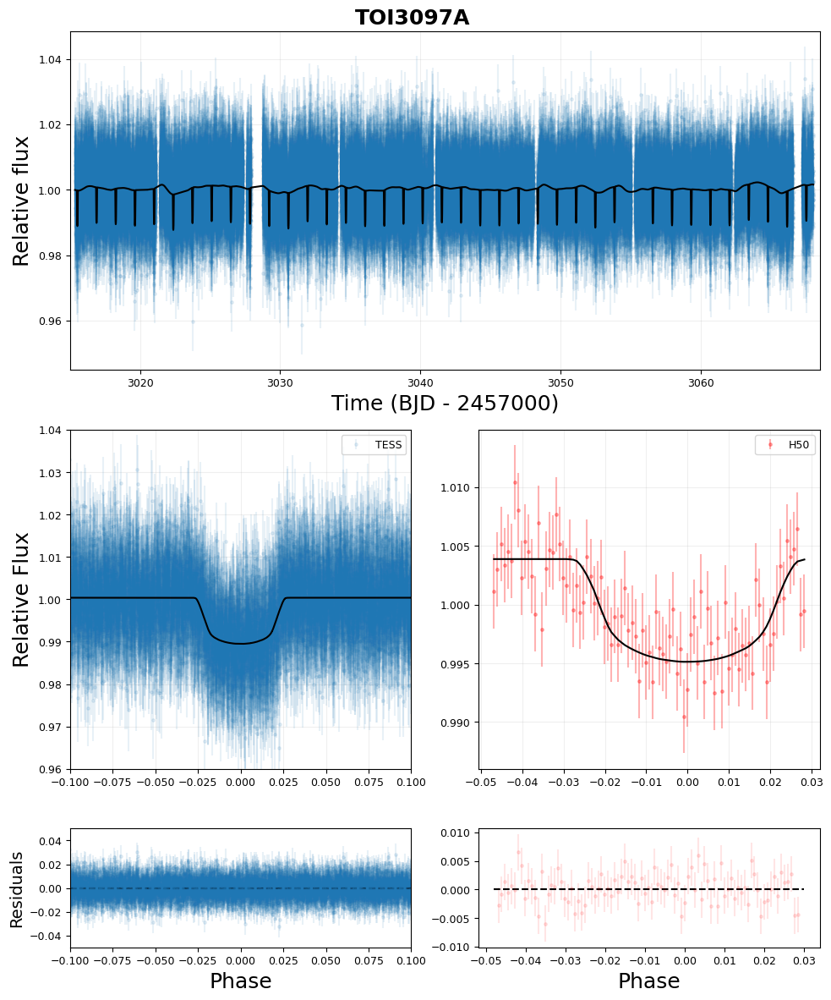

In [93]:
import matplotlib.gridspec as gridspec

# Now plot. First preambles:
fig = plt.figure(figsize=(10,12))
gs = gridspec.GridSpec(3,2, height_ratios=[1, 1, 0.35])
ax1 = plt.subplot(gs[0,:])
ax1.grid(alpha = 0.2)

# Plot data
ax1.errorbar(dataset.times_lc['TESS'], dataset.data_lc['TESS'], \
             yerr = dataset.errors_lc['TESS'], fmt = '.', alpha = 0.1)

# Plot the (full, transit + GP) model:
ax1.plot(dataset.times_lc['TESS'], transit_plus_GP_model_TESS, color='black',zorder=10)

ax1.set_xlim(3015, 3068.5)
#ax1.set_ylim([0.98,1.02])
ax1.set_xlabel('Time (BJD - 2457000)', fontsize = 18)
ax1.set_ylabel('Relative flux', fontsize = 18)

ax2 = plt.subplot(gs[1,0])

# Now plot phase-folded lightcurve but with the GP part removed:
phases_TESS = juliet.utils.get_phases(dataset.times_lc['TESS'], np.median(results.posteriors['posterior_samples']['P_p1']), np.median(results.posteriors['posterior_samples']['t0_p1']))
ax2.errorbar(phases_TESS, dataset.data_lc['TESS'] - gp_model_TESS, \
             yerr = dataset.errors_lc['TESS'], fmt = '.', alpha = 0.1, label = 'TESS')

# Plot transit-only (divided by mflux) model:
idx_TESS = np.argsort(phases_TESS)
ax2.plot(phases_TESS[idx_TESS],transit_model_TESS[idx_TESS], color='black',zorder=10)
ax2.set_xlim([-0.1,0.1])
ax2.set_ylim([0.96,1.04])
ax2.set_ylabel('Relative Flux', fontsize = 18)
ax2.grid(alpha = 0.2)
ax2.legend()

ax3 = plt.subplot(gs[1,1])

# Plot data

# Now plot phase-folded lightcurve but with the GP part removed:
phases_H50 = juliet.utils.get_phases(dataset.times_lc['H50'], np.median(results.posteriors['posterior_samples']['P_p1']), np.median(results.posteriors['posterior_samples']['t0_p1']))
ax3.errorbar(phases_H50, dataset.data_lc['H50'] - gp_model_H50, \
             yerr = dataset.errors_lc['H50'], color='r', fmt = '.', alpha = 0.3, label = 'H50')

# Plot transit-only (divided by mflux) model:
idx_H50 = np.argsort(phases_H50)
ax3.plot(phases_H50[idx_H50],transit_model_H50[idx_H50], color='black',zorder=10)
ax3.grid(alpha = 0.2)
ax3.legend()

ax4 = plt.subplot(gs[2,0])
ax4.errorbar(phases_TESS, dataset.data_lc['TESS'] - transit_model_TESS - gp_model_TESS, \
             yerr = dataset.errors_lc['TESS'], fmt = '.', alpha = 0.1, label = 'TESS')
ax4.set_xlim([-0.1,0.1])
ax4.set_xlabel('Phase', fontsize = 18)
ax4.set_ylabel('Residuals', fontsize = 14)
ax4.hlines(0, -0.1, 0.1, linestyle = 'dashed', color = 'black')
ax4.set_ylim(-0.05, 0.05)

ax5 = plt.subplot(gs[2,1])
ax5.errorbar(phases_H50, dataset.data_lc['H50'] - transit_model_H50 - gp_model_H50, \
             yerr = dataset.errors_lc['H50'], fmt = '.', alpha = 0.1, label = 'H50', color = 'r')
ax5.set_xlabel('Phase', fontsize = 18)
ax5.hlines(0, -0.048, 0.03, linestyle = 'dashed', color = 'black')
#ax5.set_ylim(-0.05, 0.05)

fig.suptitle('TOI3097A', fontsize = 18, fontweight = 'bold')

plt.tight_layout()

plt.savefig('TOI3097Ab_Model.png')

Text(0, 0.5, '$p = R_p/R_*$')

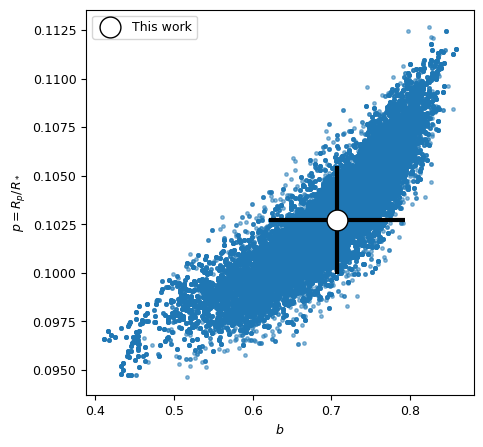

In [104]:
fig = plt.figure(figsize=(5,5))
# Store posterior samples for r1 and r2:
r1, r2 = results.posteriors['posterior_samples']['r1_p1'],\
         results.posteriors['posterior_samples']['r2_p1']

# Transform back to (b,p):
b,p = juliet.utils.reverse_bp(r1, r2, 0., 1.)

# Plot posterior distribution:
plt.plot(b,p,'.',alpha=0.5)

# Extract median and 1-sigma errors for b and p from
# the posterior distribution:
bm,bu,bl = juliet.utils.get_quantiles(b)
pm,pu,pl = juliet.utils.get_quantiles(p)

# Plot them:
plt.errorbar(x=np.array([bm]),y = np.array([pm]),\
             xerr = [bm-bl],\
             yerr = [pm-pl],\
             fmt = 'o', mfc = 'white', mec = 'black',\
             ecolor='black', ms = 15, elinewidth = 3, \
             zorder = 5, label = 'This work')


plt.legend()
#plt.xlim([0.,0.8])
#plt.ylim([0.1,0.125])
plt.xlabel('$b$')
plt.ylabel('$p = R_p/R_*$')

In [166]:
df = pd.DataFrame()

for key in results.posteriors['posterior_samples'].keys():
    if key == 'P_p1' or key == 't0_p1' or key == 'rho' or key == 'q1_TESS' or key == 'q2_TESS' or key == 'q1_H50' or key == 'q2_H50':
          df[key] = results.posteriors['posterior_samples'][key]
            
df['Rp/Rs'] = p
df['b'] = b

df['P - 1.368 [days]'] = df['P_p1'] - 1.368
df['T0 - 3015.53 [BTJD]'] = df['t0_p1'] - 3015.53

del df['P_p1']
del df['t0_p1']

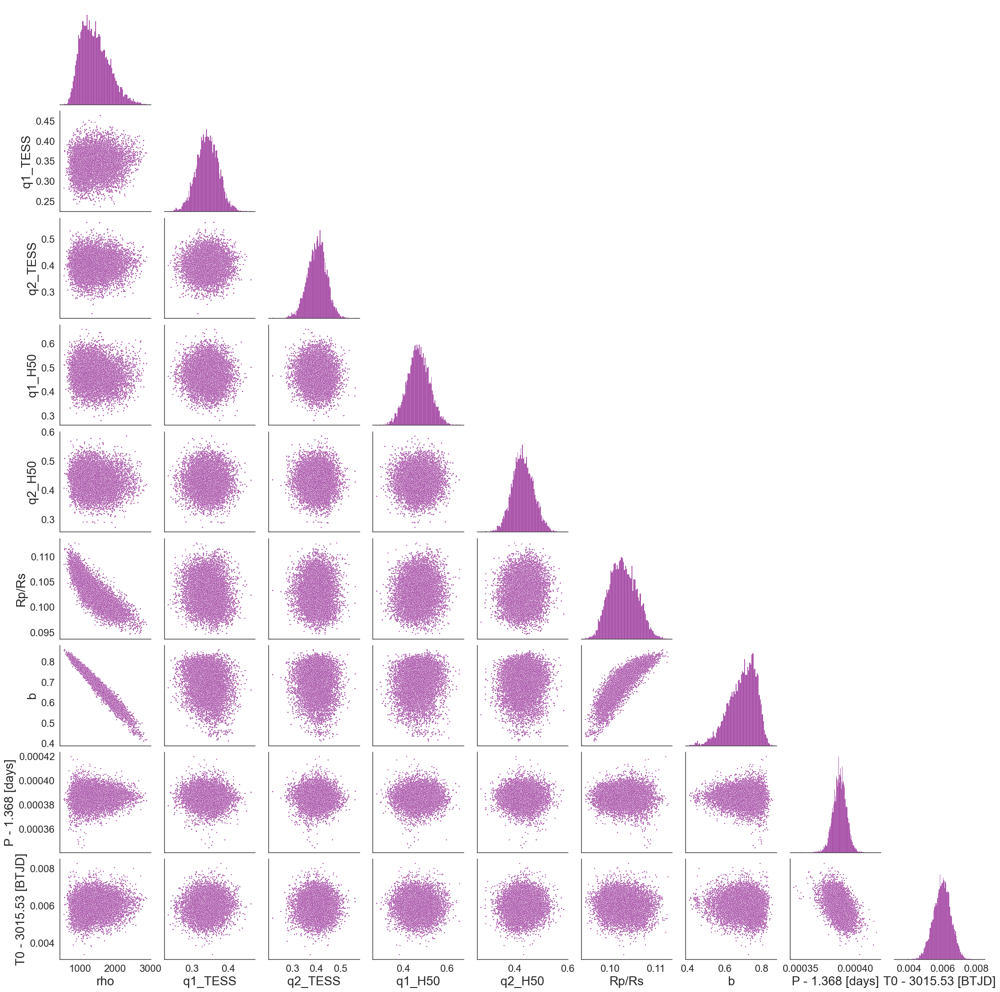

In [171]:
sns.set_theme(style='white')

sns.set_context('paper', rc={"axes.labelsize":20})

fig = sns.pairplot(df, corner = True, plot_kws=dict(marker='.',size=1, color = 'purple'), diag_kws=dict(color='purple'))

fig.tick_params(axis='both', labelsize = 16)
        
fig.tight_layout()

plt.savefig('TOI3097_Posteriors.png')

In [119]:
R_p = ufloat(0.103, 0.003)*R_3097A # in solar units
R_J = 0.10045 # in solar units
R_3097Ab = ufloat((R_p.n/R_J), R_p.s/R_J) #*R_J_E
a_r = ufloat(5.2, 0.5)
a_3097Ab = a_r*R_3097A*0.00465047
a_3097Ab = ufloat(a_3097Ab.n, a_3097Ab.s)
T_3097Ab = T_3097A*unp.sqrt(R_3097A/(a_r))
F_3097Ab = (((R_3097A**2)*((T_3097A/5778)**4))*(1/a_3097Ab**2))*(1361)

In [202]:
K_3097A = calc_K(1.368386, 0.208, M_3097A, 0, 82.1)
TSM_3097A = calc_TSM(1, 12.13, 10.00, 1960, 0.208*M_J_E, R_3097A)

print('RV K [m/s]: ', K_3097A)
print('TSM: ', TSM_3097A)

RV K [m/s]:  21.0+/-2.9
TSM:  (1.5+/-0.4)e+02


In [204]:
K_3163 = calc_K(3.074966, 0.569, M_3163, 0, 84.5)
TSM_3163 = calc_TSM(1, 11.28, 1.42*R_J_E, 3090, 0.569*M_J_E, R_3163)

print('RV K [m/s]: ', K_3163)
print('TSM: ', TSM_3163)

RV K [m/s]:  21.3+/-2.6
TSM:  (1.6+/-0.4)e+02


In [156]:
M_J_E = 317.8
R_J_E = 11.21
M_3097Ab = ((1/(2.45*((F_3097Ab*1000)**0.094)))*(R_3097Ab*R_J_E))**(-0.039)*M_J_E

In [157]:
print('Radius: ', R_3097Ab)

print('Mass Estimate from Weiss et al. 2013: ', M_3097Ab)

print('Semi-major axis: ', a_3097Ab)

print('Equilibrium Temp [K]. ', T_3097Ab)

print('Surface Flux [W/m^2]. ', F_3097Ab)

Radius:  0.89+/-0.13
Mass Estimate from Weiss et al. 2013:  324.7+/-1.9
Semi-major axis:  0.0210+/-0.0035
Equilibrium Temp [K].  (1.96+/-0.17)e+03
Surface Flux [W/m^2].  (1.1+/-0.5)e+06


In [145]:
R_3097Ab*R_J_E

10.000279741164759+/-1.4097665935765014

In [55]:
t_vec_3097 = 3015.536 + np.arange(0, 29, 1)*1.36839
t_vec_add = 3015.536 + np.arange(30, 39, 1)*1.36839
t_vec_3097 = np.append(t_vec_3097, t_vec_add)

time_priors = []

for t in t_vec_3097:
    time_priors += [[t, 0.1]]

In [56]:
ttv_params = []

for i in range(0, 29):
    ttv_params += ['T_p1_TESS_{:}'.format(i)]
    
for i in range(30, 39):
    ttv_params += ['T_p1_TESS_{:}'.format(i)]
    

In [102]:
# Look for TTVs
priors = {}
times, fluxes, fluxes_error = {},{},{}

# Same priors as for the transit-only fit, but we now add the GP priors:
params = ['r1_p1','r2_p1','q1_TESS','q2_TESS', 'ecc_p1','omega_p1',\
          'rho', 'mdilution_TESS', 'mflux_TESS', 'sigma_w_TESS',\
          'GP_sigma_TESS', 'GP_rho_TESS']

dists = ['normal','normal','normal','normal','fixed', 'fixed',\
         'normal', 'fixed', 'normal', 'loguniform',\
         'normal','normal']

hyperps = [[0.805, 0.057], [0.103, 0.003], [0.34, 0.03], [0.40, 0.04], 0.0, 90.0,\
           [1376.5, 459.8], 1.0, [0.,0.1], [0.1, 1000.], \
           [0.0008, 0.00009], [0.509, 0.132]]

params = params + ttv_params
dists = dists + ['normal']*len(time_priors)
hyperps = hyperps + time_priors

# Populate the priors dictionary:
for param, dist, hyperp in zip(params, dists, hyperps):
    priors[param] = {}
    priors[param]['distribution'], priors[param]['hyperparameters'] = dist, hyperp
    
    
times['TESS'], fluxes['TESS'], fluxes_error['TESS'] = t_3097, f_3097, ferr_3097

dataset = juliet.load(priors=priors, t_lc = times, y_lc = fluxes,\
                      yerr_lc = fluxes_error, GP_regressors_lc = times, out_folder = 'TOI3097/TTVFitting', verbose = True)

results = dataset.fit(sampler='dynesty', nthreads = 7, n_live_points=200)

results.posteriors['lnZ']

	 Transit fit detected for instrument  TESS
	 >> ecc,omega parametrization detected for lc planet p1
	 >> (b,p) parametrization detected for lc planet p1
Detected dynesty sampler output files --- extracting from TOI3097/TTVFitting/_dynesty_NS_posteriors.pkl


119479.6815910359

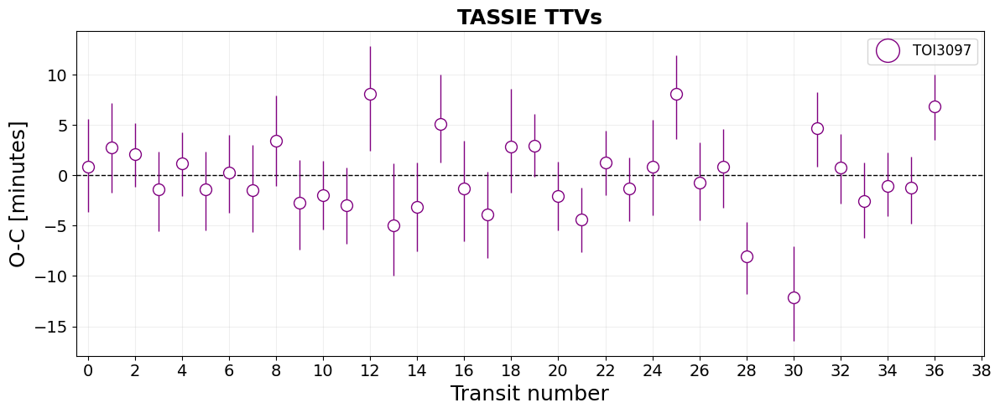

In [99]:
# To extract O-C data from the posterior distributions, first define some variables:
transit_numbers = np.array([0,1,2,3,4,5,6,7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36])
OC = np.zeros(len(transit_numbers))
OC_up_err = np.zeros(len(transit_numbers))
OC_down_err = np.zeros(len(transit_numbers))
instrument = 'TESS'
# Now go through known transit-numberings, and generate the O-C distributions. From there,
# compute the medians and 68% credibility bands:
for i in range(len(transit_numbers)):
    transit_number = transit_numbers[i]
    # Compute distribution of predicted times:
    computed_time = results.posteriors['posterior_samples']['t0_p1'] + transit_number*results.posteriors['posterior_samples']['P_p1']
    # Extract observed times:
    observed_time = results.posteriors['posterior_samples']['T_p1_'+instrument+'_'+str(transit_number)]
    # Generate O-C (multiply by 24*60 to get it in minutes) posterior distribution,
    # and get quantiles from it:
    val,vup,vdown = juliet.utils.get_quantiles((observed_time - computed_time)*24*60.)
    # Save value and "1-sigma" errors:
    OC[i], OC_up_err[i], OC_down_err[i] = val, vup-val,val-vdown

# Finally, generate plot with the O-C:
fig = plt.figure(figsize=(12,5))
plt.errorbar(transit_numbers,OC,yerr=[OC_down_err,OC_up_err],fmt='o',mfc='white',mec='purple',ecolor='purple',ms=10,elinewidth=1,zorder=3, label = 'TOI3097')
plt.plot([-0.5,38.1],[0.,0],'--',linewidth=1,color='black',zorder=2)
plt.xlim([-0.5,38.1])
plt.xlabel('Transit number', fontsize = 18)
plt.ylabel('O-C [minutes]', fontsize = 18)
plt.title('TASSIE TTVs', fontweight = 'bold', fontsize = 18)
plt.legend(prop={'size': 12}, markerscale = 2.0)
plt.grid(alpha=0.2)
plt.xticks(np.arange(0, 39, 2))
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.tight_layout()
plt.savefig('oc_3097A.png',transparent=True)

# Parameter Plots

In [64]:
from matplotlib.colors import LogNorm

In [65]:
exo_df = pd.read_csv('../Exoplanets/GHOTransitFinder/ExoplanetArchive.csv', index_col=0)

In [66]:
exo_sub = exo_df[exo_df['discoverymethod'] == 'Transit']
exo_sub = exo_sub[exo_sub['pl_orbper'] <= 10.0]

In [67]:
tassie_rad = np.array([0.89, 1.42])
tassie_rade = np.array([0.13, 0.18])
tassie_per = np.array([1.368386, 3.074966])
tassie_pere = np.array([0.000006, 0.000022])
tassie_labels = ['TOI3097A', 'TOI3163']
tassie_T = np.array([4802, 6501])

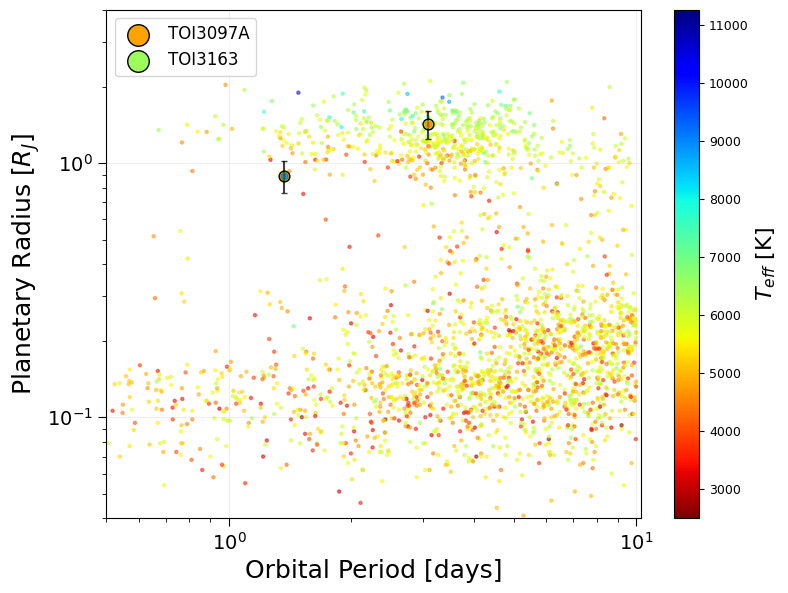

In [71]:
plt.figure(figsize=(8,6))
norm = plt.Normalize(2500, 11250)
plt.scatter(exo_sub['pl_orbper'], exo_sub['pl_radj'], s=5, c=exo_sub['st_teff'], cmap='jet_r', alpha = 0.5, norm = norm)
plt.xscale('log')
plt.yscale('log')
plt.grid(alpha = 0.2)
plt.xlabel('Orbital Period [days]', fontsize = 18)
plt.ylabel('Planetary Radius [$R_{J}$]', fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize=14, size = 6)
plt.tick_params(axis='both', which='minor', labelsize=12, size = 3)

for i in range(0, 2):
    plt.errorbar(x=tassie_per[i], y=tassie_rad[i], xerr = tassie_pere[i], yerr = tassie_rade[i],\
                 linestyle='', capsize = 2, ecolor ='k', alpha=0.75, fmt='o')
    plt.scatter(x=tassie_per[i], y=tassie_rad[i], c = tassie_T[i], label = tassie_labels[i], s = 60,  cmap='jet_r', edgecolors='black', norm = norm)
        
plt.colorbar().set_label(label = '$T_{eff}$ [K]', size = 16)
plt.xlim(0.5, 10.25)
plt.ylim(0.04, 4)
plt.legend(loc='upper left', prop={'size': 12}, markerscale = 2.0)
plt.tight_layout()
plt.savefig('RvsP_ShortPeriod')